## ECG-MRI Prediction

After implementing the ECG_MRI_Reconstruction.ipynb notebook, where we had the following model with 2 inputs (ECG signals and MRI images) and 2 outputs (Reconstructed ECG signals and Remember Reconstructed MRI signals), we will try in this notebook to implement the model that we see at the second image.

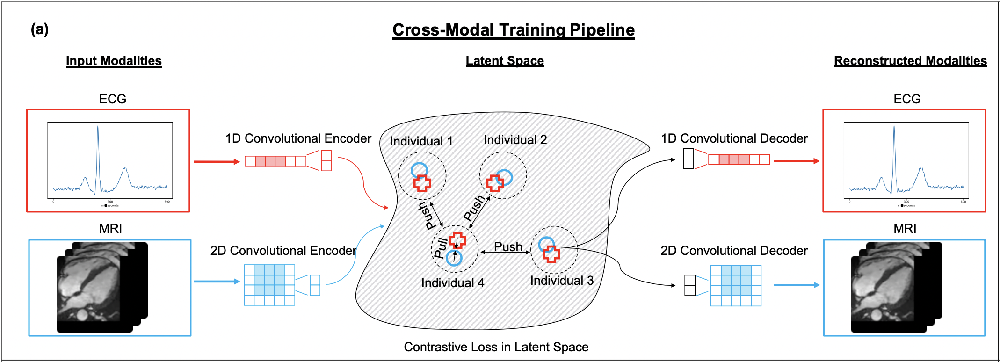

We observe that this new model has 1 input (ECG signal) and 1 output (The Reconstructed MRI image). To be more specific, what we are trying to do is for one subject, for which we have the ECG signal, we want to reconstruct for that signal the corresponding MRI Image. Therefore, we desire to predict the MRI Image that will correspond to the ECG signal, that we have in our dataset.

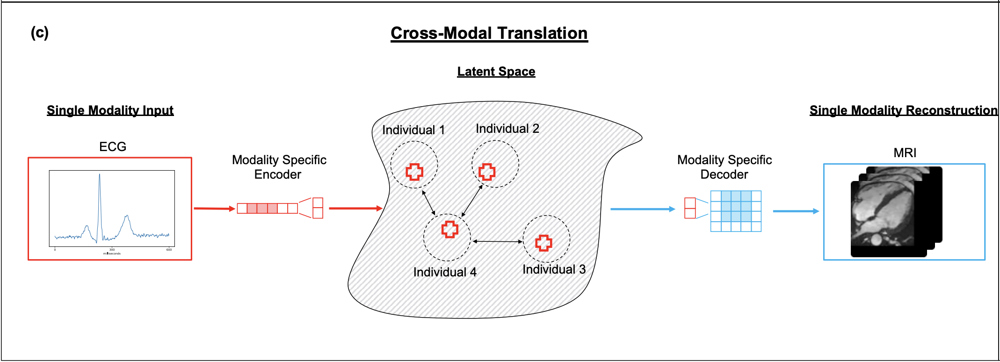

## III) Multi-Modality Autoencoder

### Importing Modules

In [1]:
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import nibabel as nib
import re
import numpy as np
import xml.dom.minidom as minidom
import cv2
import torch.nn.functional as F
from skimage.transform import resize
from torchvision import datasets
from torchvision import transforms

In [2]:
import os
import tempfile
import shutil
import gc
import platform
import monai

from monai.data import ImageDataset
from monai.transforms import Compose, EnsureChannelFirst, RandAdjustContrast, Spacing
from monai.config import print_config

print_config()

MONAI version: 0.8.1
Numpy version: 1.19.5
Pytorch version: 1.10.0+cu111
MONAI flags: HAS_EXT = False, USE_COMPILED = False
MONAI rev id: 71ff399a3ea07aef667b23653620a290364095b1

Optional dependencies:
Pytorch Ignite version: NOT INSTALLED or UNKNOWN VERSION.
Nibabel version: 3.2.2
scikit-image version: 0.17.2
Pillow version: 8.4.0
Tensorboard version: 2.6.0
gdown version: NOT INSTALLED or UNKNOWN VERSION.
TorchVision version: 0.11.1+cu111
tqdm version: NOT INSTALLED or UNKNOWN VERSION.
lmdb version: NOT INSTALLED or UNKNOWN VERSION.
psutil version: NOT INSTALLED or UNKNOWN VERSION.
pandas version: 1.1.5
einops version: NOT INSTALLED or UNKNOWN VERSION.
transformers version: NOT INSTALLED or UNKNOWN VERSION.
mlflow version: NOT INSTALLED or UNKNOWN VERSION.

For details about installing the optional dependencies, please visit:
    https://docs.monai.io/en/latest/installation.html#installing-the-recommended-dependencies



In [3]:
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision.transforms import Normalize
from torch.utils.data import random_split

# Import utils.py
from utils.utils import loadECG
from utils.utils import median_filter
from utils.utils import common_Ids

### CPU OR GPU Selection

In [4]:
device = "cpu"

In [5]:
device

'cpu'

- Find out what <b>CPU</b> we are using:

In [6]:
platform.processor()

'x86_64'

- This command will return a boolean (True/False) letting you know if a <b>GPU</b> is available.

In [7]:
use_cuda = torch.cuda.is_available()

In [8]:
use_cuda

True

In [9]:
if use_cuda:
    print('__CUDNN VERSION:', torch.backends.cudnn.version())
    print('__Number CUDA Devices:', torch.cuda.device_count())
    print('__CUDA Device Name:',torch.cuda.get_device_name(0))
    print('__CUDA Device Total Memory [GB]:',torch.cuda.get_device_properties(0).total_memory/1e9)

__CUDNN VERSION: 8005
__Number CUDA Devices: 1
__CUDA Device Name: NVIDIA GeForce RTX 3090
__CUDA Device Total Memory [GB]: 25.43812608


### Selecting a GPU to use

In [10]:
device = torch.device("cuda" if use_cuda else "cpu")
print("Device: ",device)

Device:  cuda


- Code if we want to use <b>specific GPU</b>:

In [11]:
device = torch.device("cuda:0" if use_cuda else "cpu")
print("Device: ",device)

Device:  cuda:0


## 1. Load ECG Data

To begin with, we create a <b>function</b> in order to load the ECG signals. The input of the functions is the XML files.

In [6]:
# Here we determine the number of files that we will acquire from the Database. 
# Be careful, this is not the final number of the input data!
number_of_files = 4100

In [7]:
ecg_xml_path_test = "/UKBB/ecg/"
regex_ecg = re.compile(r'2_0')
ecgs = []

i = 0
break_outer_loop = False

# The hole  path
ecg_names = []

for root, dirs, files in os.walk(ecg_xml_path_test):
    for file in files:
        if regex_ecg.search(file):
            i = i + 1
            print('Found a new ECG xml signal in the path: ', os.path.join(root, file))

            ecg_names.append(os.path.join(root, file))


            if (i == number_of_files):
                break_outer_loop = True
                break
                
            if break_outer_loop:
                break
        if break_outer_loop:
            break
    if break_outer_loop:
        break

Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2132639/2132639_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2103918/2103918_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2116943/2116943_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2146835/2146835_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2128146/2128146_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2114378/2114378_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2174638/2174638_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2192264/2192264_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2147866/2147866_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2102184/2102184_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2127618/2127618_20205_2_0.xml
Found a new ECG xml s

Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2172601/2172601_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2177457/2177457_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2116250/2116250_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2187106/2187106_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2148564/2148564_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2180980/2180980_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2132023/2132023_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2154687/2154687_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2193985/2193985_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2182313/2182313_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/21xxxxx/2101629/2101629_20205_2_0.xml
Found a new ECG xml s

Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3014723/3014723_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3055077/3055077_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3090772/3090772_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3045950/3045950_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3000787/3000787_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3040044/3040044_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3085410/3085410_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3017100/3017100_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3086019/3086019_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3022775/3022775_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3019844/3019844_20205_2_0.xml
Found a new ECG xml s

Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3088002/3088002_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3071695/3071695_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3079519/3079519_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3054941/3054941_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3007384/3007384_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3097136/3097136_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3027197/3027197_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3043185/3043185_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3076687/3076687_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3097752/3097752_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/30xxxxx/3063923/3063923_20205_2_0.xml
Found a new ECG xml s

Found a new ECG xml signal in the path:  /UKBB/ecg/28xxxxx/2828005/2828005_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/28xxxxx/2862726/2862726_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/28xxxxx/2819027/2819027_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/28xxxxx/2883636/2883636_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/28xxxxx/2814160/2814160_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/28xxxxx/2895242/2895242_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/28xxxxx/2893178/2893178_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/28xxxxx/2899298/2899298_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/28xxxxx/2848105/2848105_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/28xxxxx/2808808/2808808_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/28xxxxx/2859700/2859700_20205_2_0.xml
Found a new ECG xml s

Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1649846/1649846_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1671733/1671733_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1641314/1641314_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1667557/1667557_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1621340/1621340_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1604666/1604666_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1685782/1685782_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1606125/1606125_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1633154/1633154_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1665060/1665060_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1692984/1692984_20205_2_0.xml
Found a new ECG xml s

Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1641915/1641915_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1633592/1633592_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1684721/1684721_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1673599/1673599_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1677616/1677616_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1671462/1671462_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1637648/1637648_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1675075/1675075_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1615252/1615252_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1644704/1644704_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/16xxxxx/1693925/1693925_20205_2_0.xml
Found a new ECG xml s

Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2378336/2378336_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2397510/2397510_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2356618/2356618_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2329323/2329323_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2397196/2397196_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2384652/2384652_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2358316/2358316_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2344196/2344196_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2398926/2398926_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2364978/2364978_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2365024/2365024_20205_2_0.xml
Found a new ECG xml s

Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2352282/2352282_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2336814/2336814_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2311124/2311124_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2367747/2367747_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2343723/2343723_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2302846/2302846_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2359227/2359227_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2385033/2385033_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2358528/2358528_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2389186/2389186_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/23xxxxx/2355561/2355561_20205_2_0.xml
Found a new ECG xml s

In [8]:
len(ecg_names)

4100

### Load MRI Images

In [9]:
img_path_test = "/UKBB/NIFTI/"
regex_mri = re.compile(r'la_4ch.nii.gz')
mris = []

# List of File Names
mri_names = []

i = 0
break_outer_loop = False

for root, dirs, files in os.walk(img_path_test):
    for file in files:
        if regex_mri.search(file):
            i = i + 1
            print('Found a new MRI Image in the path: ', os.path.join(root, file))
            
            mri_names.append(os.path.join(root, file))

            
            if (i == number_of_files):
                break_outer_loop = True
                break
            if break_outer_loop:
                break
        if break_outer_loop:
            break
    if break_outer_loop:
        break


Found a new MRI Image in the path:  /UKBB/NIFTI/23/2310058/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2310064/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2310145/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2326679/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2345087/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2334757/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2364283/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2330133/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2386642/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2318564/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2343524/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2364133/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2331609/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/

Found a new MRI Image in the path:  /UKBB/NIFTI/23/2300259/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2308655/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2373274/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2348721/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2343189/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2348808/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2321438/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2337101/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2329911/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2384005/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2367162/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2323100/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/2342452/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/23/

Found a new MRI Image in the path:  /UKBB/NIFTI/13/1324665/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1361616/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1377422/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1330180/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1391595/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1399538/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1334649/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1388057/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1300253/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1308075/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1322728/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1322043/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1343435/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/

Found a new MRI Image in the path:  /UKBB/NIFTI/13/1311273/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1350259/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1355585/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1327689/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1345287/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1322259/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1310971/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1336737/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1363474/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1375206/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1360772/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1365603/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1370596/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/

Found a new MRI Image in the path:  /UKBB/NIFTI/24/2495101/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2473451/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2423951/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2413893/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2448968/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2414455/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2405229/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2467669/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2476824/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2406680/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2402918/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2412988/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2454266/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/

Found a new MRI Image in the path:  /UKBB/NIFTI/24/2495762/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2461114/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2475651/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2461972/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2423963/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2453314/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2416119/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2443337/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2409092/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2432904/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2479790/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2409523/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/2493551/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/24/

Found a new MRI Image in the path:  /UKBB/NIFTI/11/1179937/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1145668/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1183024/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1185956/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1106979/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1170069/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1153409/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1103141/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1118116/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1134918/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1147392/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1175060/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1188810/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/

Found a new MRI Image in the path:  /UKBB/NIFTI/11/1141131/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1123905/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1153467/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1122919/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1174589/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1113330/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1125370/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1192546/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1177373/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1104076/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1146960/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1161247/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1156674/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/

In [10]:
len(mri_names)

4100

In [11]:
ecgs = []

for ecg_name in ecg_names:
    ecgs.append(re.search(r"\d{5,}", ecg_name).group())

In [12]:
mris = []

for mri_name in mri_names:
    mris.append(re.search(r"\d{5,}", mri_name).group())

In [13]:
common_values = list(set(ecgs) & set(mris))

The length of common_values list will eventually be the number of ECG and MRI data that we will have available for training/validation.

In [14]:
len(common_values)

898

In [15]:
common_ecg_names = common_Ids(ecg_names, common_values)
common_mri_names = common_Ids(mri_names, common_values)

## 2. Data Preprocessing

In [16]:
class Dataset(Dataset):
    def __init__(self, ecg_data, mri_data):
        self.ecg_data = ecg_data
        self.mri_data = mri_data
        self.transform = Normalize(0, 1)

    def __len__(self):
        return len(self.ecg_data)

    def __getitem__(self, idx):
        ecg_file = self.ecg_data[idx]
        mri_file = self.mri_data[idx]

        # LoadECG xml files
        ecg = loadECG(ecg_file)
        
        ##############    ECG Preprocessing    ###################

        # Select the first 600 samples from the full 5000 ECG
        ecg = ecg[0:600]

        # Normalization
        ecg = (ecg - ecg.min()) / (ecg.max() - ecg.min() + 1e-4)
        
        # Denoise ECG signal
        ecg = median_filter(ecg, 7)

        ecg = np.array([np.float32(x) for x in ecg])
        
        ecg_tensor = torch.tensor(ecg, dtype=torch.float32)
        
        # Load MRI data
        mri_img = nib.load(mri_file).get_fdata()
        
        ##################################################
        ##############    Temporary    ###################
        # We will return only 1 slice from the MRI Images to reduce the computational time
        mri_img = mri_img[...,0]  # select a single slice
        mri_img = resize(mri_img, (128, 128), anti_aliasing=True)  # resize
        ##################################################
        
        mri_tensor = torch.tensor(mri_img, dtype=torch.float32)
        mri_tensor = mri_tensor.permute(2, 0, 1)  # swap the dimensions to (channels, height, width)
        mri_tensor = self.transform(mri_tensor)  # apply normalization transform
        
        return ecg_tensor, mri_tensor

In [17]:
#common_ecg_names = common_ecg_names[:100]
#common_mri_names = common_mri_names[:100]

eval_dataset = Dataset(common_ecg_names, common_mri_names)

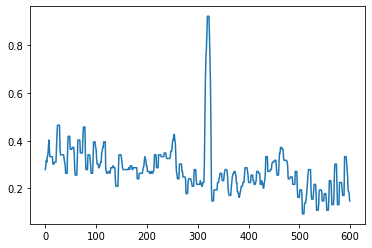

In [18]:
plt.plot(eval_dataset[0][0])

### Plotting the ECG signals and MRI Images of the Dataset

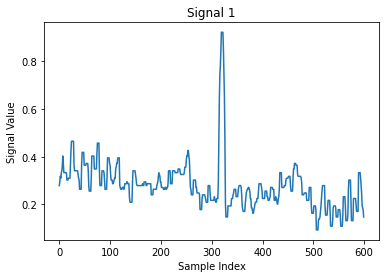

In [19]:
# Iterate over the dataset and plot the signals
for i in range(len(eval_dataset)):
    ecg_signal = eval_dataset[i][0]
    
    # Convert the tensor to a numpy array
    ecg_signal = ecg_signal.numpy()

    plt.plot(ecg_signal)
    plt.xlabel('Sample Index')
    plt.ylabel('Signal Value')
    plt.title(f'Signal {i+1}')
    plt.show()
    
    break

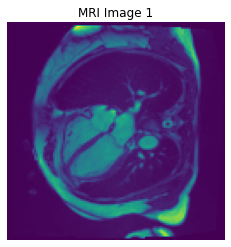

In [20]:
# Iterate over the dataset and plot the signals
for i in range(len(eval_dataset)):
    mri_img = eval_dataset[i][1]

    # Plot the MRI image
    mri_img = mri_img.reshape(128, 128)
    plt.imshow(mri_img.cpu().detach().numpy())
    plt.title(f'MRI Image {i+1}')
    plt.axis('off')
    plt.show()
    
    break

## Evaluation Loader

In [21]:
######################################################################################################################
############################        BATCH SIZE DECLARATION        ####################################################
######################################################################################################################

# Create data loaders for the evaluation set
eval_loader = DataLoader(eval_dataset, batch_size=64, shuffle=False)

In [22]:
len(eval_loader.dataset)

898

## Models Architecture

For this model we are going to combine the encoder that we implemented for the ECG Autoencoder and the decoder that we implemented for the MRI Autoencoder. As a result of that, the output of the new Autoencoder will be a MRI Image.

In [23]:
torch.cuda.empty_cache()

### I) Load pretrained Fully Connected (Dense) Autoencoder for ECG's

In [24]:
class EcgAutoencoder(nn.Module):
    def __init__(self):
        super(EcgAutoencoder, self).__init__()
        
        self.encoder = nn.Sequential(
            nn.Linear(600, 512),# nn.Linear(600, 256),
            nn.ReLU(),
            nn.Linear(512, 400),# nn.Linear(256, 128),
            nn.ReLU(),
            nn.Linear(400, 300),# nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(300, 256),# nn.Linear(64, 32),
            nn.ReLU()
        )
        
        self.decoder = nn.Sequential(
            nn.Linear(256, 300),# nn.Linear(32, 64),
            nn.ReLU(),
            nn.Linear(300, 400),# nn.Linear(64, 128),
            nn.ReLU(),
            nn.Linear(400, 512),# nn.Linear(128, 256),
            nn.ReLU(),
            nn.Linear(512, 600),# nn.Linear(256, 600),
            nn.Sigmoid()
        )

    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

In [25]:
#########################################################################
###############      Load pretrained ECG autoencoder      ###############
#########################################################################

# Instantiate first
ecg_autoencoder = EcgAutoencoder()
# Load the weights of the pre-trained model
ecg_autoencoder.load_state_dict(torch.load('models/ecg_model_weights.pth'))
ecg_autoencoder.eval()

EcgAutoencoder(
  (encoder): Sequential(
    (0): Linear(in_features=600, out_features=512, bias=True)
    (1): ReLU()
    (2): Linear(in_features=512, out_features=400, bias=True)
    (3): ReLU()
    (4): Linear(in_features=400, out_features=300, bias=True)
    (5): ReLU()
    (6): Linear(in_features=300, out_features=256, bias=True)
    (7): ReLU()
  )
  (decoder): Sequential(
    (0): Linear(in_features=256, out_features=300, bias=True)
    (1): ReLU()
    (2): Linear(in_features=300, out_features=400, bias=True)
    (3): ReLU()
    (4): Linear(in_features=400, out_features=512, bias=True)
    (5): ReLU()
    (6): Linear(in_features=512, out_features=600, bias=True)
    (7): Sigmoid()
  )
)

### II) Load pretrained 2D Convolutional Autoencoder for MRI's

In [26]:
class DoubleConv(nn.Module):
    '''
    |------|    |------|    |------|    |------|    |------|    |------|
    | Conv | => | [BN] | => | ReLU | => | Conv | => | [BN] | => | ReLU |
    |------|    |------|    |------|    |------|    |------|    |------|
    '''
    def __init__(self, in_channels, out_channels, mid_channels=None):
        super().__init__()
        if not mid_channels:
            mid_channels = out_channels
        self.double_conv = nn.Sequential(
            # One
            nn.Conv2d(in_channels, mid_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(mid_channels),
            nn.ReLU(inplace=True),
            # Two
            nn.Conv2d(mid_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)
    
class Down(nn.Module):
    """Downscaling with maxpool then double conv"""

    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            # Use the previous block
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)
    
class Up(nn.Module):
    """Upscaling then double conv"""

    def __init__(self, in_channels, out_channels, bilinear=True):
        super().__init__()

        # if bilinear, use the normal convolutions to reduce the number of channels
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
            self.conv = DoubleConv(in_channels, out_channels, in_channels // 2)
        else:
            self.up = nn.ConvTranspose2d(in_channels, in_channels // 2, kernel_size=2, stride=2)
            self.conv = DoubleConv(in_channels, out_channels)

    def forward(self, x1):
        x1 = self.up(x1)
        return self.conv(x1)
    
    
class OutConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(OutConv, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)

In [27]:
class Encoder(nn.Module):
    def __init__(self, n_channels, bilinear=True):
        super(Encoder, self).__init__()
        self.n_channels = n_channels
        self.bilinear = bilinear

        self.inc = DoubleConv(n_channels, 64) #DoubleConv(Input channel, output channel)
        
        self.down1 = Down(64, 128) # Down(Input channel, output channel)
        self.down2 = Down(128, 256)
        self.down3 = Down(256, 256)  # reduce spatial resolution and channels
        
        self.max = nn.MaxPool2d(kernel_size=16)
        self.avg = nn.AvgPool2d(kernel_size=16)
        self.dropout = nn.Dropout2d(p=0.2)
        
        self.down4 = Down(256, 256)  
        self.down5 = Down(256, 256)  
        self.down6 = Down(256, 256)  
        self.down7 = Down(256, 256)

    def forward(self, x):
        
        ## DownSampling in order from 128x128 --> 64x64 --> 32x32 --> 16x16 --> 1x1
        
        x1 = self.inc(x)# x1: 64 channels and 128x128
        x2 = self.down1(x1)# x2: 128 channels and 64x64
        x3 = self.down2(x2)# x3: 256 channels and 32x32
        x4 = self.down3(x3)# x4: 256 channels and 16x16
        
        # Using MaxPooling to reduce the spatial dimensions from 16x16 to 1x1 by keeping the Max Value
        x5 = self.max(x4)
        
        return x5

        

class Decoder(nn.Module):
    def __init__(self, n_channels, n_classes, bilinear=True):
        super(Decoder, self).__init__()
        self.n_channels = n_channels
        self.n_classes = n_classes
        self.bilinear = bilinear
        

        ## UpSampling in order from 1x1 --> 2x2 --> 4x4 --> 8x8 --> 16x16 --> 32x32 --> 64x64 --> 128x128
        
        ## Up(input channel, output channel)
        self.up1 = Up(256, 256)
        self.up2 = Up(256, 256)
        self.up3 = Up(256, 256)
        self.up4 = Up(256, 256)
        self.up5 = Up(256, 256)
        
        self.up6 = Up(256, 128)
        self.up7 = Up(128, 64)
        
        self.outc = OutConv(64, n_classes)

    def forward(self, x):
        
        x = self.up1(x) # 1x1
        x = self.up2(x) # 2x2
        x = self.up3(x) # 4x4
        x = self.up4(x) # 8x8
        x = self.up5(x) # 16x16
        x = self.up6(x) # 32x32
        x = self.up7(x) # 64x64
        logits = self.outc(x) # 128x128

        return logits


    
class UNet(nn.Module):
    def __init__(self, n_channels, n_classes, bilinear=True):
        super(UNet, self).__init__()
        self.encoder = Encoder(n_channels, bilinear)
        self.decoder = Decoder(64, n_classes, bilinear)

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)

        return x

In [28]:
class MriAutoencoder(torch.nn.Module):
    def __init__(self):
        super().__init__()
        
        ##############    2D Convolutional Autoencoder for the MRI's.   ##############
        # Building a UNet-based Convolutional encoder-decoder for MRI input
        self.mri_encoder = Encoder(1, bilinear=True)
        self.mri_decoder = Decoder(512 // 2, 1, bilinear=True)


    def forward(self, mri_image):
        #print("MRI encoder input: ", mri_image.shape)
        mri_encoded = self.mri_encoder(mri_image)
        
        #print("MRI encoder output: ", mri_encoded.shape)
        decoded_mri = self.mri_decoder(mri_encoded)

        return decoded_mri

In [29]:
#########################################################################
###############      Load pretrained MRI autoencoder      ###############
#########################################################################

# Instantiate first
mri_autoencoder = MriAutoencoder()
# Load the weights of the pre-trained model
mri_autoencoder.load_state_dict(torch.load('models/mri_model_weights.pth'))
mri_autoencoder.eval()

MriAutoencoder(
  (mri_encoder): Encoder(
    (inc): DoubleConv(
      (double_conv): Sequential(
        (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (5): ReLU(inplace=True)
      )
    )
    (down1): Down(
      (maxpool_conv): Sequential(
        (0): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
        (1): DoubleConv(
          (double_conv): Sequential(
            (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): ReLU(inplace=True)
            (3): Conv2d(128, 128, kernel_size=(3, 3), stride

In [30]:
# class EcgToMRI_Autoencoder(nn.Module):
#     def __init__(self):
#         super(EcgToMRI_Autoencoder, self).__init__()
#         self.ecg_encoder = ecg_autoencoder.encoder
#         self.mri_decoder = mri_autoencoder.mri_decoder

#     def forward(self, x):
#         #print("ECG signal shape: ", x.shape)
#         encoded = self.ecg_encoder(x)
#         #print("Encoded ECG signal shape: ", encoded.shape)
        
#         encoded = encoded.unsqueeze(2).unsqueeze(3)
        
#         #print("Encoded ECG signal reshaped: ", encoded.shape)
        
#         decoded = self.mri_decoder(encoded)
        
#         return decoded


### III) Multi-modality autoencoder

In [31]:
class Ecg_Mri_Autoencoder(torch.nn.Module):
    def __init__(self):
        super().__init__()

        ##############    Fully Connected Autoencoder for the ECG's.   ##############
        self.ecg_encoder = ecg_autoencoder.encoder
        self.ecg_decoder = ecg_autoencoder.decoder
        
        ##############    2D Convolutional Autoencoder for the MRI's.   ##############
        # Building a UNet-based Convolutional encoder-decoder for MRI input
        self.mri_encoder = mri_autoencoder.mri_encoder
        self.mri_decoder = mri_autoencoder.mri_decoder



    def forward(self, ecg_signal, mri_image):
        ecg_encoded = self.ecg_encoder(ecg_signal)
        mri_encoded = self.mri_encoder(mri_image)

        decoded_ecg = self.ecg_decoder(ecg_encoded)
        decoded_mri = self.mri_decoder(mri_encoded)

        return ecg_encoded, mri_encoded, decoded_ecg, decoded_mri

In [32]:
#########################################################################
###############      Load pretrained MRI autoencoder      ###############
#########################################################################

# Instantiate first
ecg_mri_autoencoder = Ecg_Mri_Autoencoder()
# Load the weights of the pre-trained model
ecg_mri_autoencoder.load_state_dict(torch.load('models/ecg_mri_model_weights.pth'))
ecg_mri_autoencoder.eval()

Ecg_Mri_Autoencoder(
  (ecg_encoder): Sequential(
    (0): Linear(in_features=600, out_features=512, bias=True)
    (1): ReLU()
    (2): Linear(in_features=512, out_features=400, bias=True)
    (3): ReLU()
    (4): Linear(in_features=400, out_features=300, bias=True)
    (5): ReLU()
    (6): Linear(in_features=300, out_features=256, bias=True)
    (7): ReLU()
  )
  (ecg_decoder): Sequential(
    (0): Linear(in_features=256, out_features=300, bias=True)
    (1): ReLU()
    (2): Linear(in_features=300, out_features=400, bias=True)
    (3): ReLU()
    (4): Linear(in_features=400, out_features=512, bias=True)
    (5): ReLU()
    (6): Linear(in_features=512, out_features=600, bias=True)
    (7): Sigmoid()
  )
  (mri_encoder): Encoder(
    (inc): DoubleConv(
      (double_conv): Sequential(
        (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
 

In [33]:
class EcgToMRI_Autoencoder(nn.Module):
    def __init__(self):
        super(EcgToMRI_Autoencoder, self).__init__()
        self.ecg_encoder = ecg_mri_autoencoder.ecg_encoder
        self.mri_decoder = ecg_mri_autoencoder.mri_decoder

    def forward(self, x):
        #print("ECG signal shape: ", x.shape)
        encoded = self.ecg_encoder(x)
        #print("Encoded ECG signal shape: ", encoded.shape)
        
        encoded = encoded.unsqueeze(2).unsqueeze(3)
        
        #print("Encoded ECG signal reshaped: ", encoded.shape)
        
        decoded = self.mri_decoder(encoded)
        
        return decoded


### Free CUDA Memory Space from models

In [34]:
# ecg_autoencoder.cpu()
# del ecg_autoencoder
# gc.collect()
# torch.cuda.empty_cache()

In [35]:
# mri_autoencoder.cpu()
# del mri_autoencoder
# gc.collect()
# torch.cuda.empty_cache()

### Instantiation of the Model

In [36]:
model = EcgToMRI_Autoencoder().to(device)
model.eval()
loss_function = torch.nn.L1Loss()

### Model Number of Parameters 

In [37]:
# Iterate over each module in the model and print the number of parameters

print("Number of parameters for each layer of my model: \n-------------------------------")
for name, module in model.named_modules():
    if isinstance(module, torch.nn.Conv1d) or isinstance(module, torch.nn.Linear) or isinstance(module, torch.nn.ConvTranspose1d):
        num_params = sum(p.numel() for p in module.parameters() if p.requires_grad)
        print(f"{name} - {num_params}")


Number of parameters for each layer of my model: 
-------------------------------
ecg_encoder.0 - 307712
ecg_encoder.2 - 205200
ecg_encoder.4 - 120300
ecg_encoder.6 - 77056


In [38]:
pytorch_total_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Total number of parameters for my model: ", pytorch_total_params)

Total number of parameters for my model:  4219325


## Evaluation

In [39]:
outputs = []
eval_losses = []

print("Starting Evaluation Loop...","\n")

for _ , (ecg_signal, mri_image) in enumerate(eval_loader):

    # Send the validation input ECG data to the GPU
    ecg_signal= ecg_signal.to(device)

    mri_image = mri_image.to(device)

    # Output of model - Constructed MRI Image
    reconstructed_mri = model(ecg_signal)

    eval_loss = loss_function(reconstructed_mri, mri_image)

    print("Evaluation Loss:", eval_loss.item())

    # Storing the losses in a list for plotting
    eval_losses.append(eval_loss.item())

    outputs.append((ecg_signal, mri_image, reconstructed_mri))

    #break
    
    print("")
    
print("")
print("Done!")

Starting Evaluation Loop... 

Evaluation Loss: 80.22212219238281

Evaluation Loss: 81.12613677978516

Evaluation Loss: 81.68408966064453

Evaluation Loss: 80.95230102539062

Evaluation Loss: 79.09984588623047

Evaluation Loss: 81.37591552734375

Evaluation Loss: 82.15825653076172

Evaluation Loss: 82.66986846923828

Evaluation Loss: 78.9457015991211

Evaluation Loss: 81.25025939941406

Evaluation Loss: 79.77106475830078

Evaluation Loss: 80.45964813232422

Evaluation Loss: 80.60991668701172

Evaluation Loss: 82.5914535522461

Evaluation Loss: 83.03678894042969


Done!


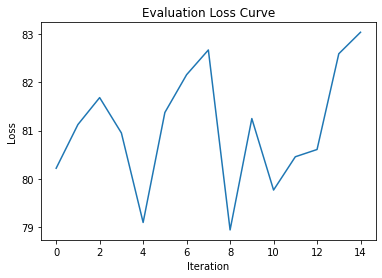

In [40]:
# Defining the Plot Style
#plt.style.use('classic')

# Plotting the last 100 values
plt.plot(eval_losses[-100:])
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.title('Evaluation Loss Curve')
plt.show()


### Plotting the Original Signal and Reconstructed Image for the First signal

In [58]:
print(ecg_signal.shape)

torch.Size([2, 600])


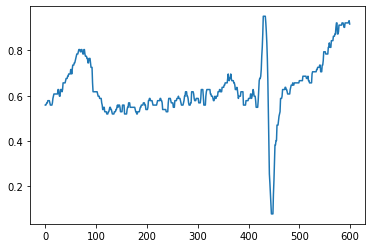

In [59]:
plt.plot(ecg_signal[0].detach().cpu().numpy())

In [51]:
print(mri_image.shape)

torch.Size([2, 1, 128, 128])


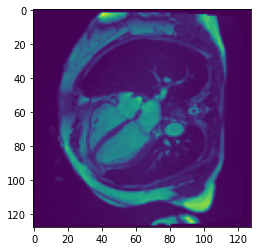

In [52]:
plt.imshow(mri_image[0,0].cpu().detach().numpy())

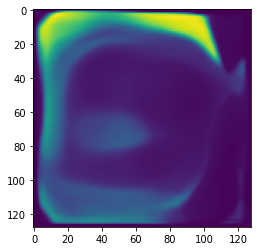

In [53]:
plt.imshow(reconstructed_mri[0,0].cpu().detach().numpy())

In [64]:
len(outputs)

8


-------------------    Plot of Signal:   0    -------------------



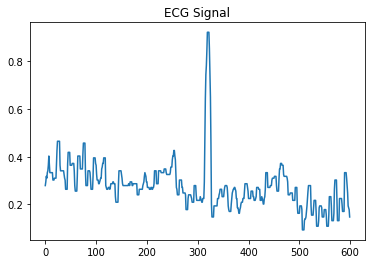

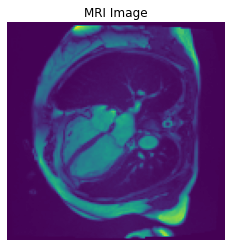

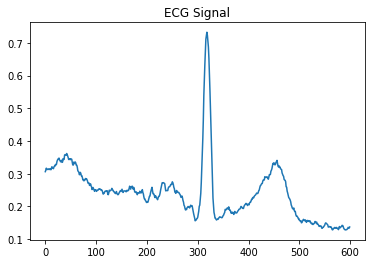


-------------------    Plot of Signal:   1    -------------------



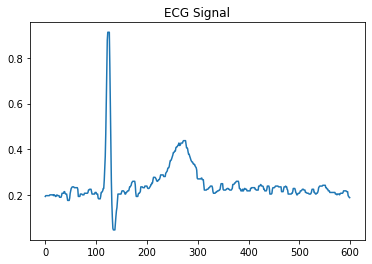

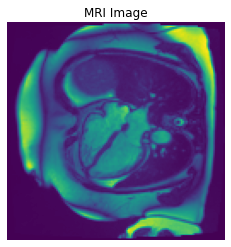

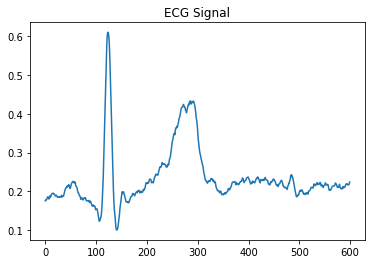


-------------------    Plot of Signal:   2    -------------------



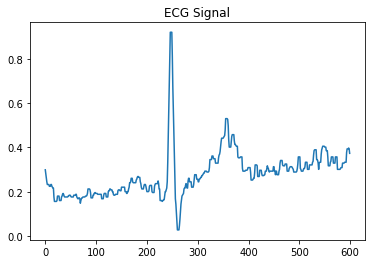

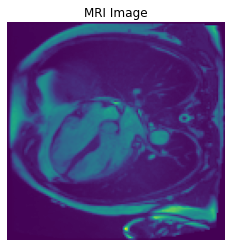

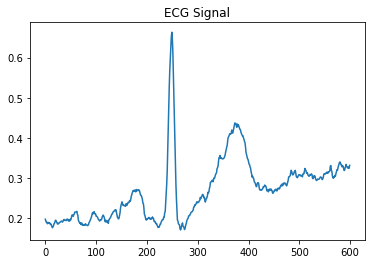


-------------------    Plot of Signal:   3    -------------------



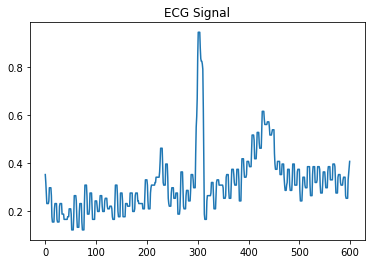

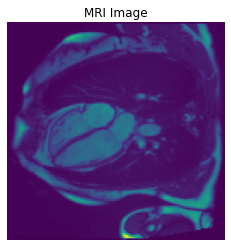

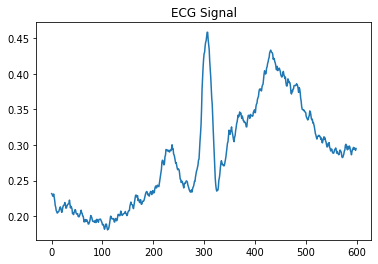


-------------------    Plot of Signal:   4    -------------------



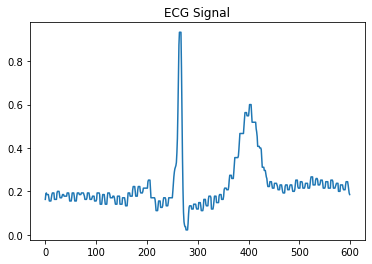

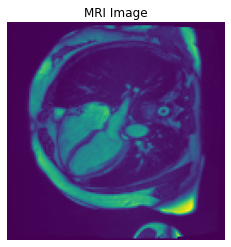

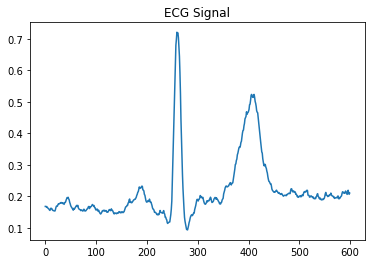


-------------------    Plot of Signal:   5    -------------------



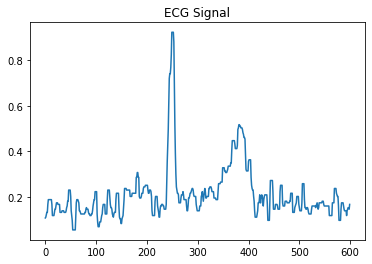

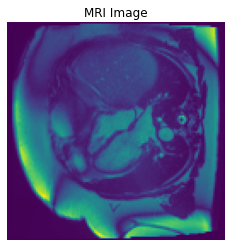

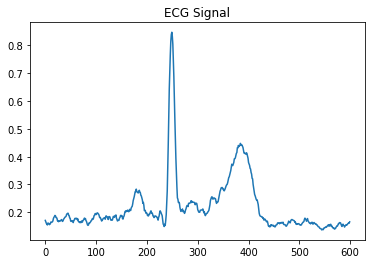


-------------------    Plot of Signal:   6    -------------------



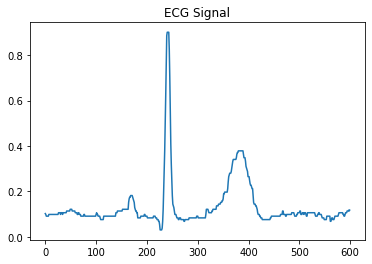

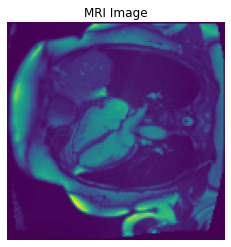

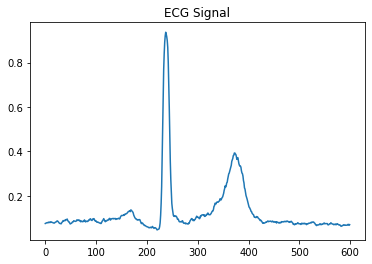


-------------------    Plot of Signal:   7    -------------------



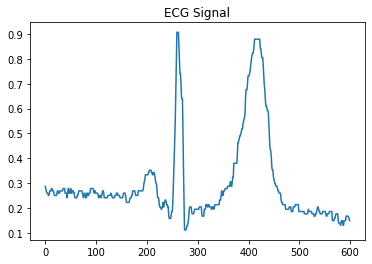

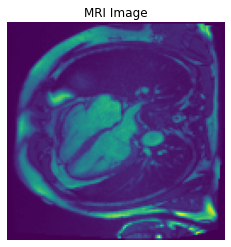

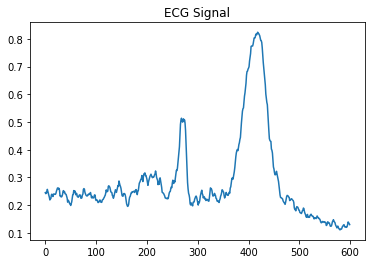


-------------------    Plot of Signal:   8    -------------------



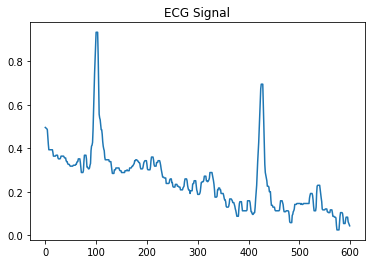

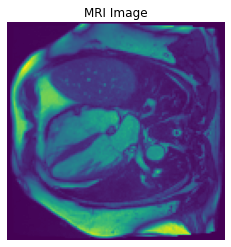

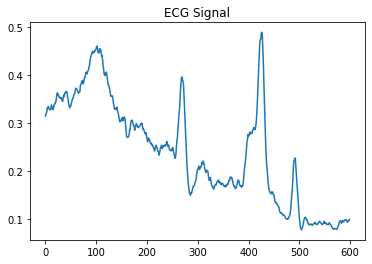


-------------------    Plot of Signal:   9    -------------------



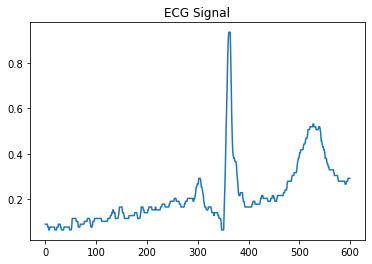

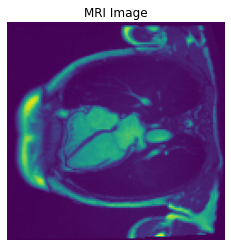

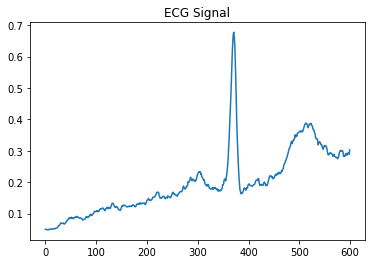


-------------------    Plot of Signal:   10    -------------------



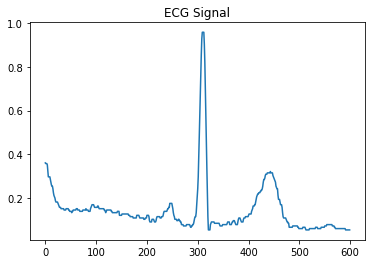

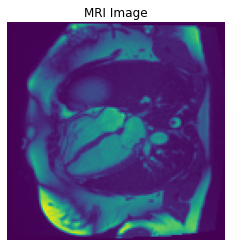

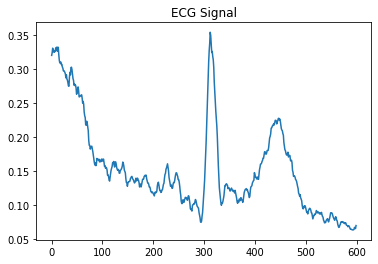


-------------------    Plot of Signal:   11    -------------------



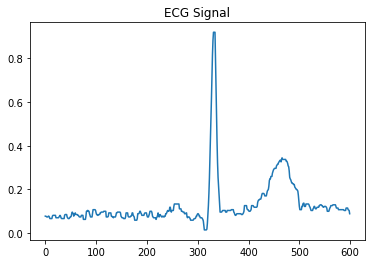

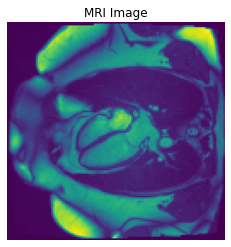

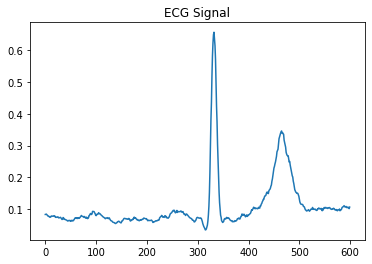


-------------------    Plot of Signal:   12    -------------------



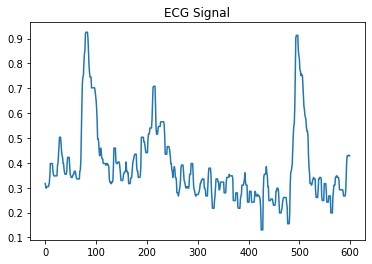

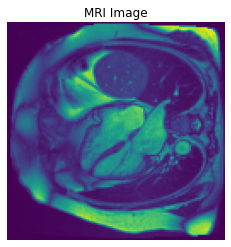

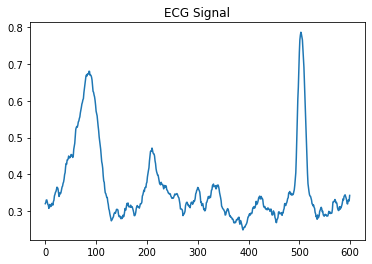


-------------------    Plot of Signal:   13    -------------------



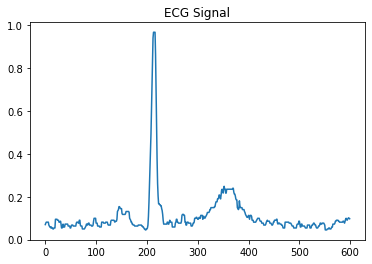

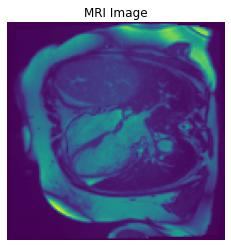

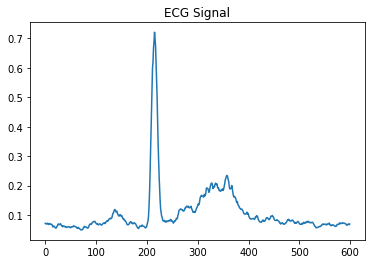


-------------------    Plot of Signal:   14    -------------------



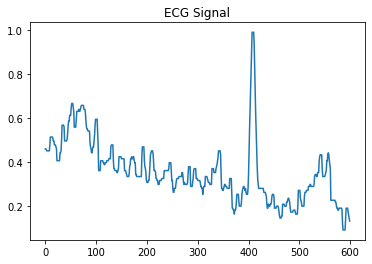

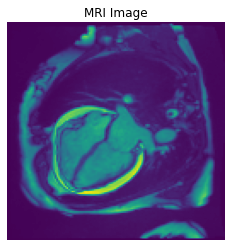

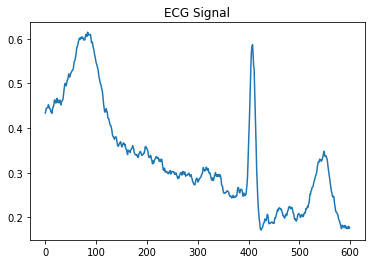


-------------------    Plot of Signal:   15    -------------------



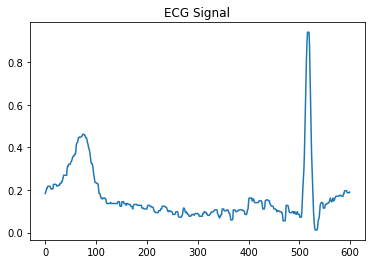

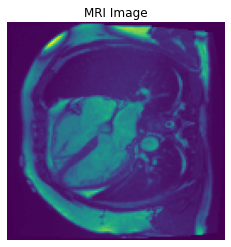

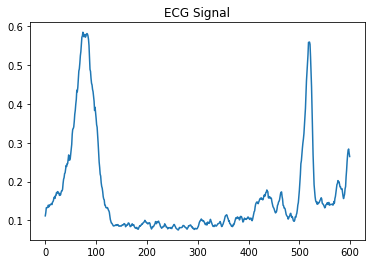


-------------------    Plot of Signal:   16    -------------------



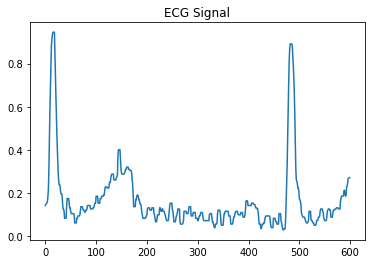

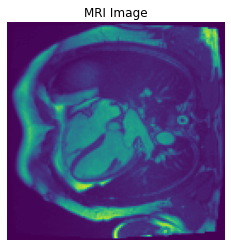

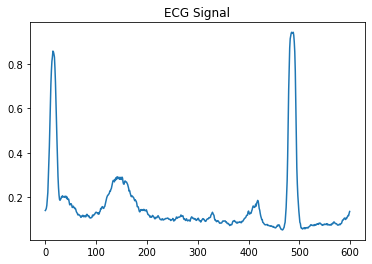


-------------------    Plot of Signal:   17    -------------------



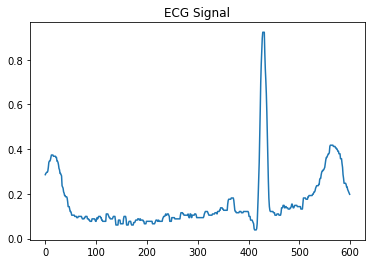

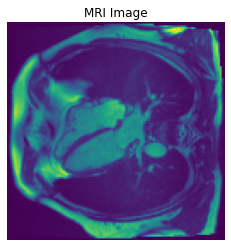

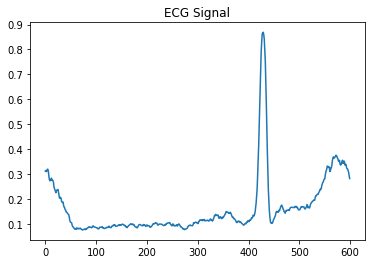


-------------------    Plot of Signal:   18    -------------------



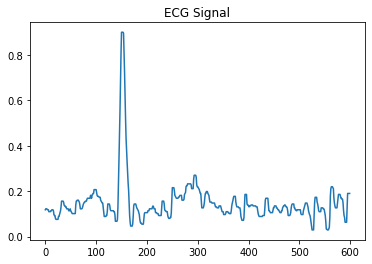

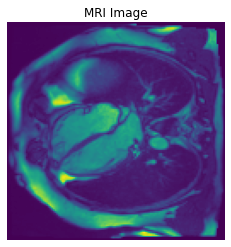

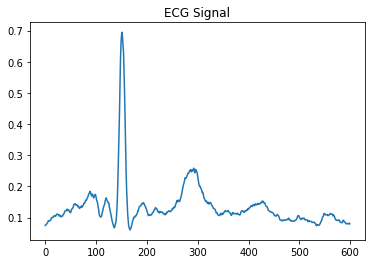


-------------------    Plot of Signal:   19    -------------------



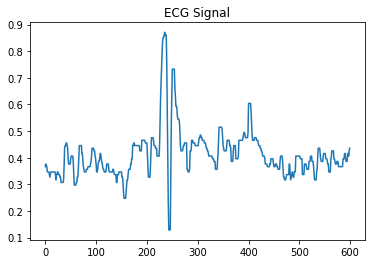

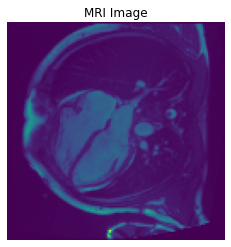

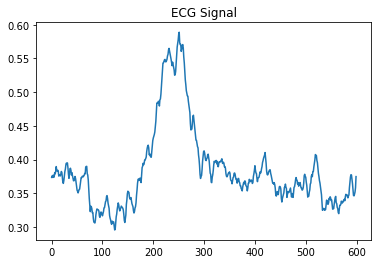


-------------------    Plot of Signal:   20    -------------------



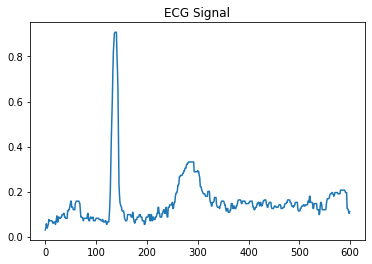

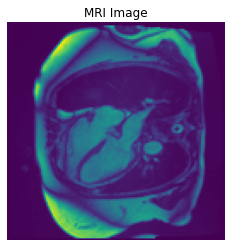

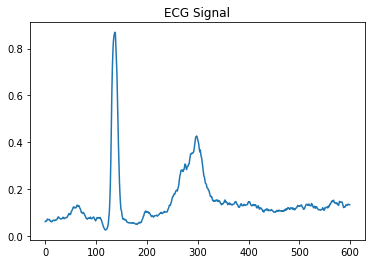


-------------------    Plot of Signal:   21    -------------------



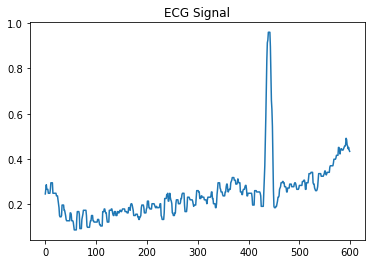

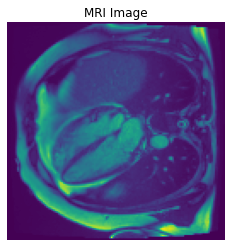

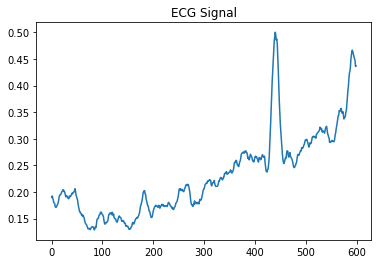


-------------------    Plot of Signal:   22    -------------------



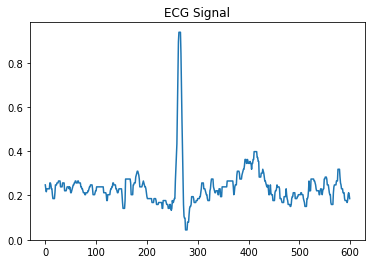

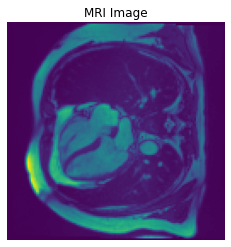

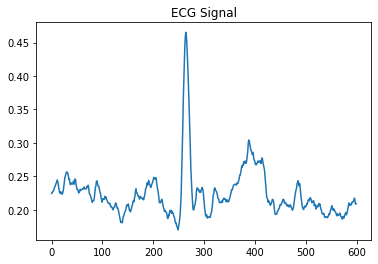


-------------------    Plot of Signal:   23    -------------------



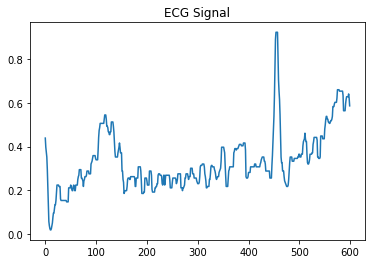

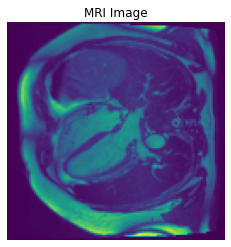

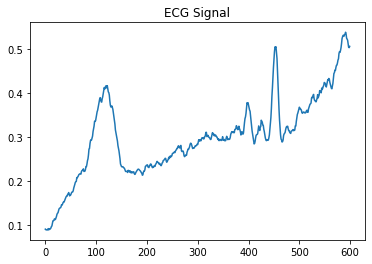


-------------------    Plot of Signal:   24    -------------------



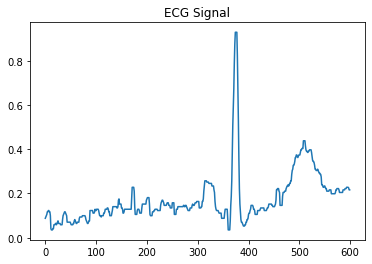

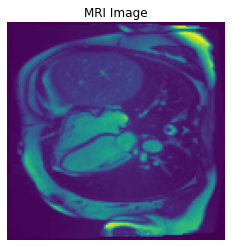

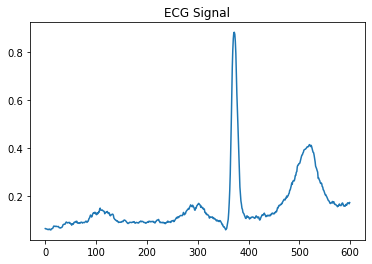


-------------------    Plot of Signal:   25    -------------------



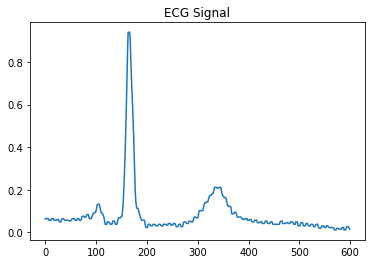

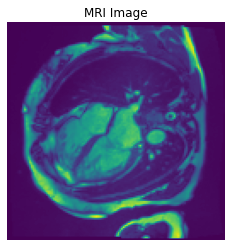

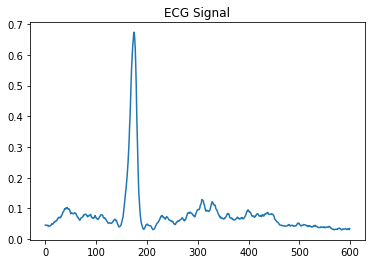


-------------------    Plot of Signal:   26    -------------------



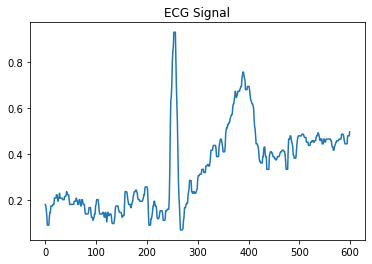

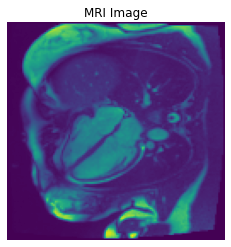

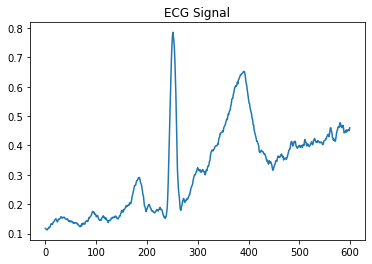


-------------------    Plot of Signal:   27    -------------------



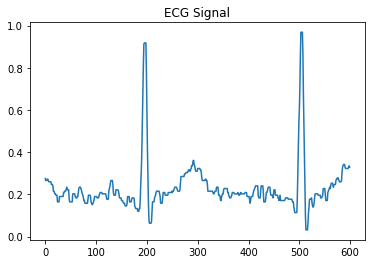

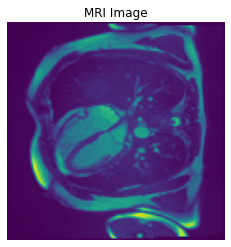

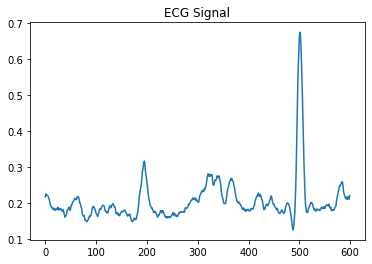


-------------------    Plot of Signal:   28    -------------------



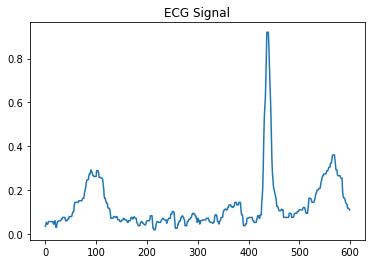

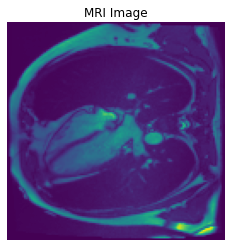

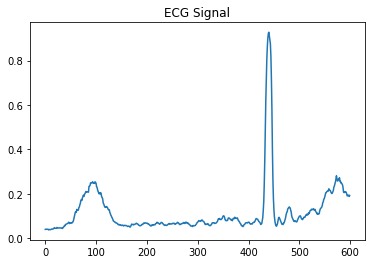


-------------------    Plot of Signal:   29    -------------------



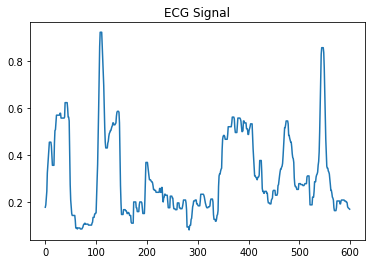

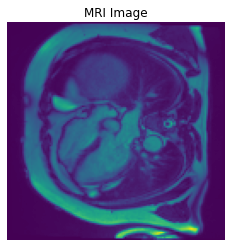

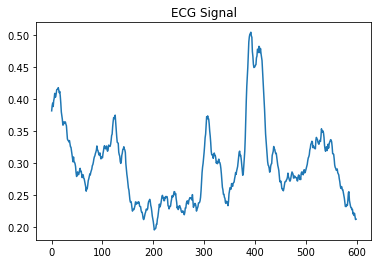


-------------------    Plot of Signal:   30    -------------------



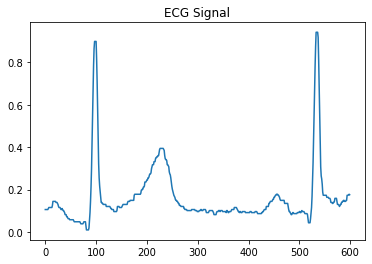

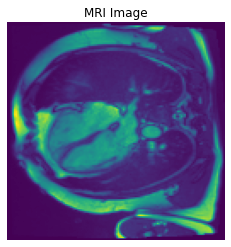

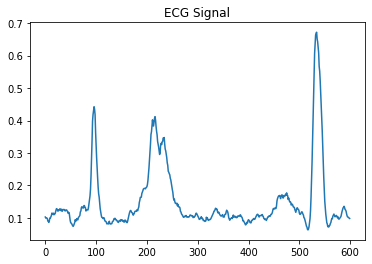


-------------------    Plot of Signal:   31    -------------------



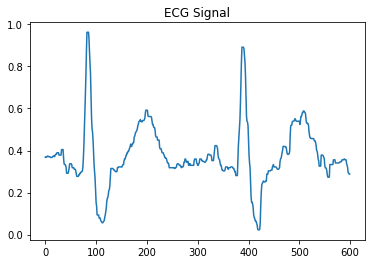

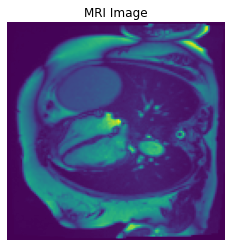

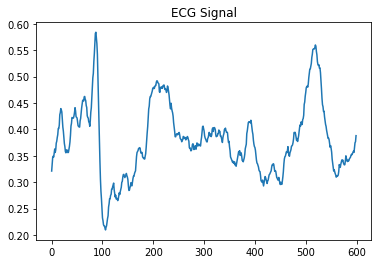


-------------------    Plot of Signal:   32    -------------------



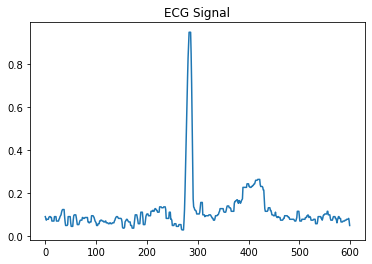

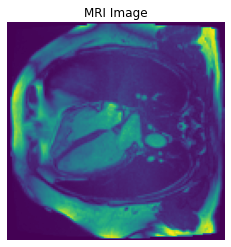

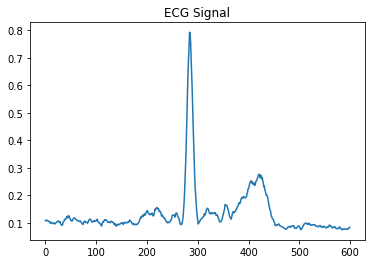


-------------------    Plot of Signal:   33    -------------------



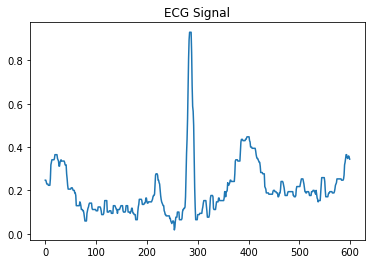

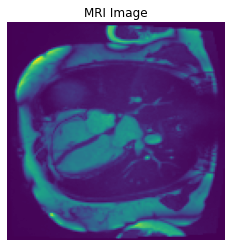

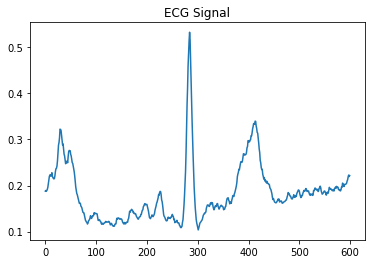


-------------------    Plot of Signal:   34    -------------------



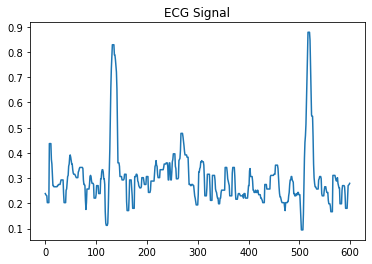

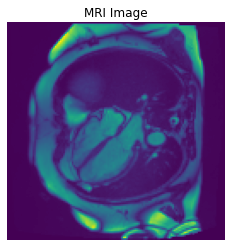

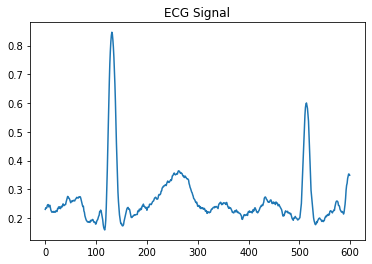


-------------------    Plot of Signal:   35    -------------------



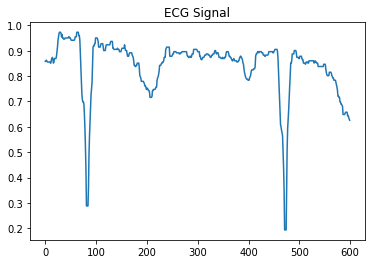

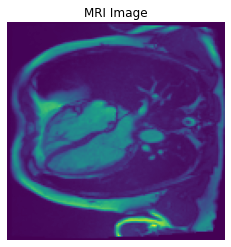

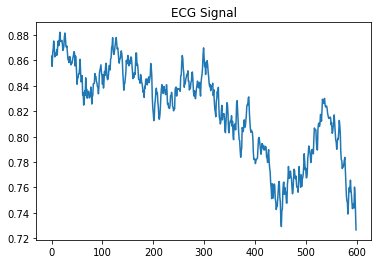


-------------------    Plot of Signal:   36    -------------------



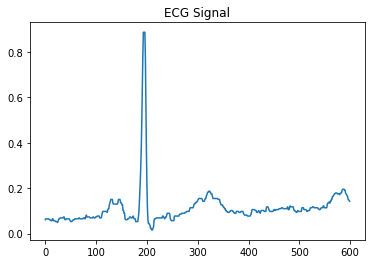

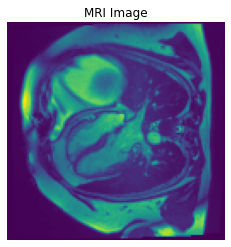

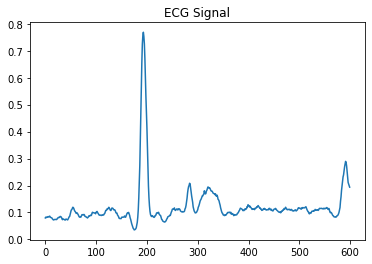


-------------------    Plot of Signal:   37    -------------------



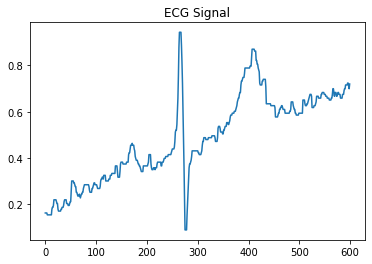

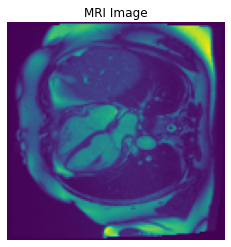

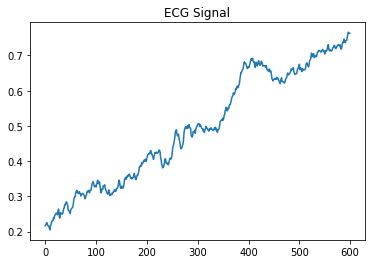


-------------------    Plot of Signal:   38    -------------------



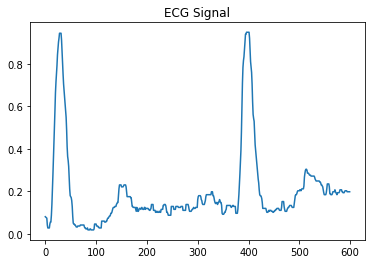

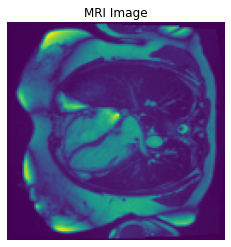

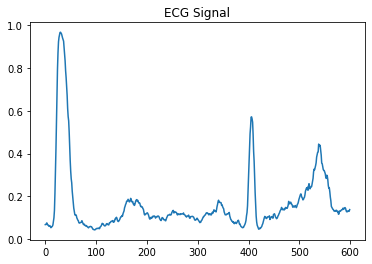


-------------------    Plot of Signal:   39    -------------------



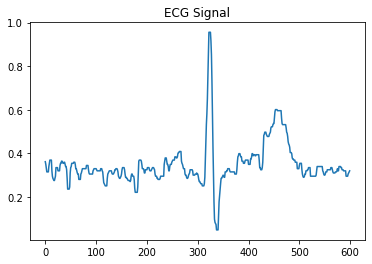

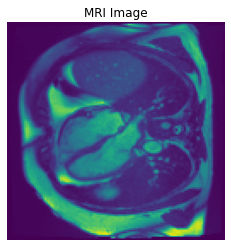

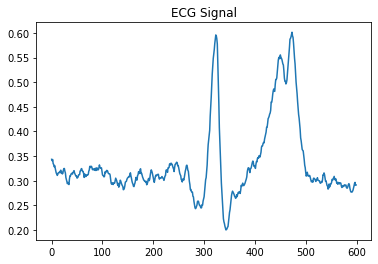


-------------------    Plot of Signal:   40    -------------------



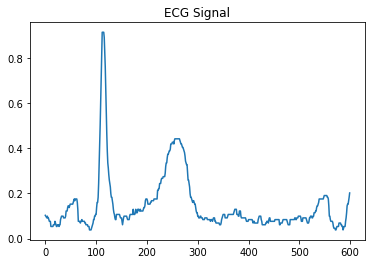

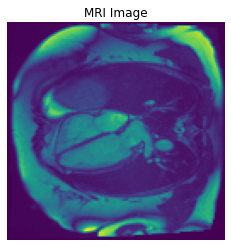

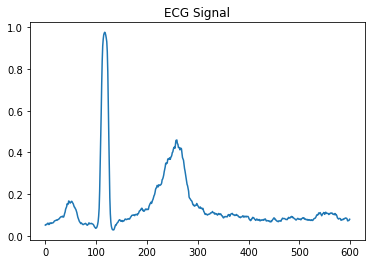


-------------------    Plot of Signal:   41    -------------------



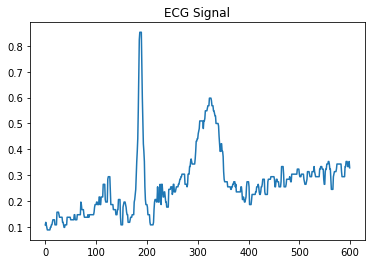

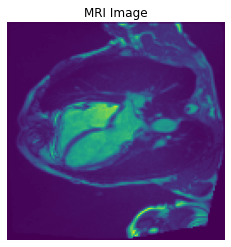

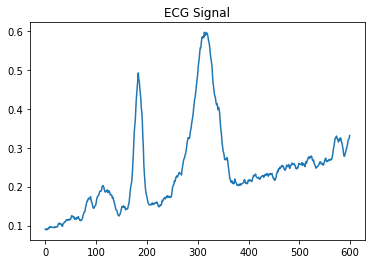


-------------------    Plot of Signal:   42    -------------------



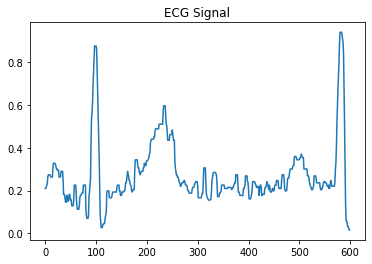

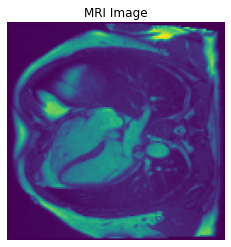

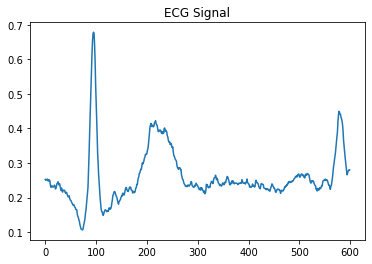


-------------------    Plot of Signal:   43    -------------------



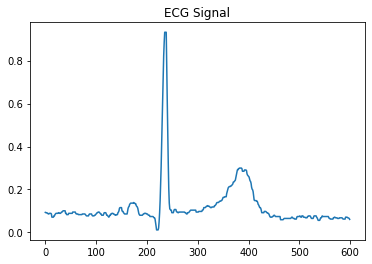

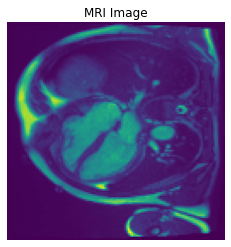

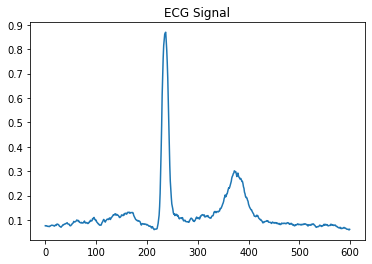


-------------------    Plot of Signal:   44    -------------------



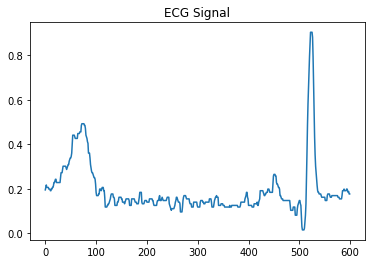

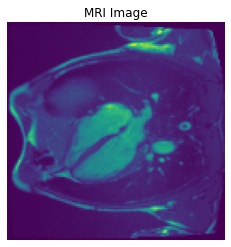

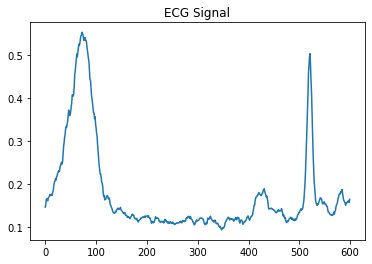


-------------------    Plot of Signal:   45    -------------------



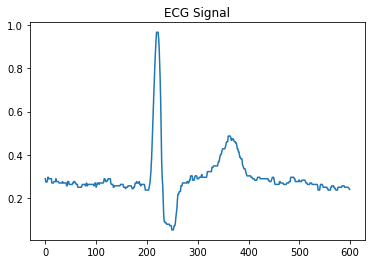

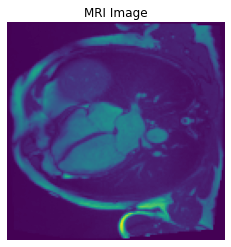

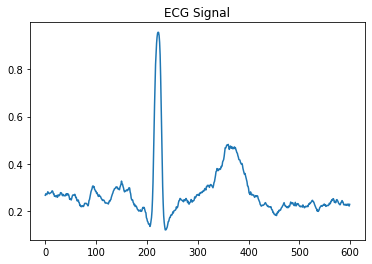


-------------------    Plot of Signal:   46    -------------------



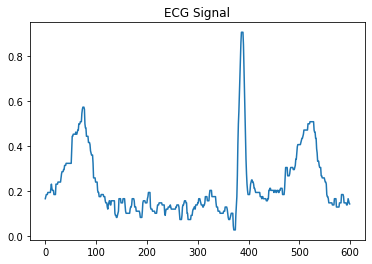

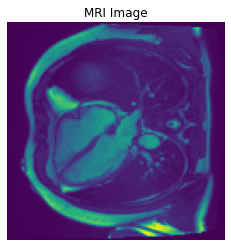

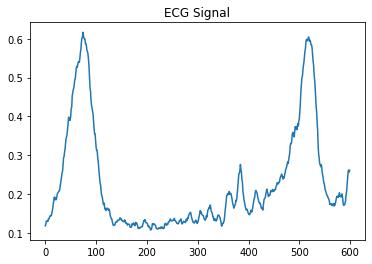


-------------------    Plot of Signal:   47    -------------------



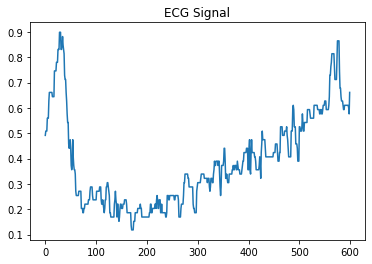

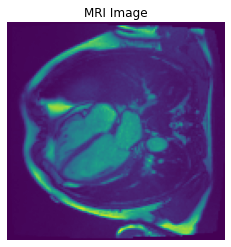

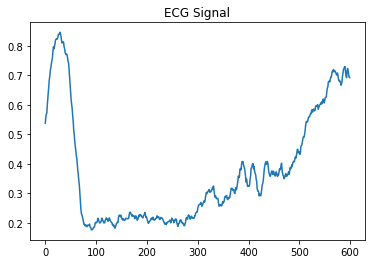


-------------------    Plot of Signal:   48    -------------------



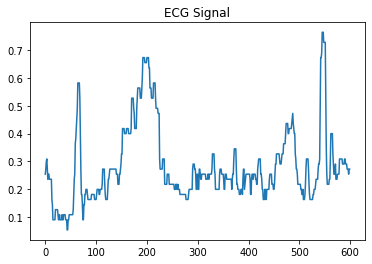

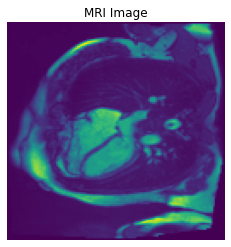

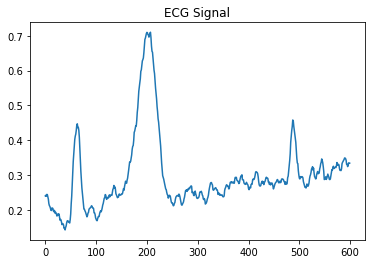


-------------------    Plot of Signal:   49    -------------------



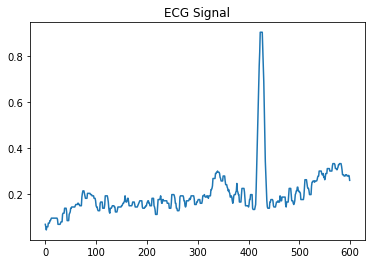

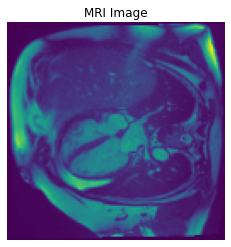

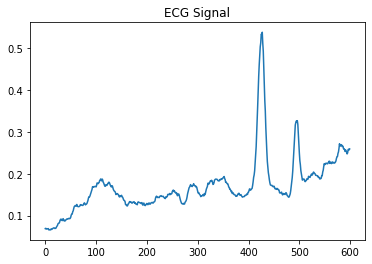


-------------------    Plot of Signal:   50    -------------------



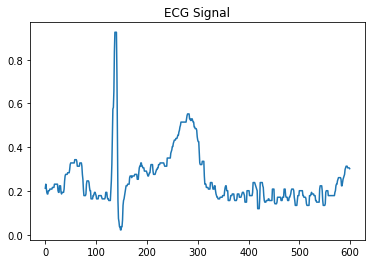

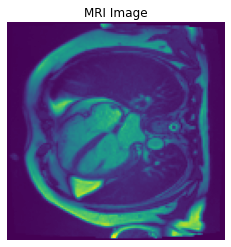

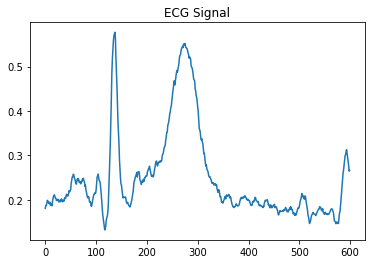


-------------------    Plot of Signal:   51    -------------------



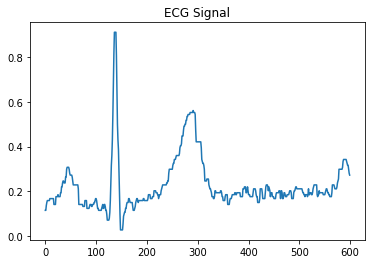

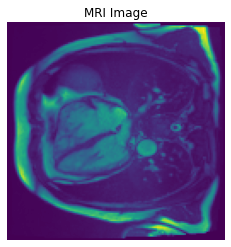

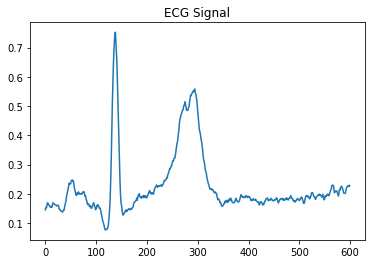


-------------------    Plot of Signal:   52    -------------------



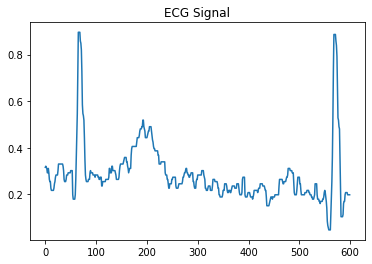

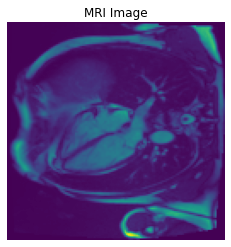

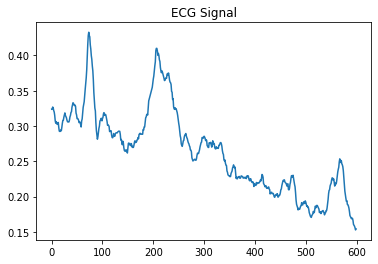


-------------------    Plot of Signal:   53    -------------------



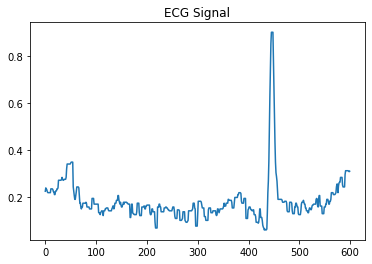

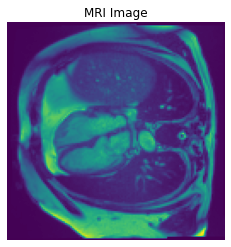

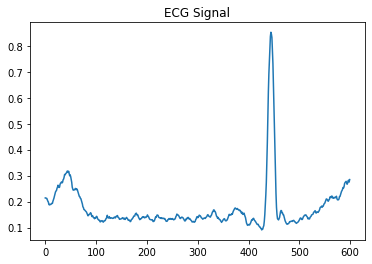


-------------------    Plot of Signal:   54    -------------------



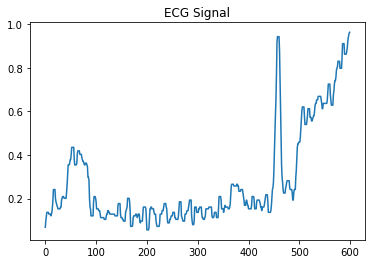

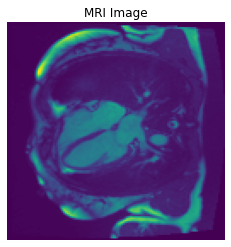

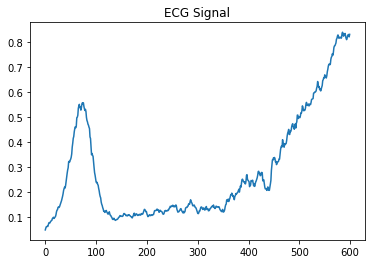


-------------------    Plot of Signal:   55    -------------------



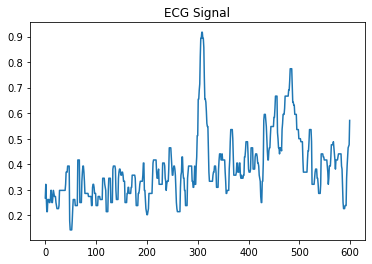

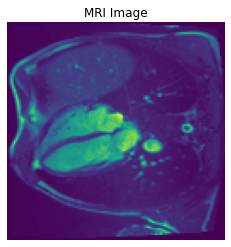

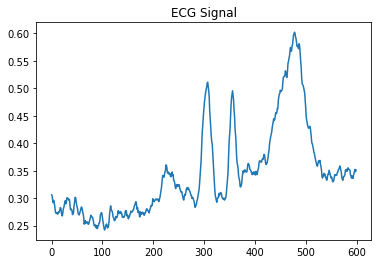


-------------------    Plot of Signal:   56    -------------------



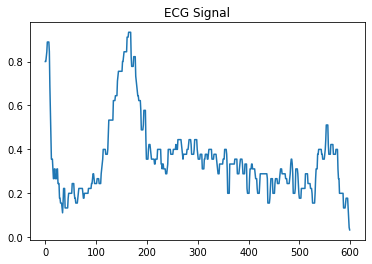

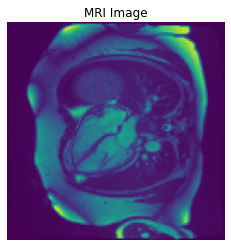

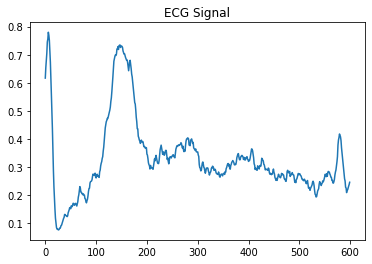


-------------------    Plot of Signal:   57    -------------------



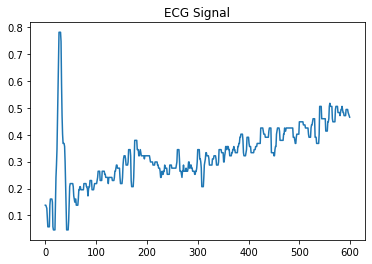

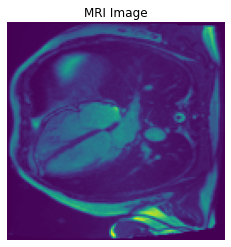

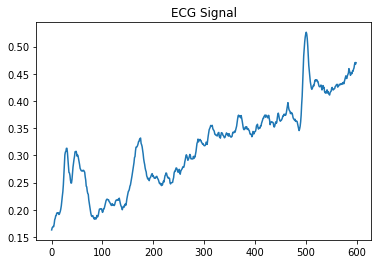


-------------------    Plot of Signal:   58    -------------------



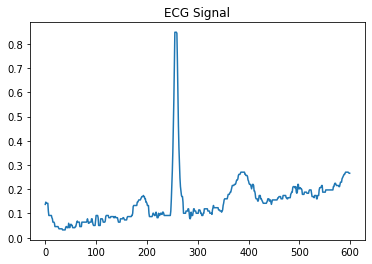

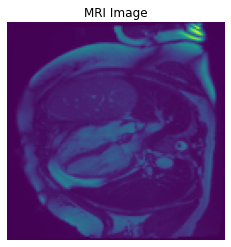

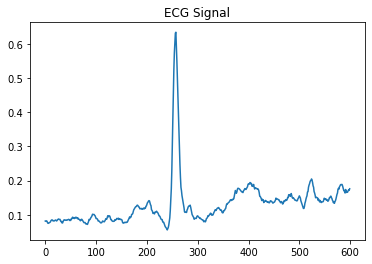


-------------------    Plot of Signal:   59    -------------------



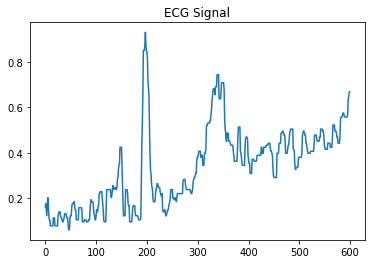

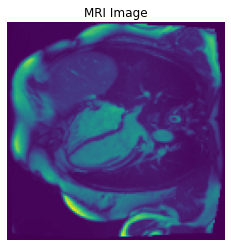

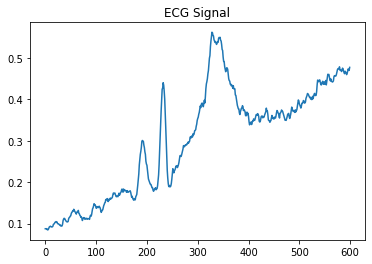


-------------------    Plot of Signal:   60    -------------------



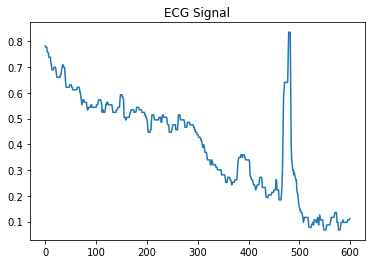

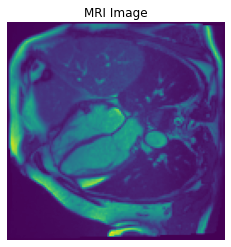

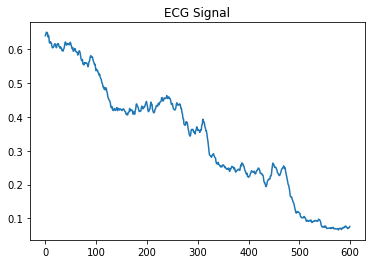


-------------------    Plot of Signal:   61    -------------------



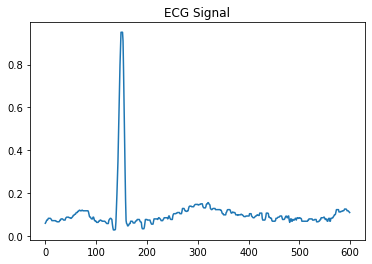

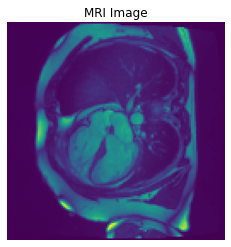

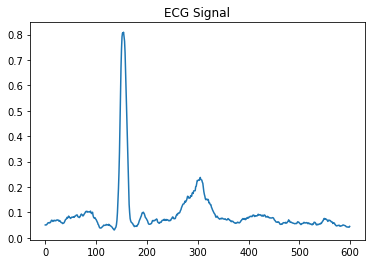


-------------------    Plot of Signal:   62    -------------------



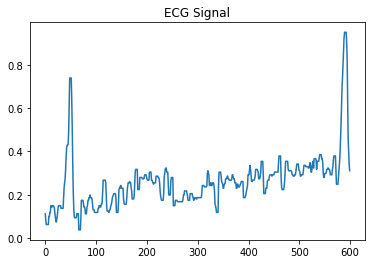

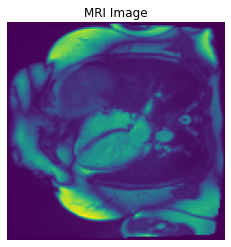

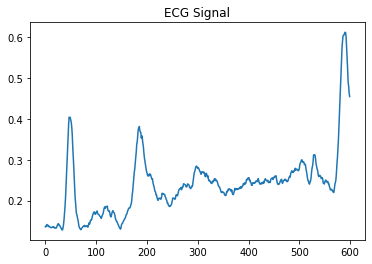


-------------------    Plot of Signal:   63    -------------------



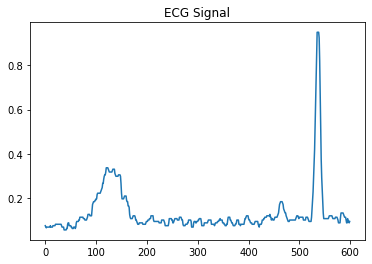

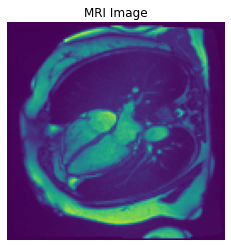

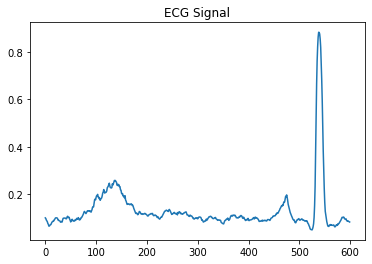


-------------------    Plot of Signal:   0    -------------------



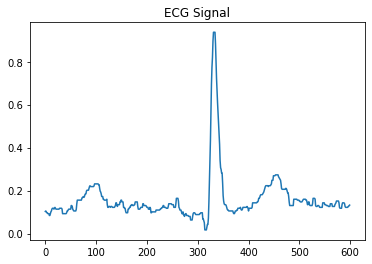

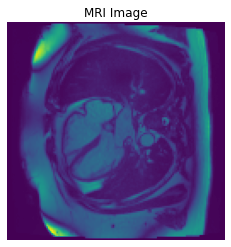

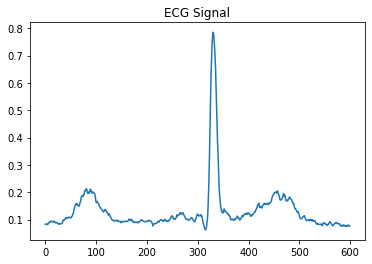


-------------------    Plot of Signal:   1    -------------------



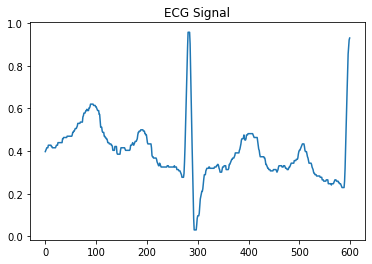

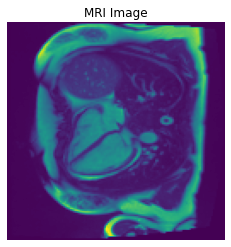

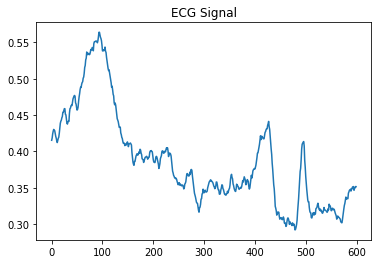


-------------------    Plot of Signal:   2    -------------------



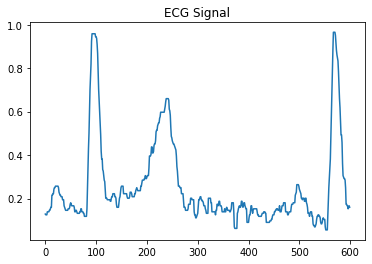

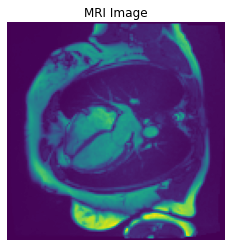

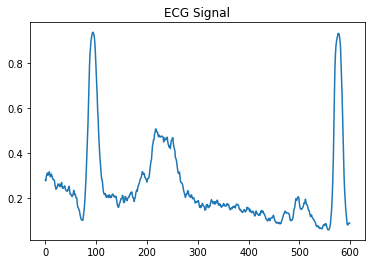


-------------------    Plot of Signal:   3    -------------------



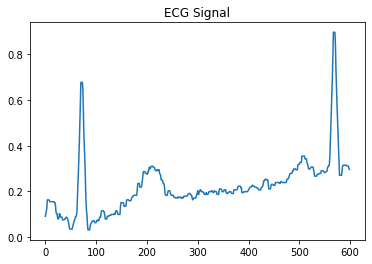

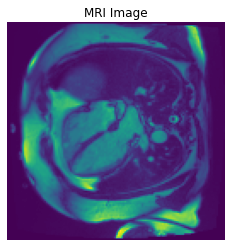

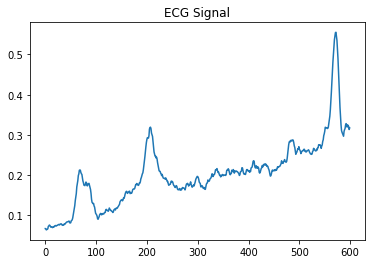


-------------------    Plot of Signal:   4    -------------------



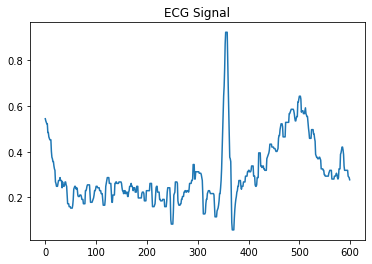

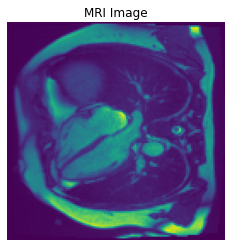

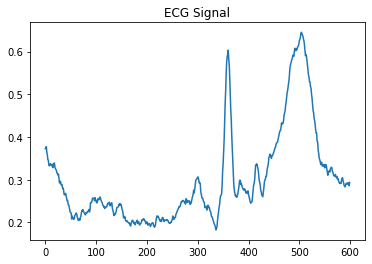


-------------------    Plot of Signal:   5    -------------------



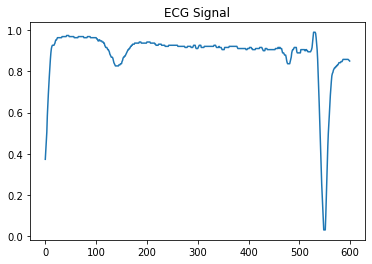

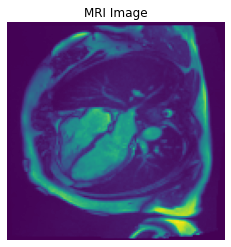

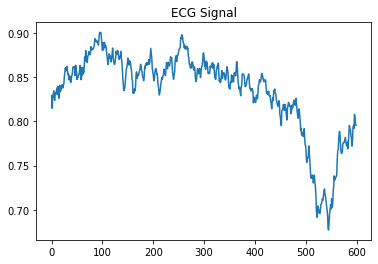


-------------------    Plot of Signal:   6    -------------------



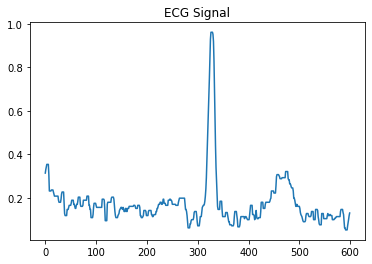

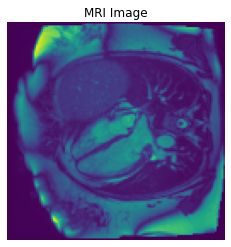

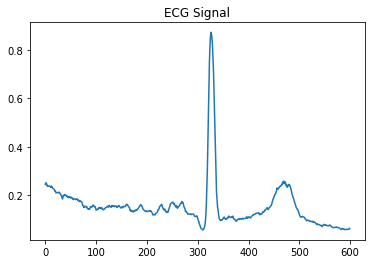


-------------------    Plot of Signal:   7    -------------------



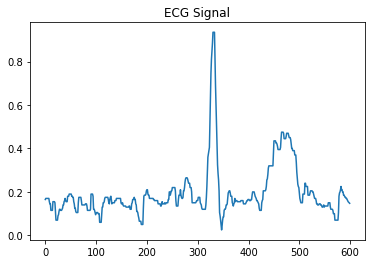

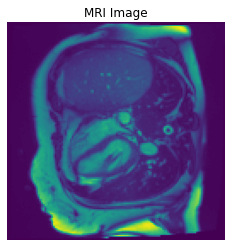

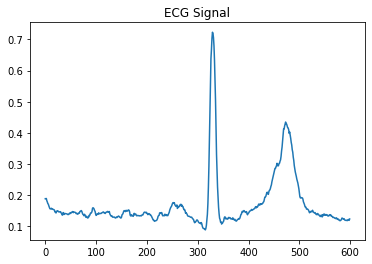


-------------------    Plot of Signal:   8    -------------------



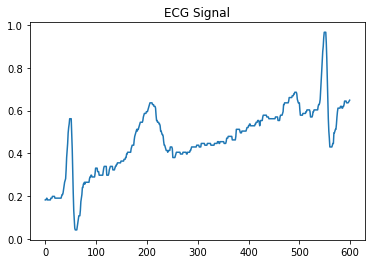

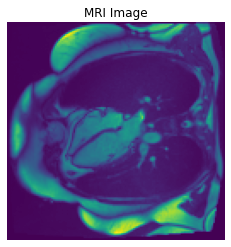

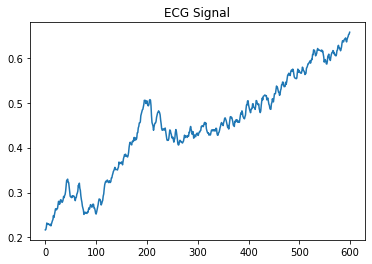


-------------------    Plot of Signal:   9    -------------------



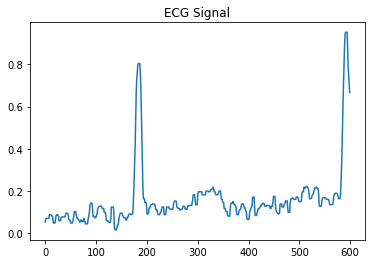

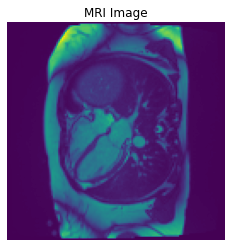

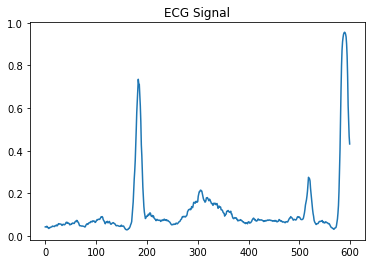


-------------------    Plot of Signal:   10    -------------------



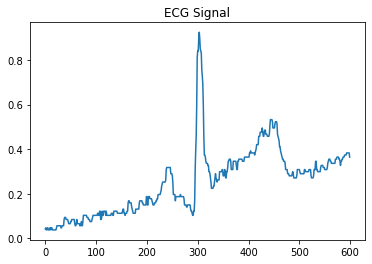

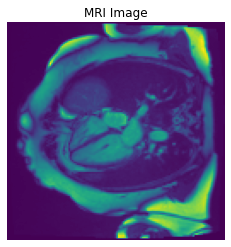

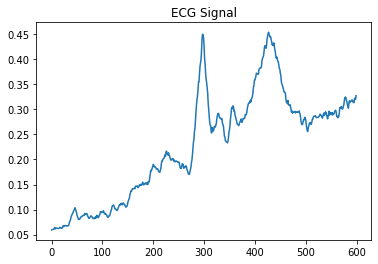


-------------------    Plot of Signal:   11    -------------------



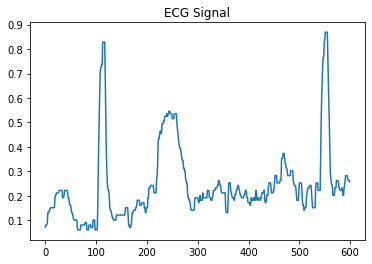

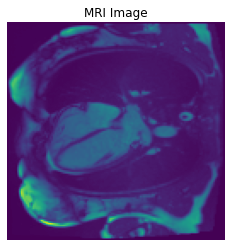

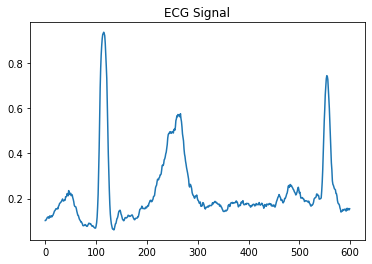


-------------------    Plot of Signal:   12    -------------------



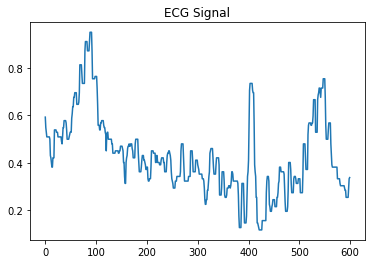

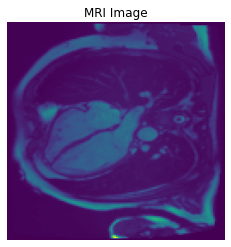

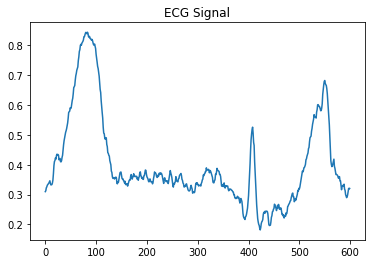


-------------------    Plot of Signal:   13    -------------------



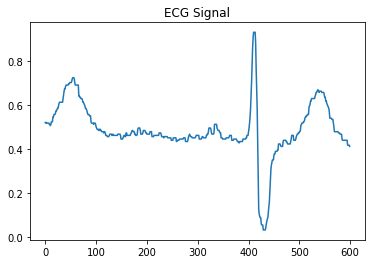

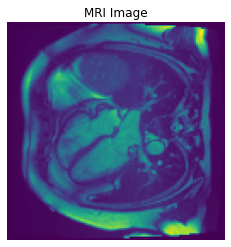

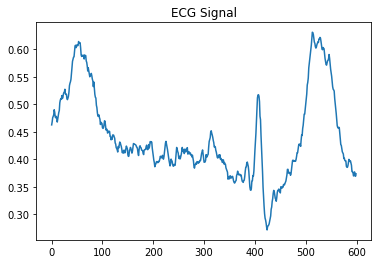


-------------------    Plot of Signal:   14    -------------------



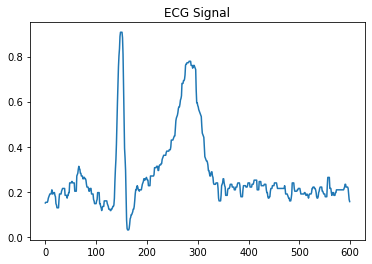

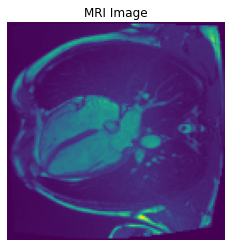

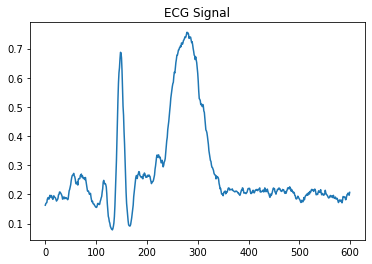


-------------------    Plot of Signal:   15    -------------------



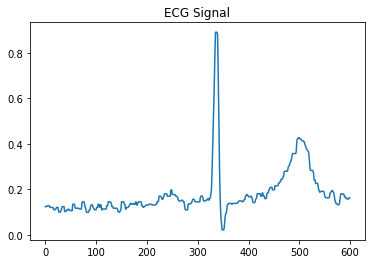

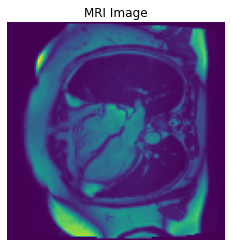

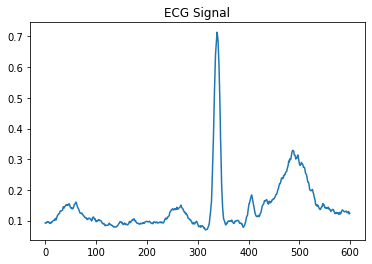


-------------------    Plot of Signal:   16    -------------------



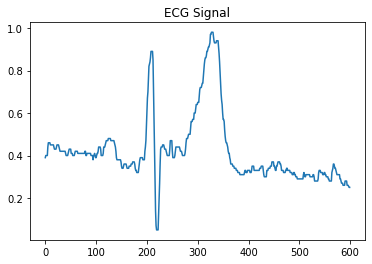

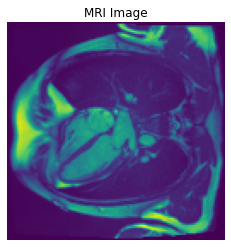

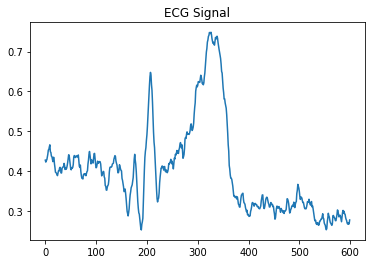


-------------------    Plot of Signal:   17    -------------------



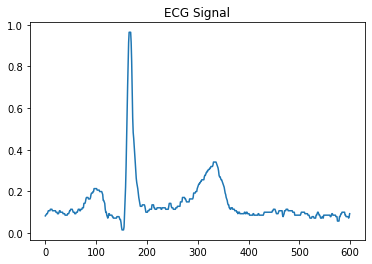

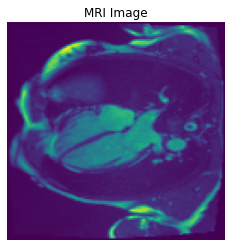

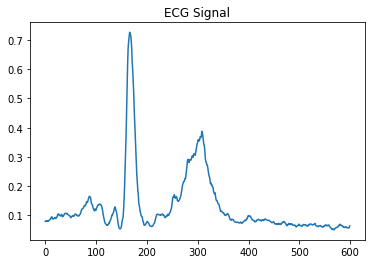


-------------------    Plot of Signal:   18    -------------------



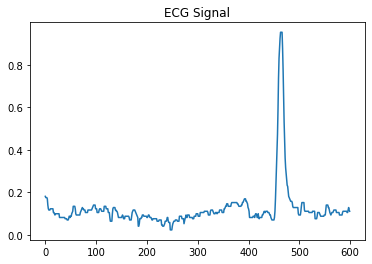

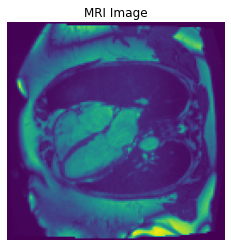

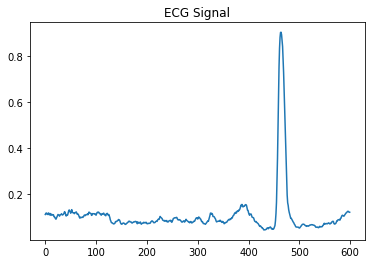


-------------------    Plot of Signal:   19    -------------------



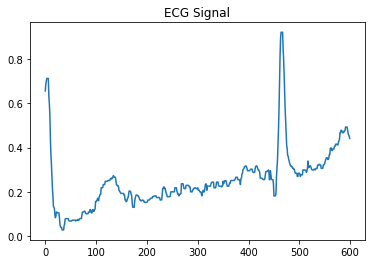

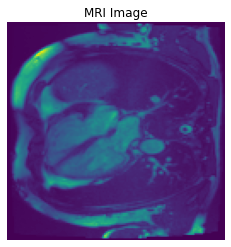

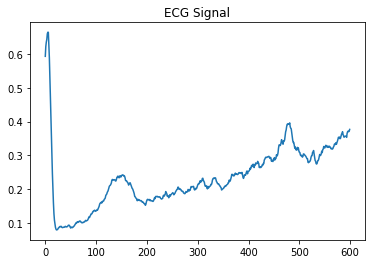


-------------------    Plot of Signal:   20    -------------------



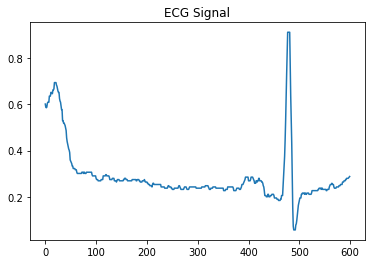

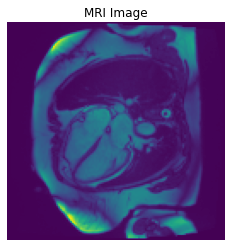

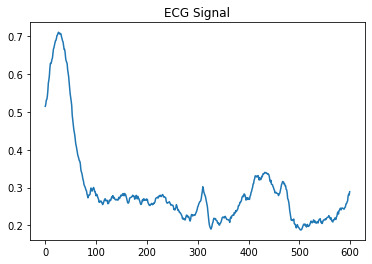


-------------------    Plot of Signal:   21    -------------------



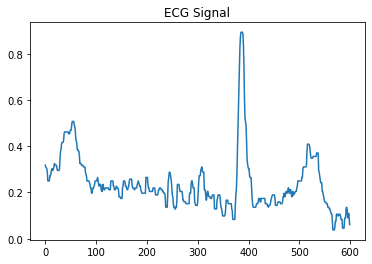

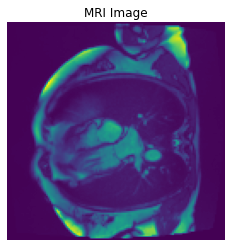

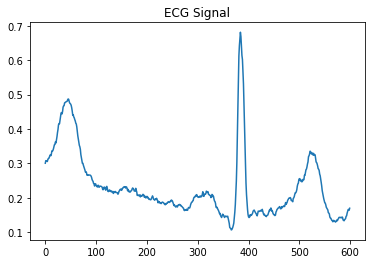


-------------------    Plot of Signal:   22    -------------------



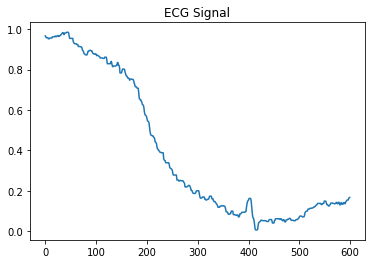

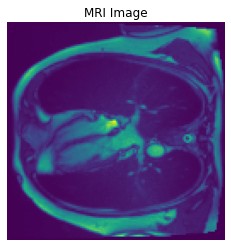

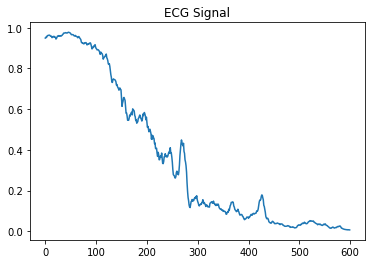


-------------------    Plot of Signal:   23    -------------------



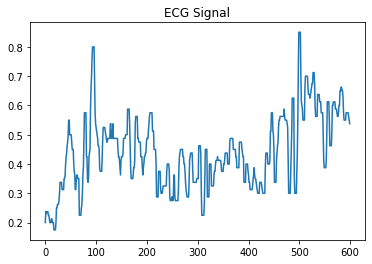

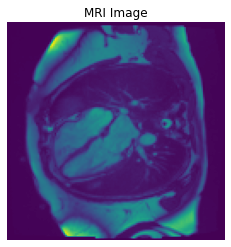

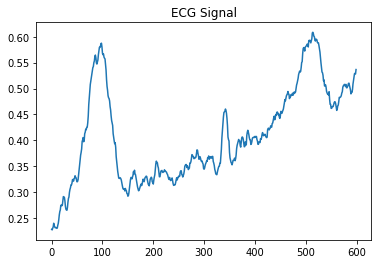


-------------------    Plot of Signal:   24    -------------------



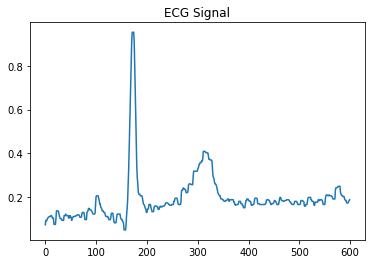

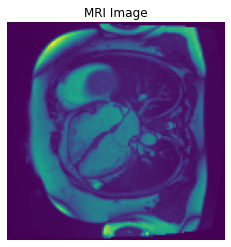

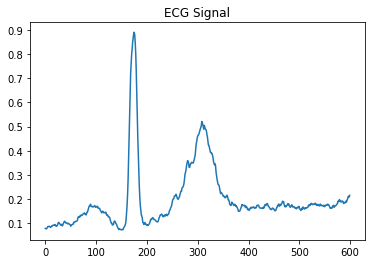


-------------------    Plot of Signal:   25    -------------------



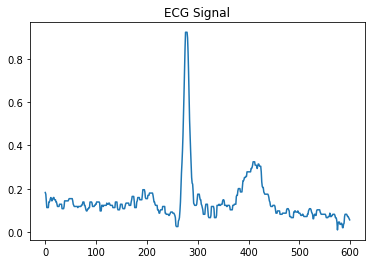

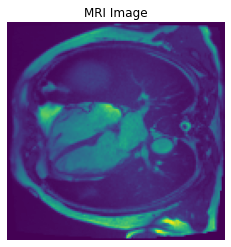

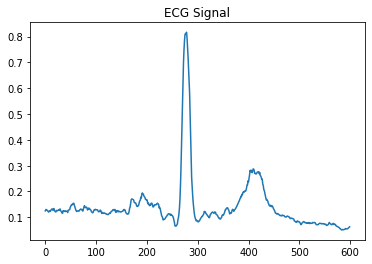


-------------------    Plot of Signal:   26    -------------------



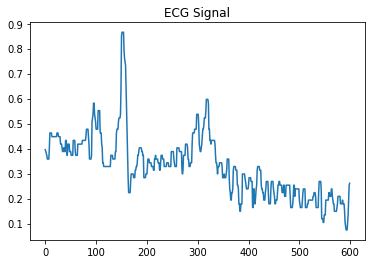

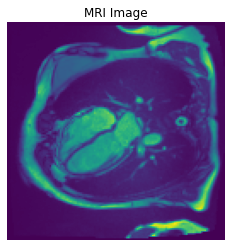

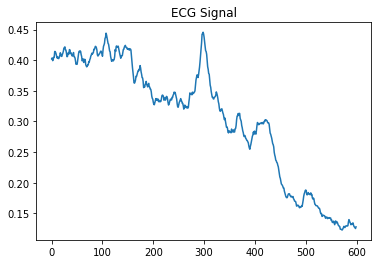


-------------------    Plot of Signal:   27    -------------------



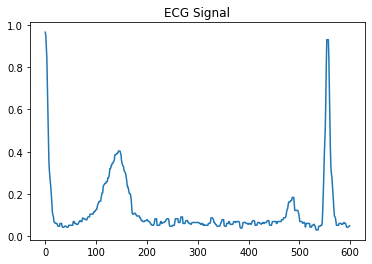

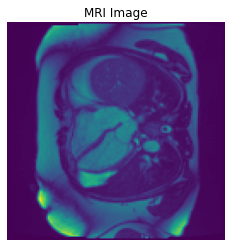

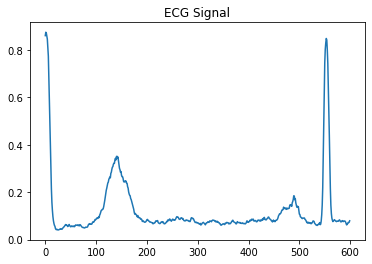


-------------------    Plot of Signal:   28    -------------------



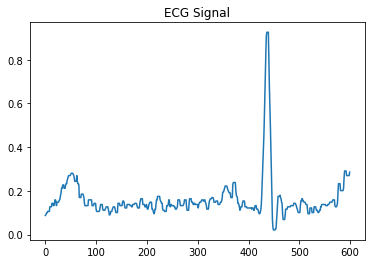

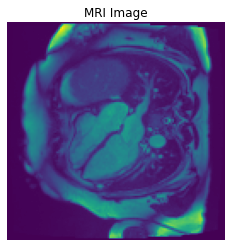

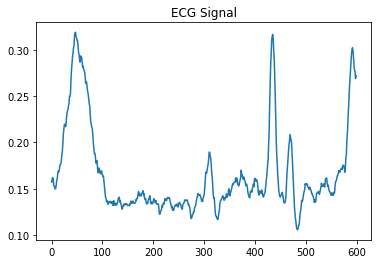


-------------------    Plot of Signal:   29    -------------------



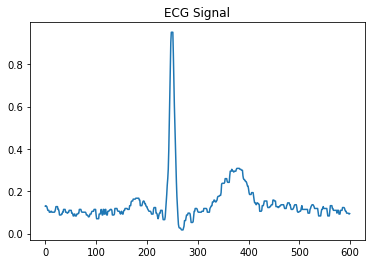

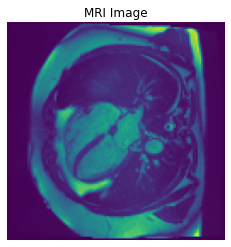

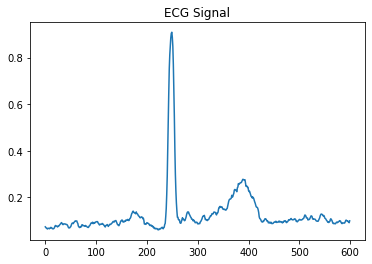


-------------------    Plot of Signal:   30    -------------------



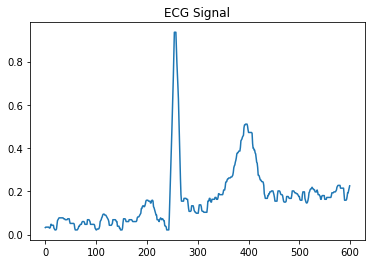

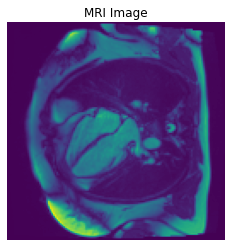

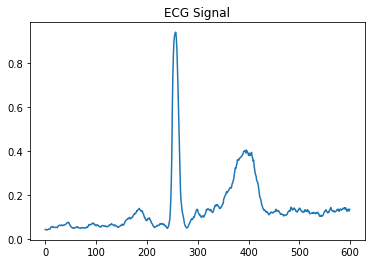


-------------------    Plot of Signal:   31    -------------------



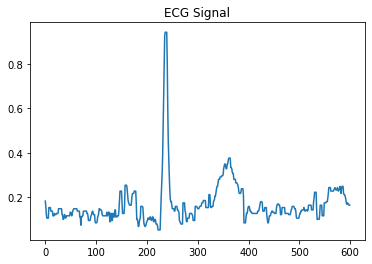

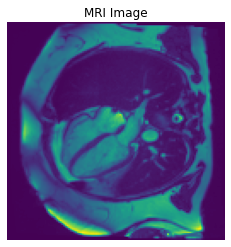

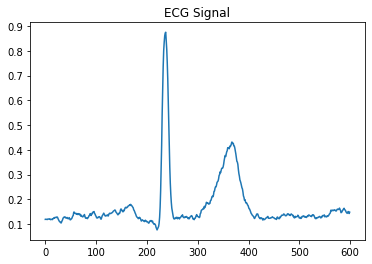


-------------------    Plot of Signal:   32    -------------------



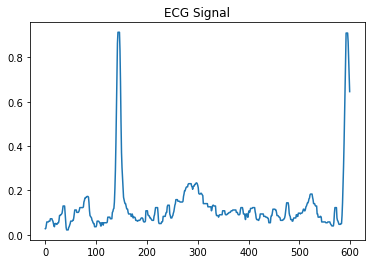

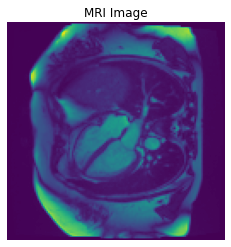

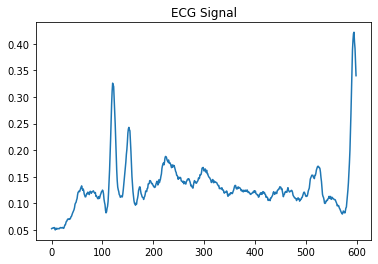


-------------------    Plot of Signal:   33    -------------------



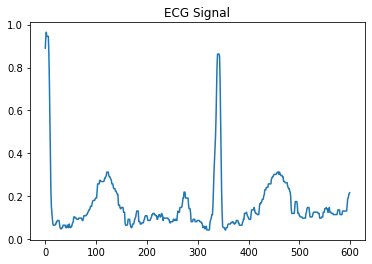

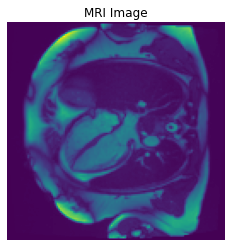

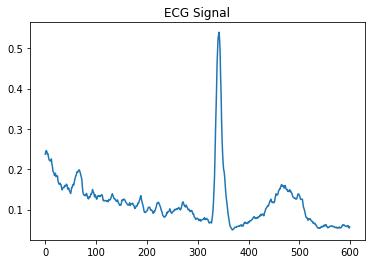


-------------------    Plot of Signal:   34    -------------------



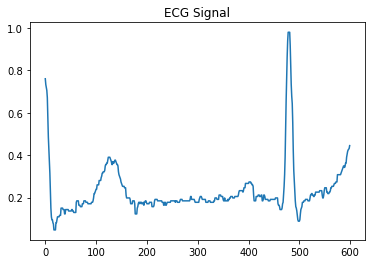

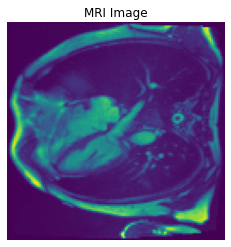

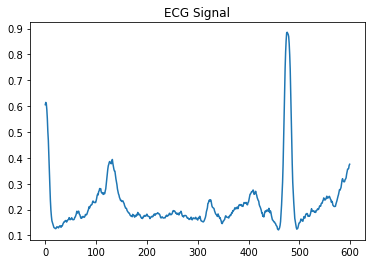


-------------------    Plot of Signal:   35    -------------------



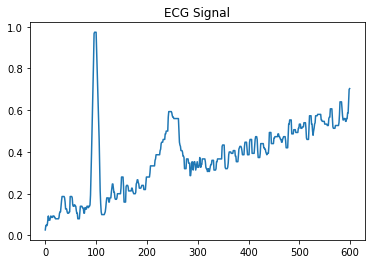

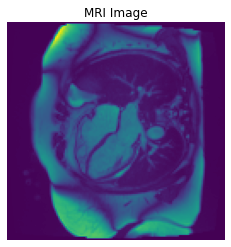

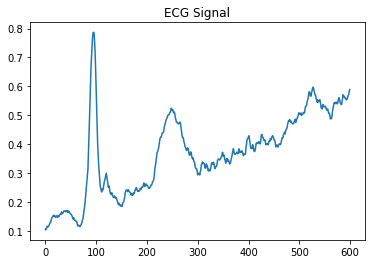


-------------------    Plot of Signal:   36    -------------------



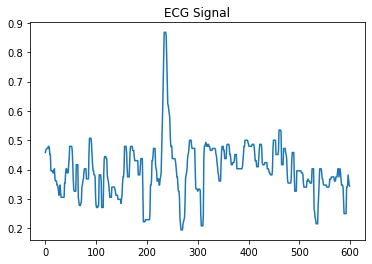

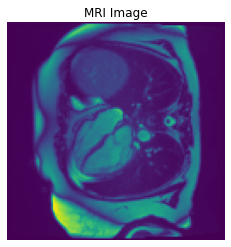

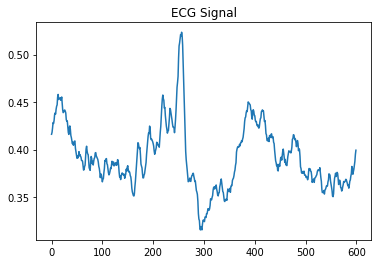


-------------------    Plot of Signal:   37    -------------------



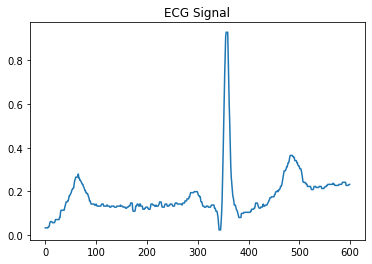

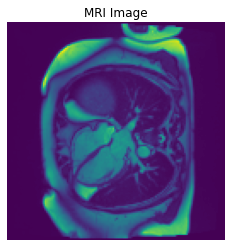

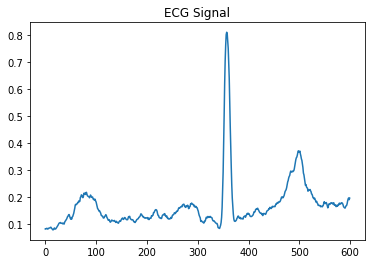


-------------------    Plot of Signal:   38    -------------------



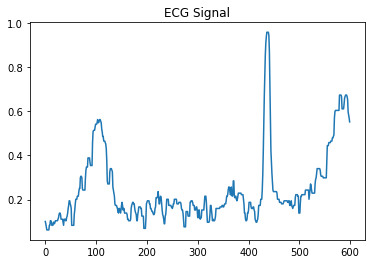

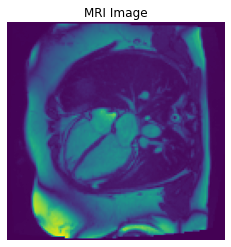

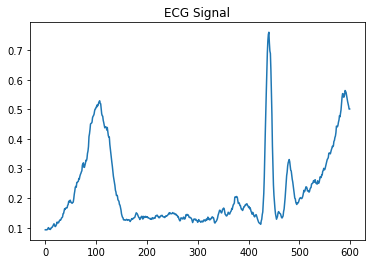


-------------------    Plot of Signal:   39    -------------------



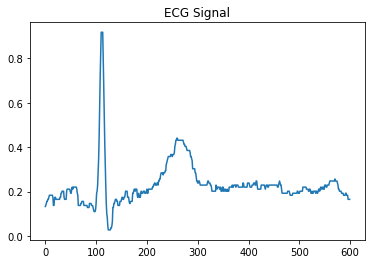

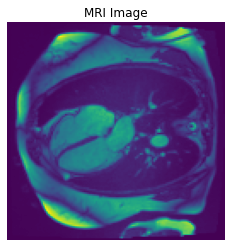

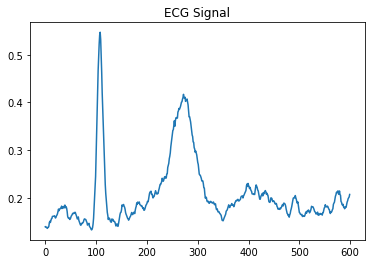


-------------------    Plot of Signal:   40    -------------------



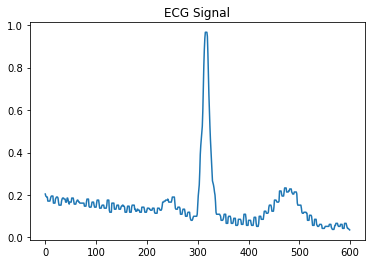

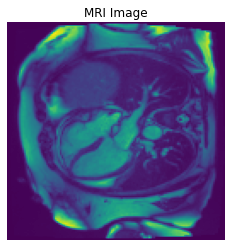

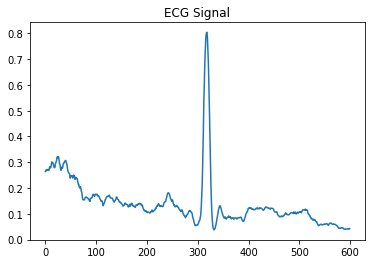


-------------------    Plot of Signal:   41    -------------------



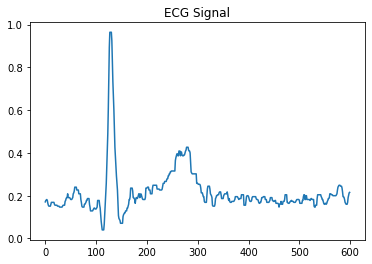

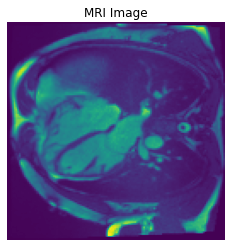

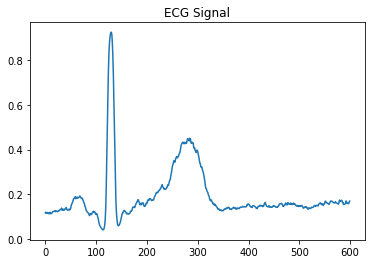


-------------------    Plot of Signal:   42    -------------------



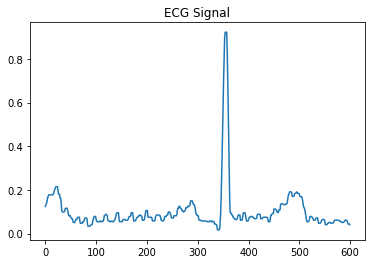

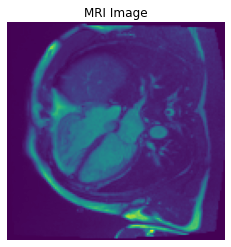

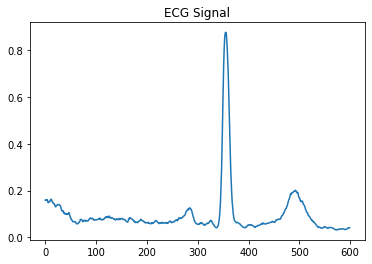


-------------------    Plot of Signal:   43    -------------------



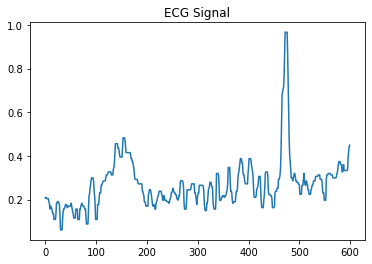

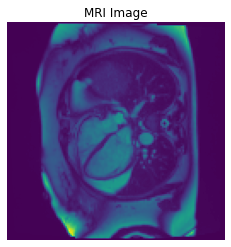

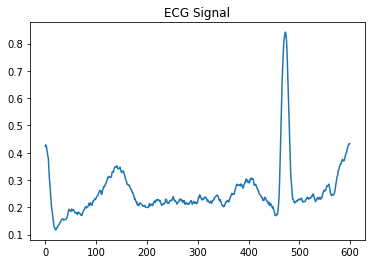


-------------------    Plot of Signal:   44    -------------------



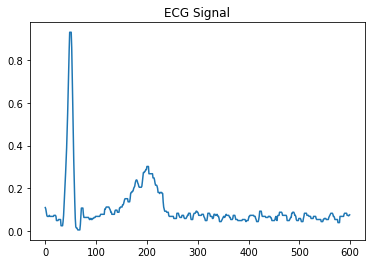

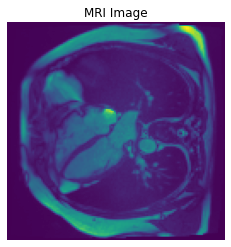

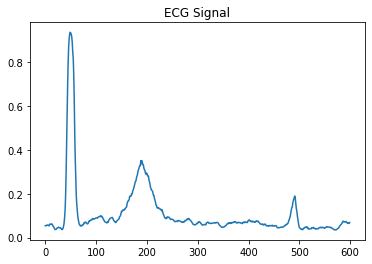


-------------------    Plot of Signal:   45    -------------------



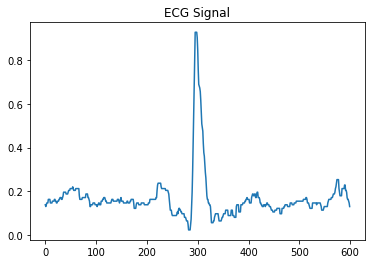

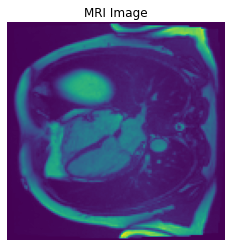

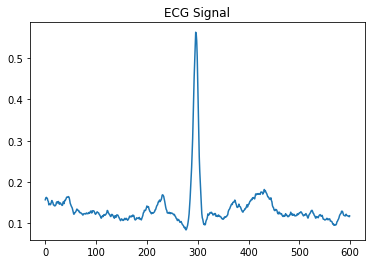


-------------------    Plot of Signal:   46    -------------------



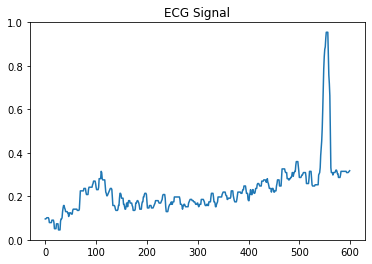

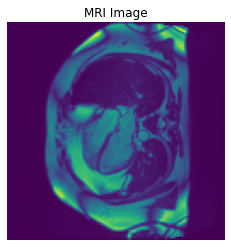

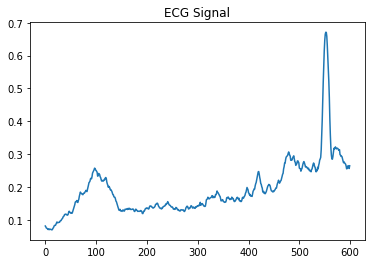


-------------------    Plot of Signal:   47    -------------------



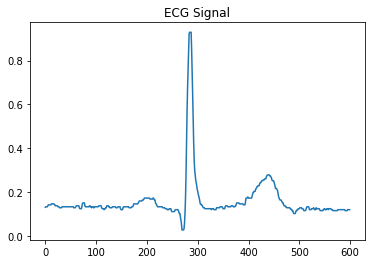

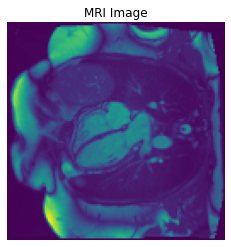

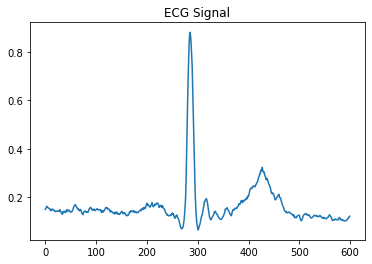


-------------------    Plot of Signal:   48    -------------------



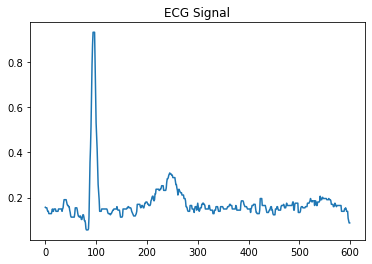

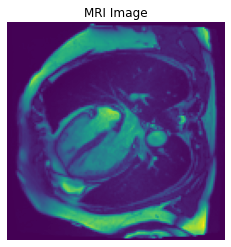

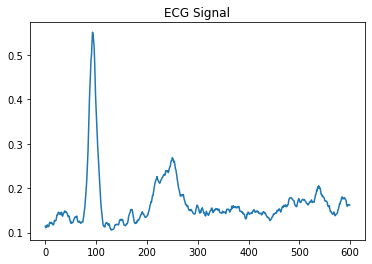


-------------------    Plot of Signal:   49    -------------------



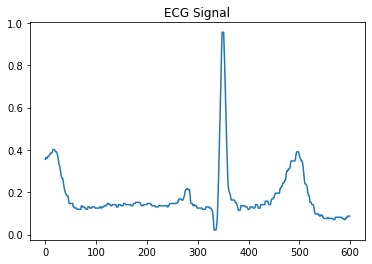

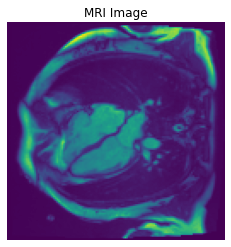

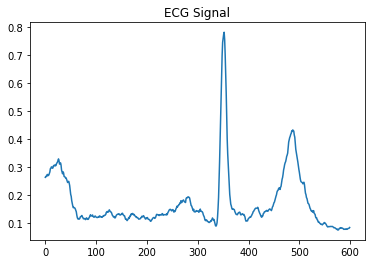


-------------------    Plot of Signal:   50    -------------------



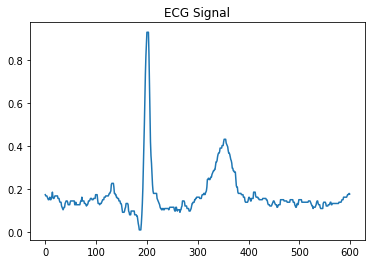

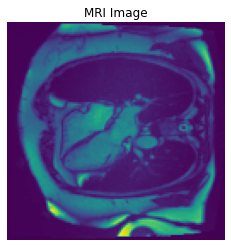

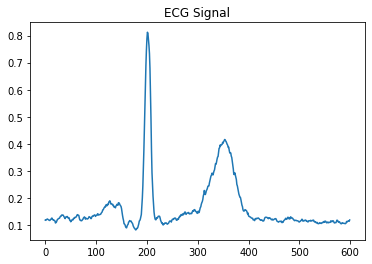


-------------------    Plot of Signal:   51    -------------------



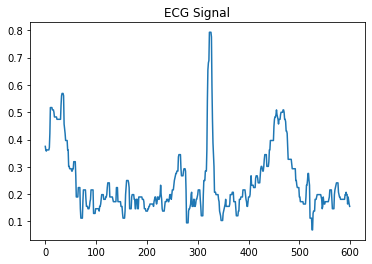

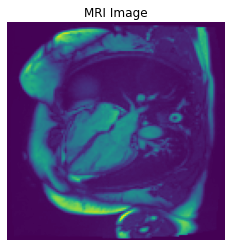

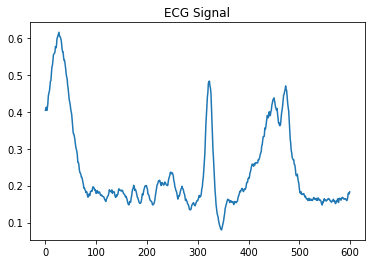


-------------------    Plot of Signal:   52    -------------------



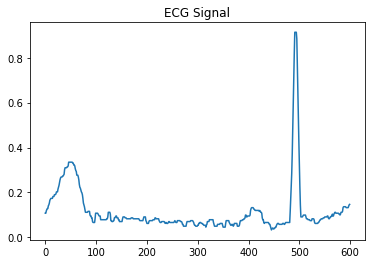

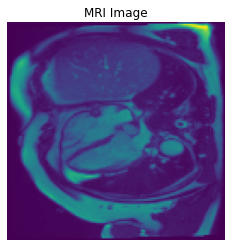

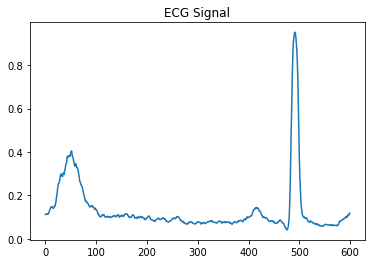


-------------------    Plot of Signal:   53    -------------------



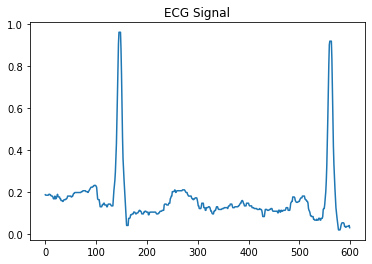

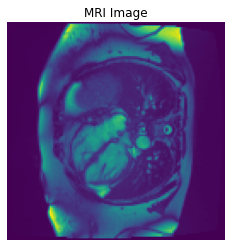

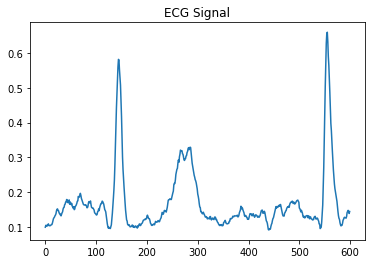


-------------------    Plot of Signal:   54    -------------------



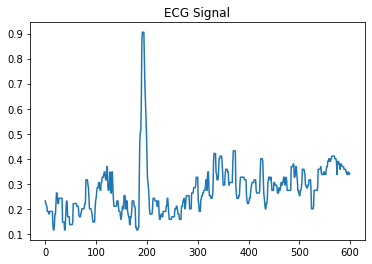

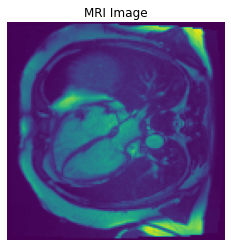

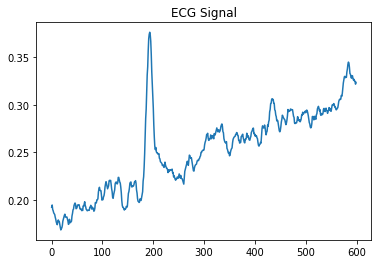


-------------------    Plot of Signal:   55    -------------------



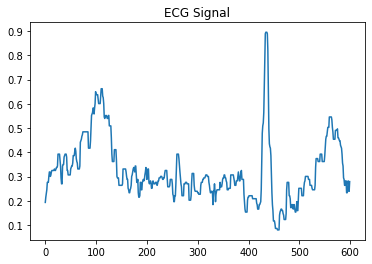

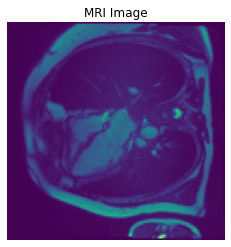

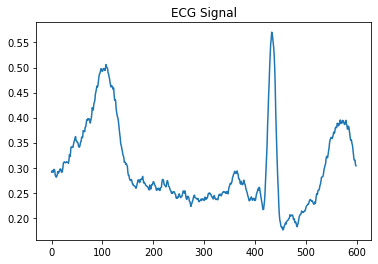


-------------------    Plot of Signal:   56    -------------------



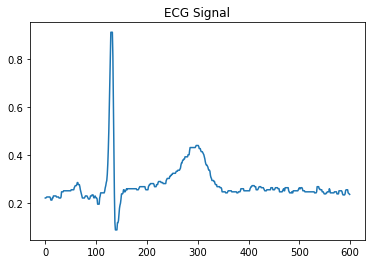

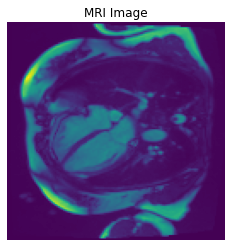

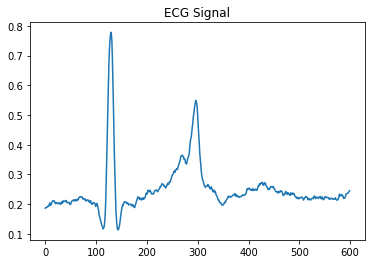


-------------------    Plot of Signal:   57    -------------------



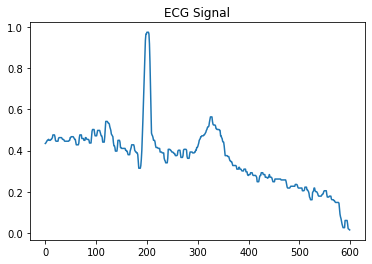

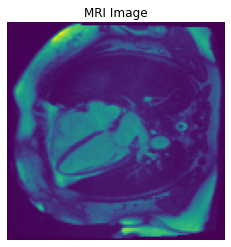

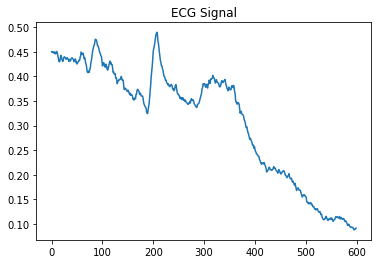


-------------------    Plot of Signal:   58    -------------------



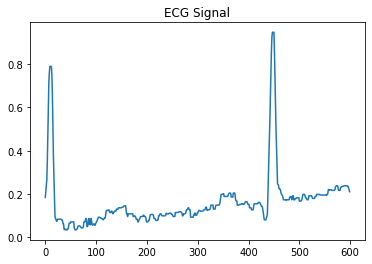

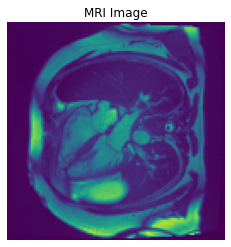

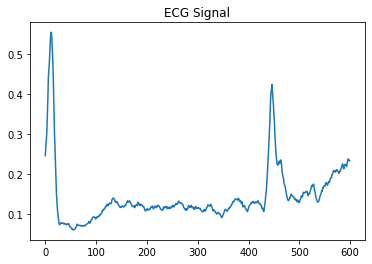


-------------------    Plot of Signal:   59    -------------------



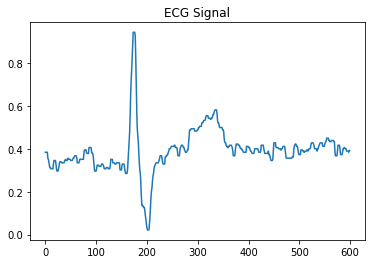

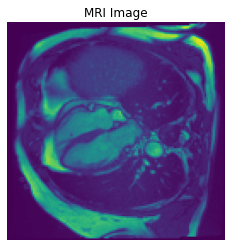

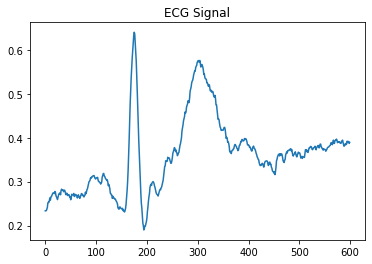


-------------------    Plot of Signal:   60    -------------------



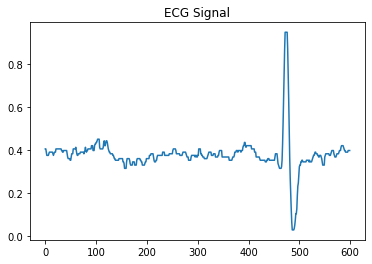

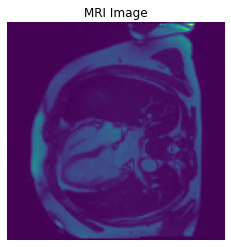

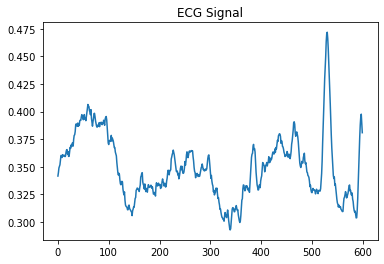


-------------------    Plot of Signal:   61    -------------------



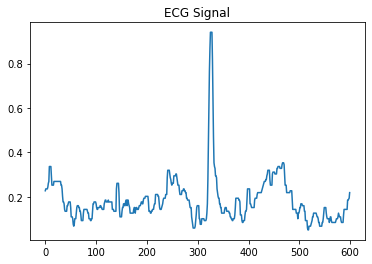

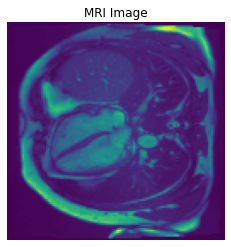

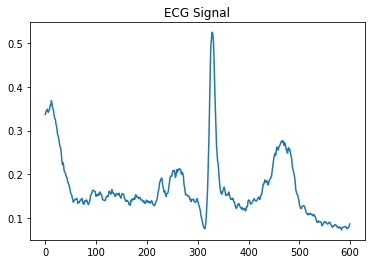


-------------------    Plot of Signal:   62    -------------------



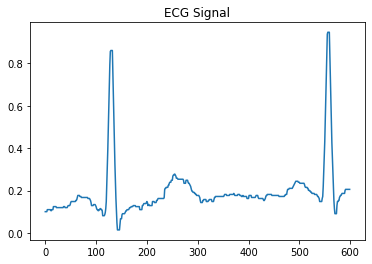

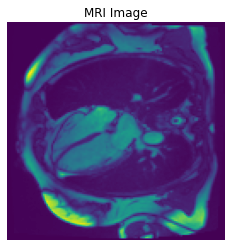

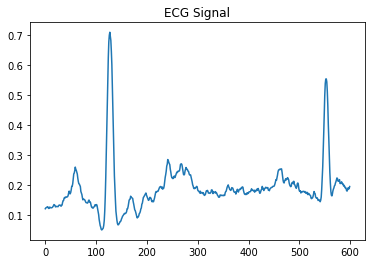


-------------------    Plot of Signal:   63    -------------------



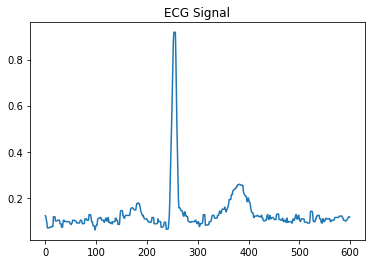

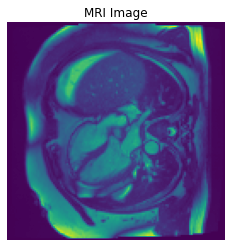

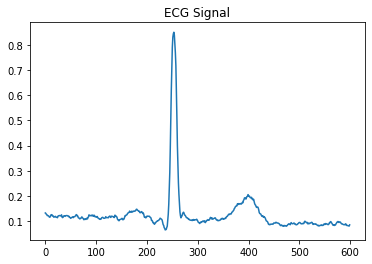


-------------------    Plot of Signal:   0    -------------------



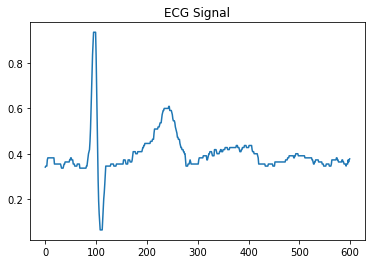

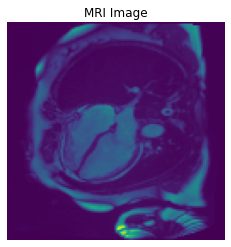

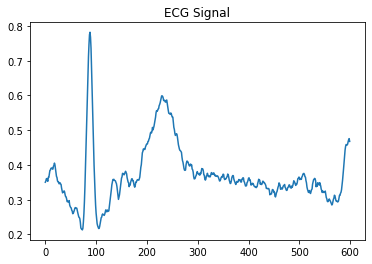


-------------------    Plot of Signal:   1    -------------------



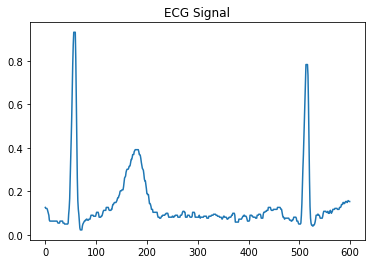

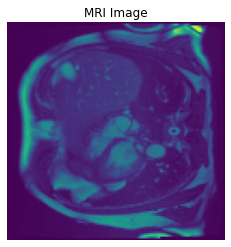

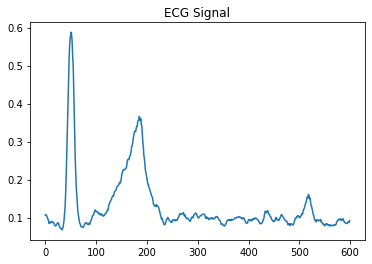


-------------------    Plot of Signal:   2    -------------------



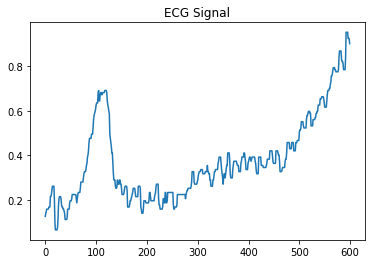

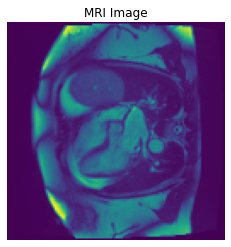

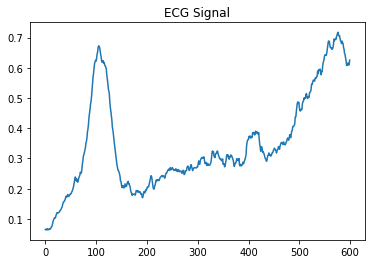


-------------------    Plot of Signal:   3    -------------------



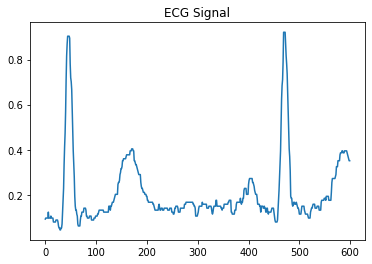

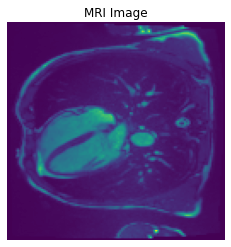

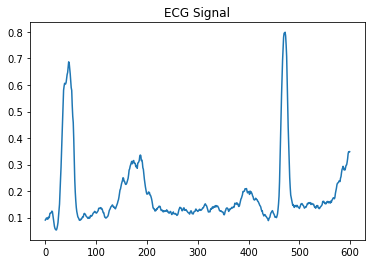


-------------------    Plot of Signal:   4    -------------------



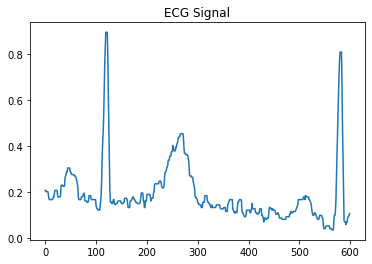

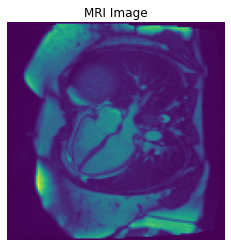

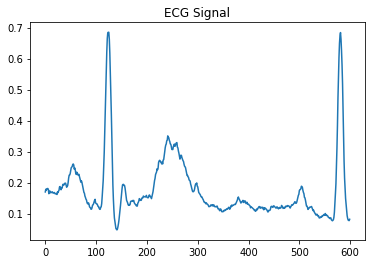


-------------------    Plot of Signal:   5    -------------------



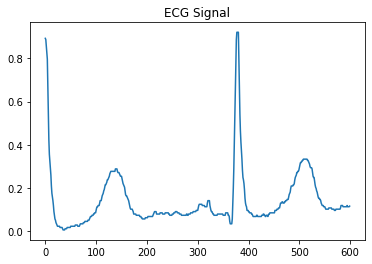

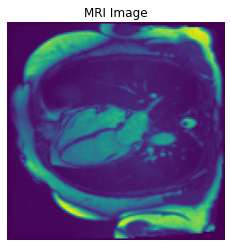

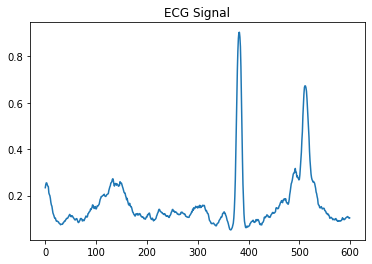


-------------------    Plot of Signal:   6    -------------------



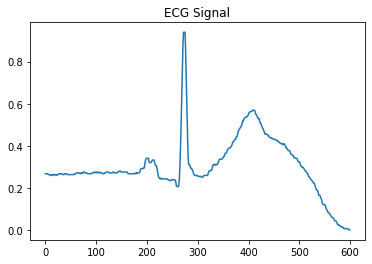

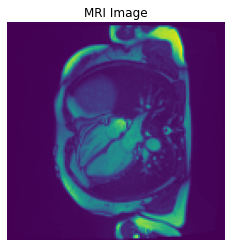

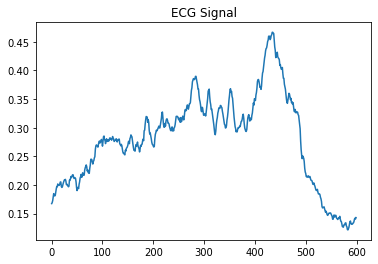


-------------------    Plot of Signal:   7    -------------------



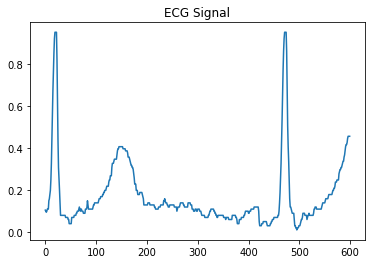

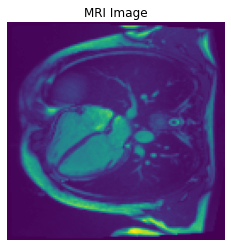

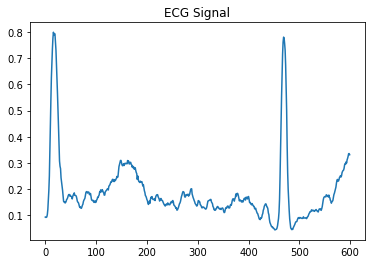


-------------------    Plot of Signal:   8    -------------------



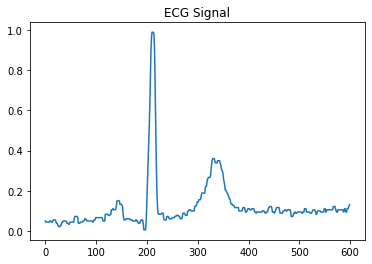

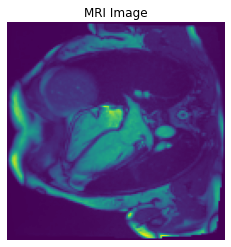

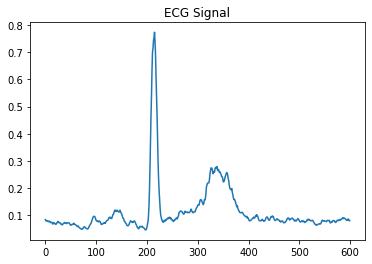


-------------------    Plot of Signal:   9    -------------------



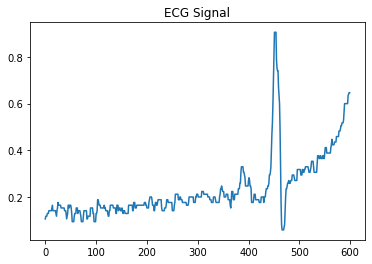

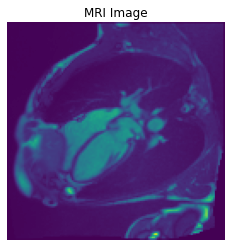

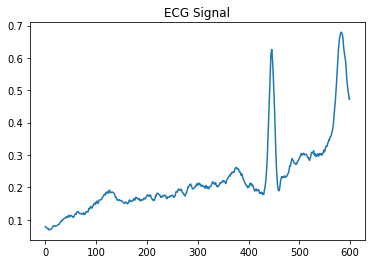


-------------------    Plot of Signal:   10    -------------------



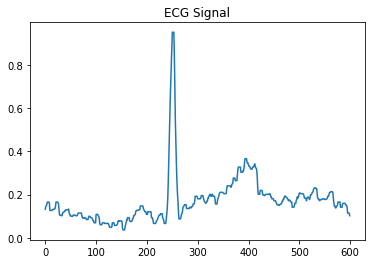

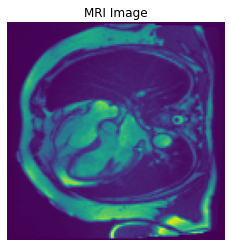

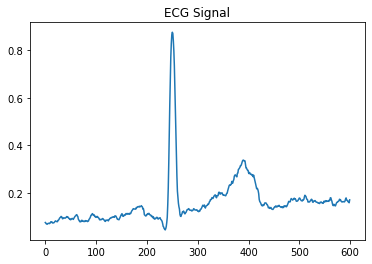


-------------------    Plot of Signal:   11    -------------------



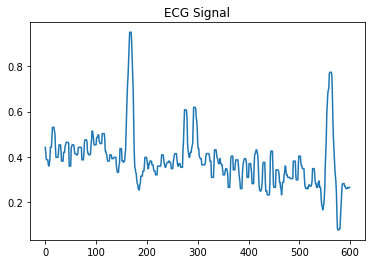

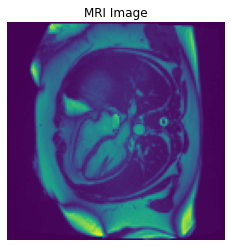

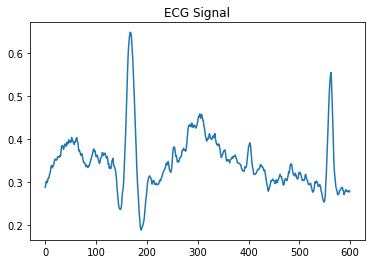


-------------------    Plot of Signal:   12    -------------------



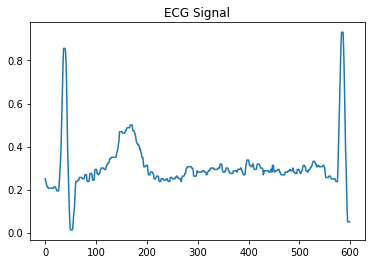

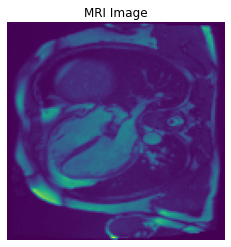

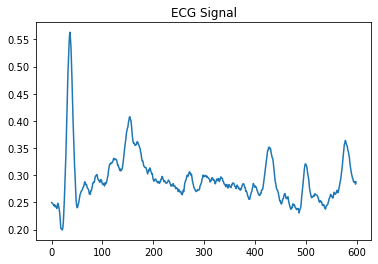


-------------------    Plot of Signal:   13    -------------------



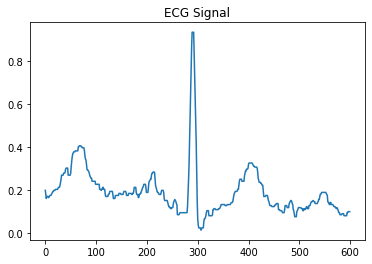

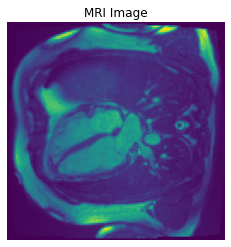

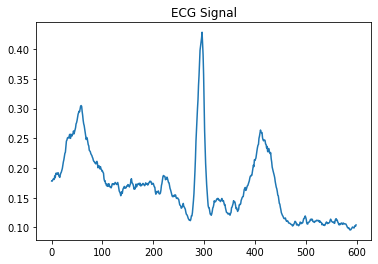


-------------------    Plot of Signal:   14    -------------------



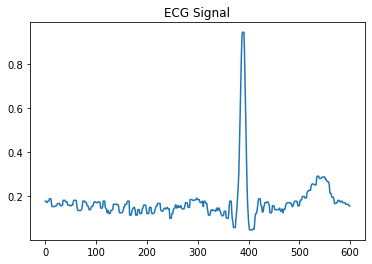

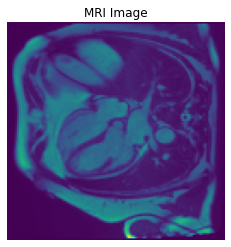

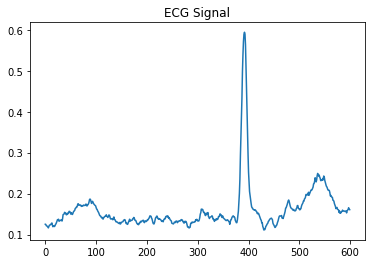


-------------------    Plot of Signal:   15    -------------------



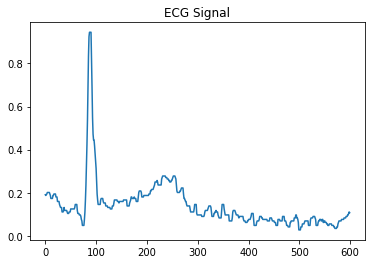

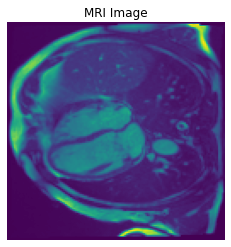

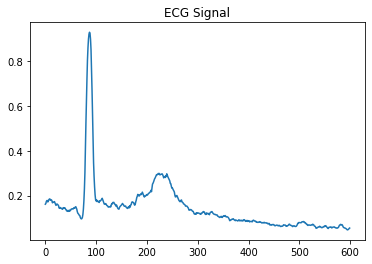


-------------------    Plot of Signal:   16    -------------------



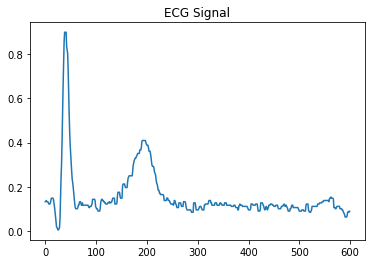

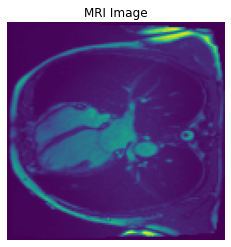

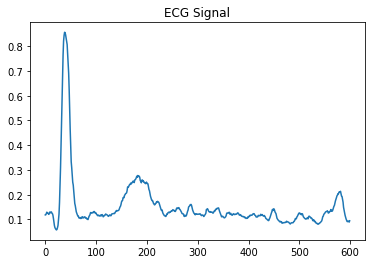


-------------------    Plot of Signal:   17    -------------------



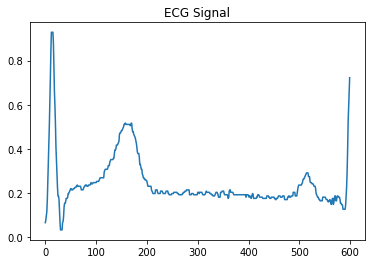

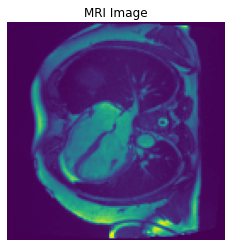

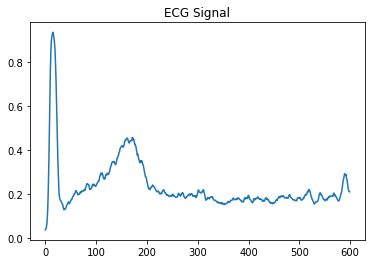


-------------------    Plot of Signal:   18    -------------------



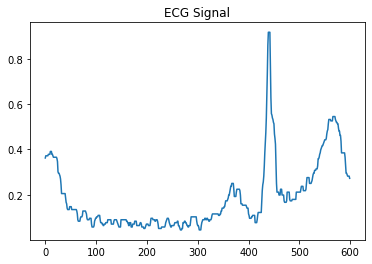

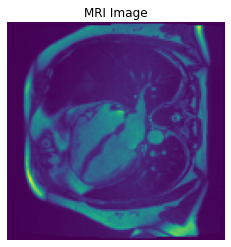

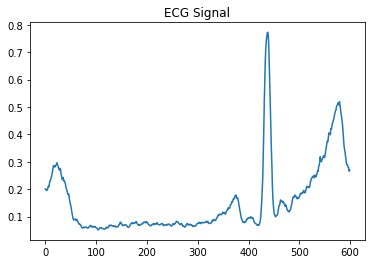


-------------------    Plot of Signal:   19    -------------------



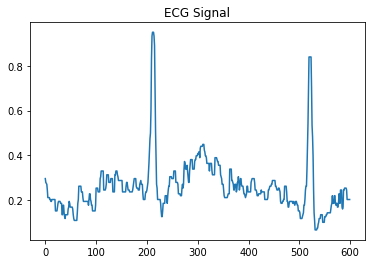

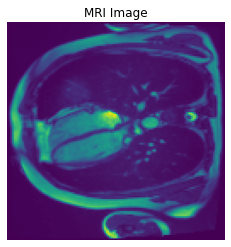

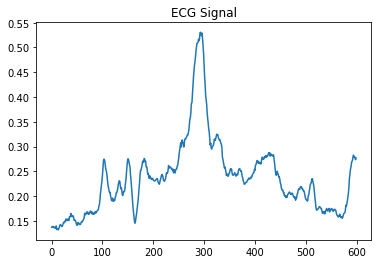


-------------------    Plot of Signal:   20    -------------------



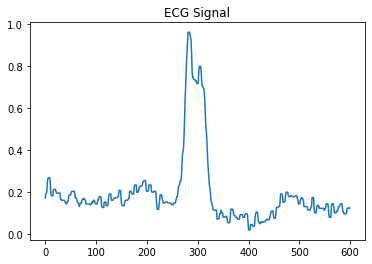

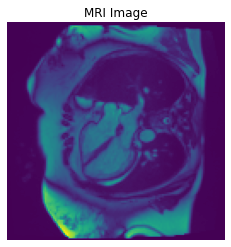

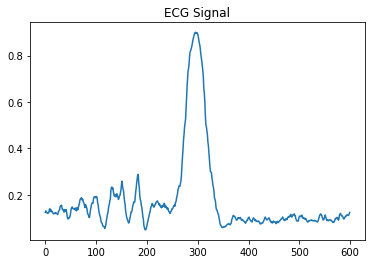


-------------------    Plot of Signal:   21    -------------------



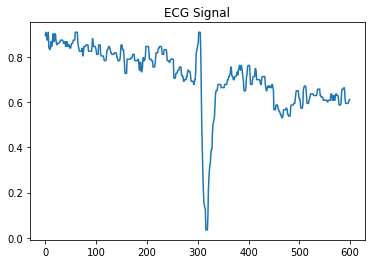

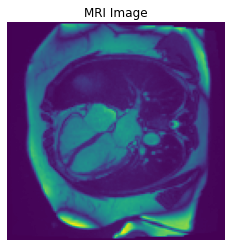

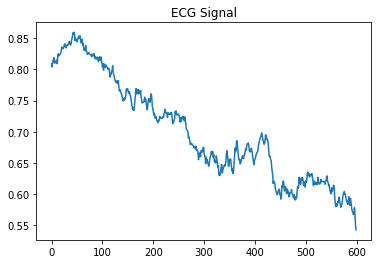


-------------------    Plot of Signal:   22    -------------------



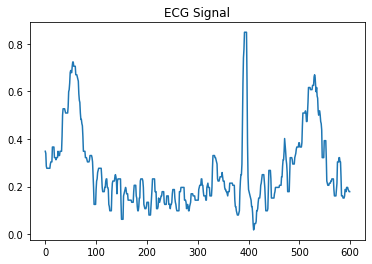

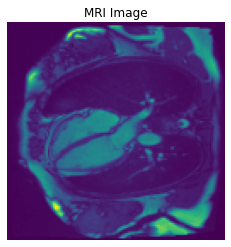

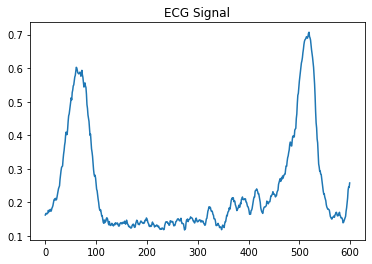


-------------------    Plot of Signal:   23    -------------------



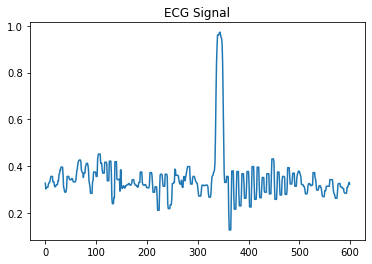

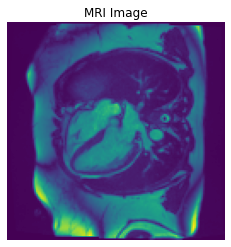

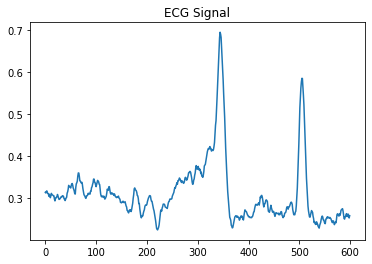


-------------------    Plot of Signal:   24    -------------------



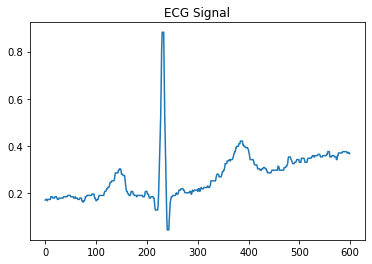

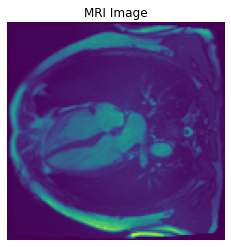

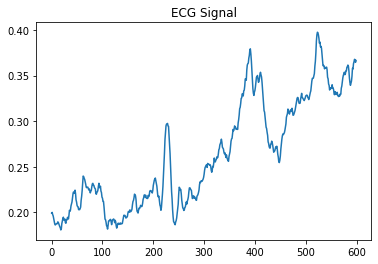


-------------------    Plot of Signal:   25    -------------------



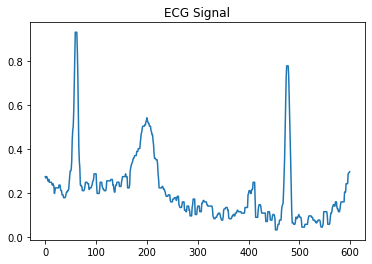

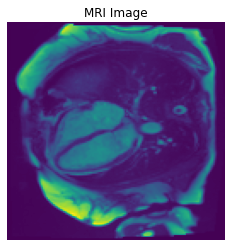

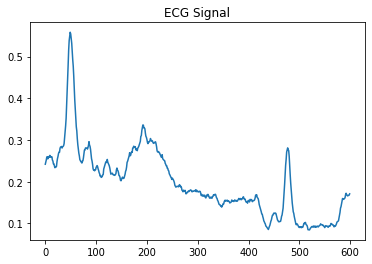


-------------------    Plot of Signal:   26    -------------------



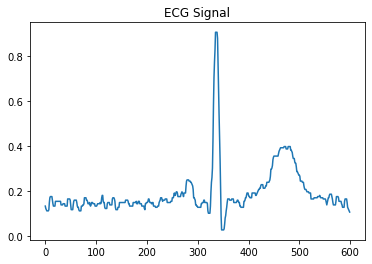

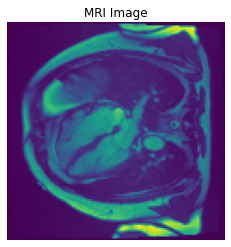

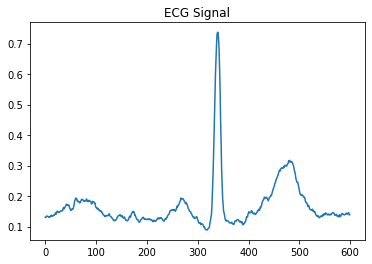


-------------------    Plot of Signal:   27    -------------------



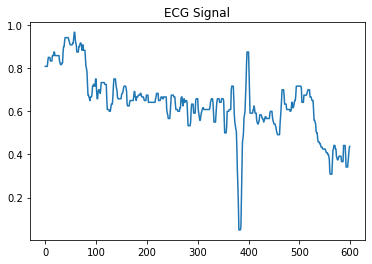

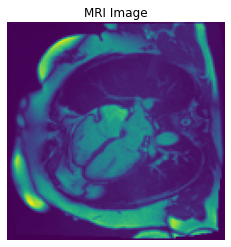

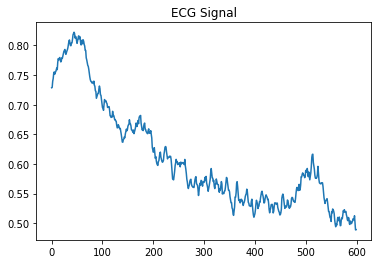


-------------------    Plot of Signal:   28    -------------------



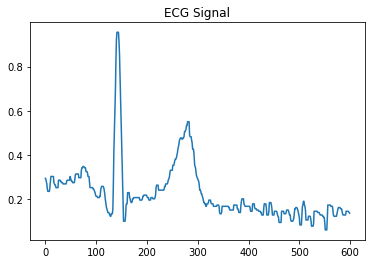

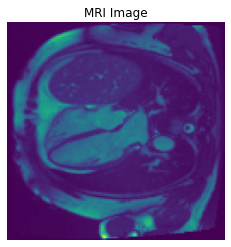

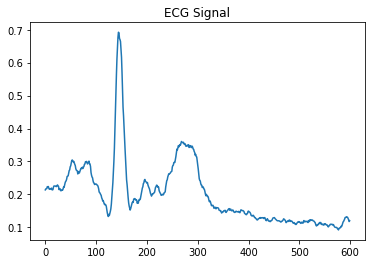


-------------------    Plot of Signal:   29    -------------------



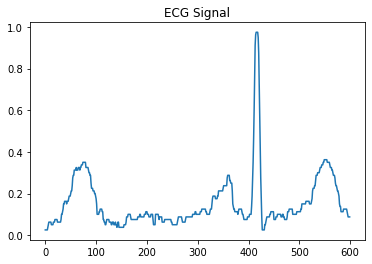

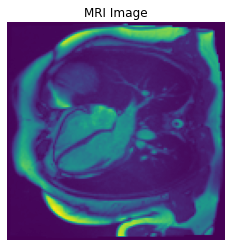

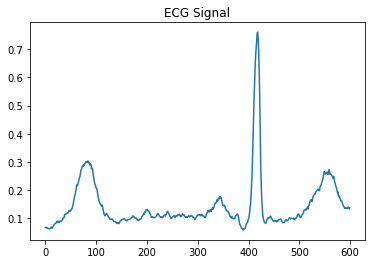


-------------------    Plot of Signal:   30    -------------------



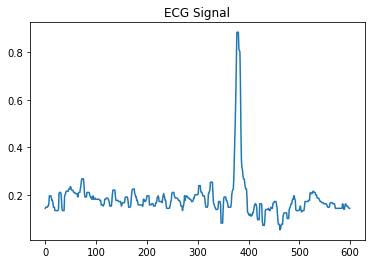

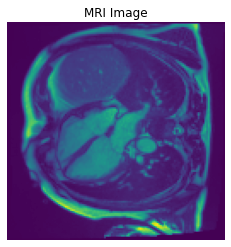

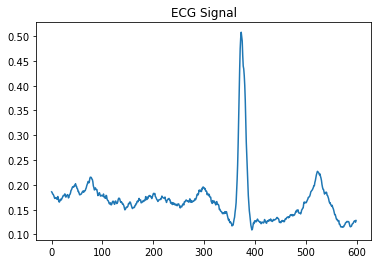


-------------------    Plot of Signal:   31    -------------------



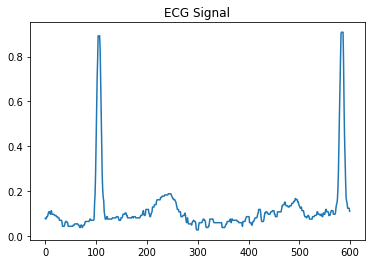

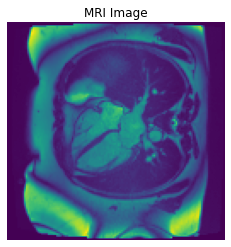

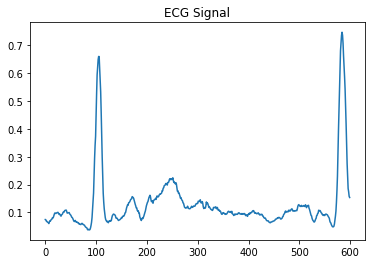


-------------------    Plot of Signal:   32    -------------------



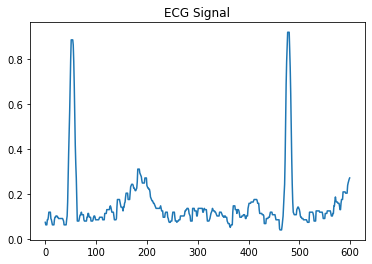

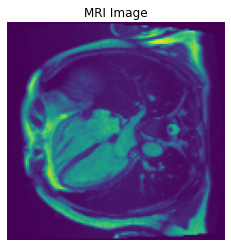

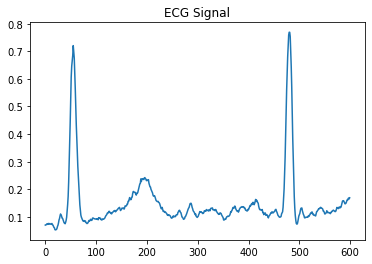


-------------------    Plot of Signal:   33    -------------------



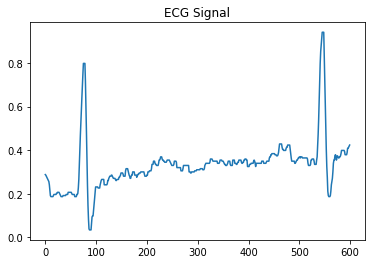

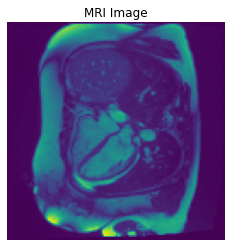

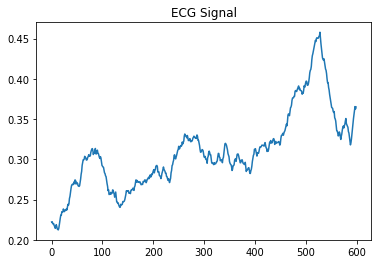


-------------------    Plot of Signal:   34    -------------------



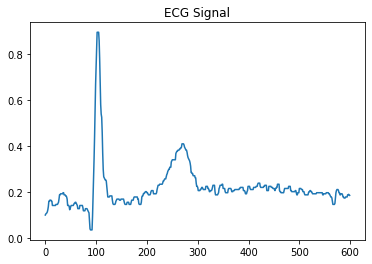

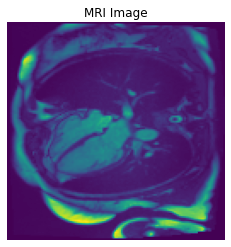

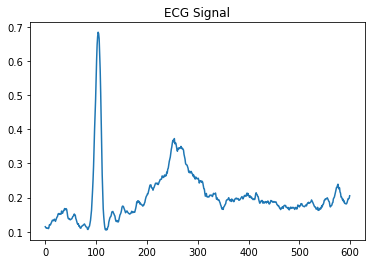


-------------------    Plot of Signal:   35    -------------------



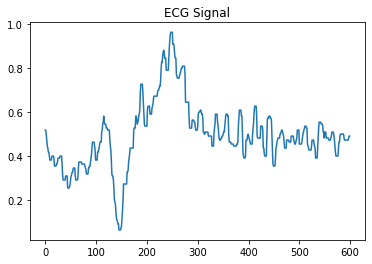

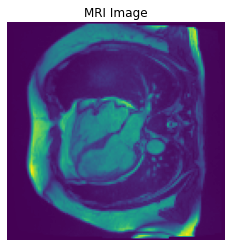

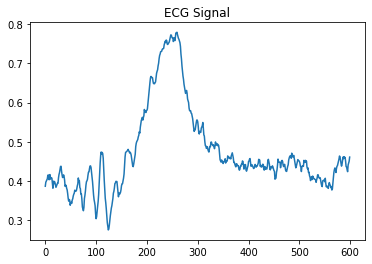


-------------------    Plot of Signal:   36    -------------------



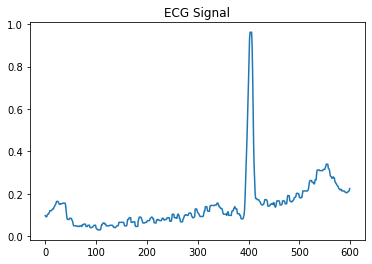

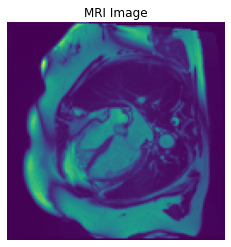

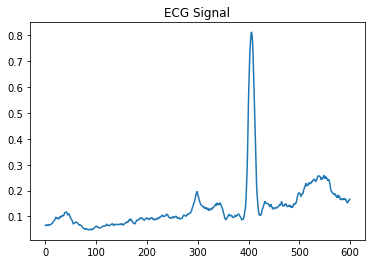


-------------------    Plot of Signal:   37    -------------------



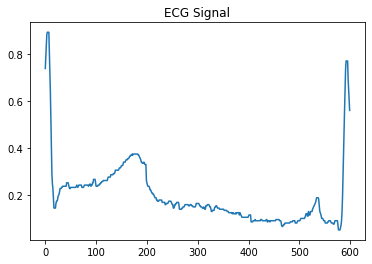

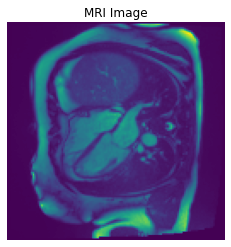

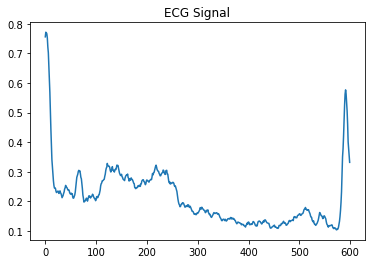


-------------------    Plot of Signal:   38    -------------------



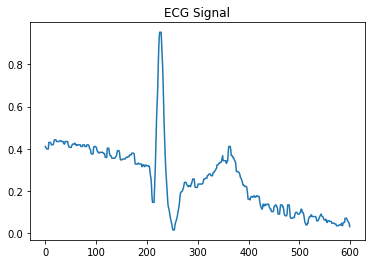

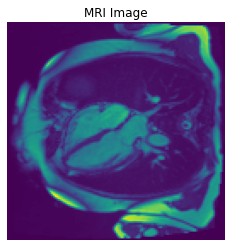

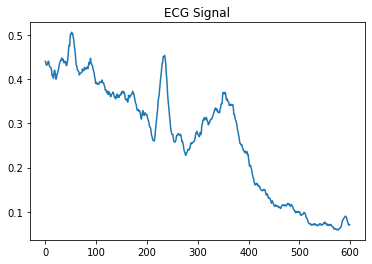


-------------------    Plot of Signal:   39    -------------------



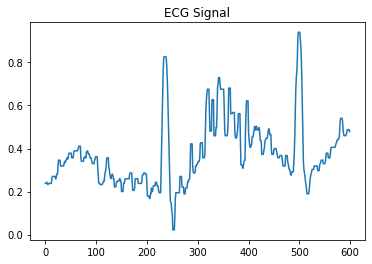

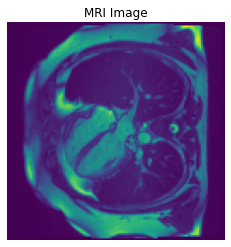

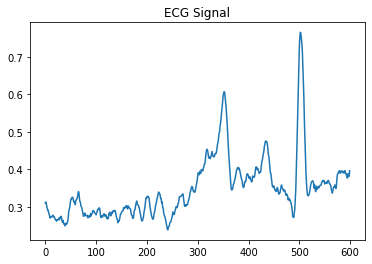


-------------------    Plot of Signal:   40    -------------------



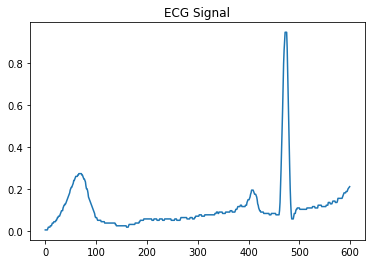

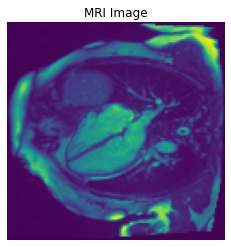

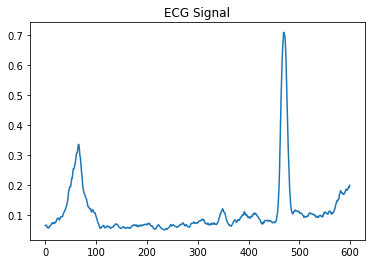


-------------------    Plot of Signal:   41    -------------------



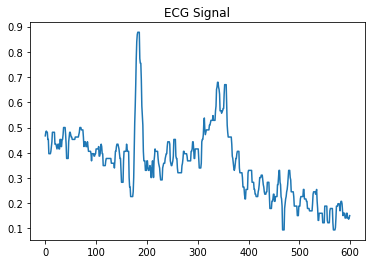

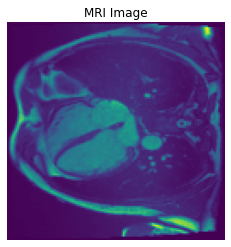

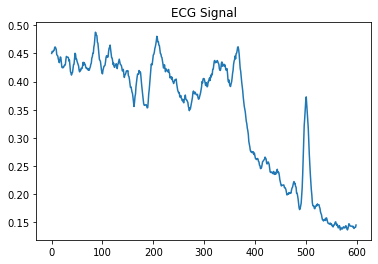


-------------------    Plot of Signal:   42    -------------------



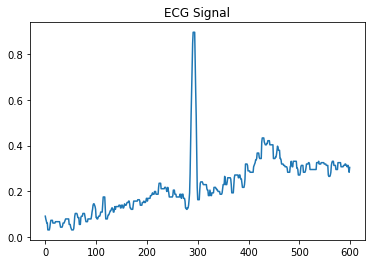

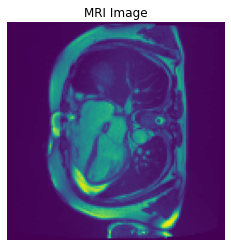

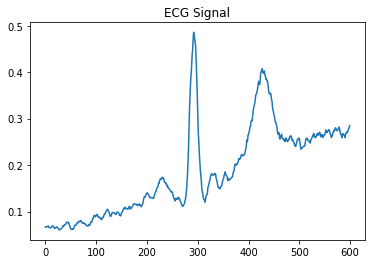


-------------------    Plot of Signal:   43    -------------------



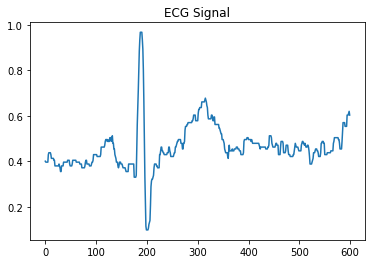

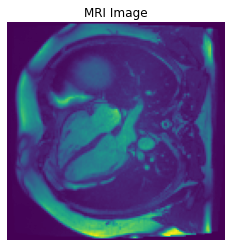

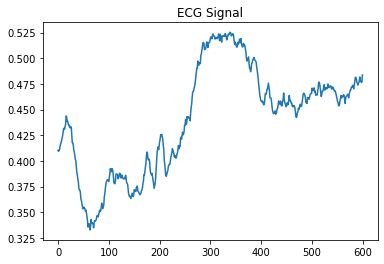


-------------------    Plot of Signal:   44    -------------------



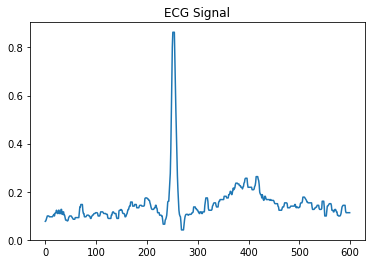

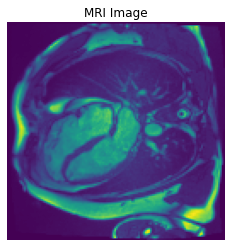

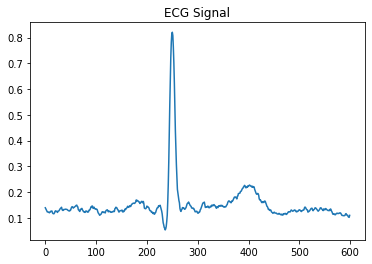


-------------------    Plot of Signal:   45    -------------------



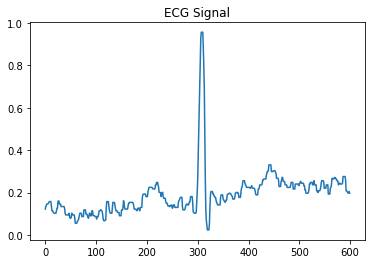

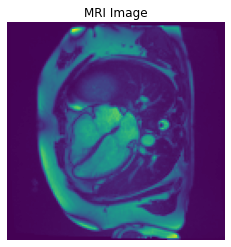

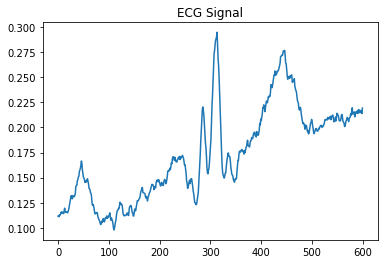


-------------------    Plot of Signal:   46    -------------------



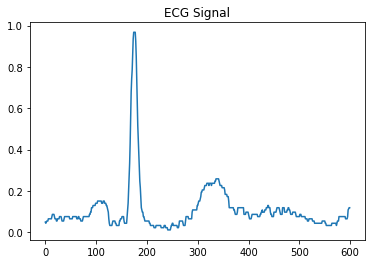

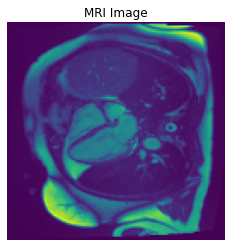

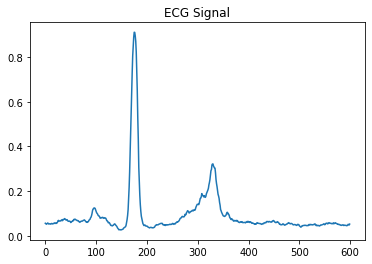


-------------------    Plot of Signal:   47    -------------------



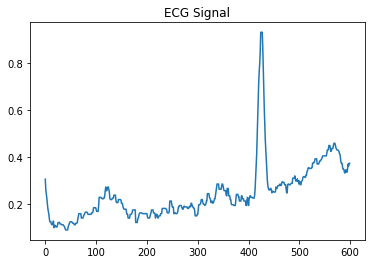

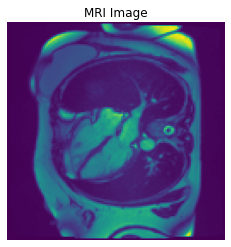

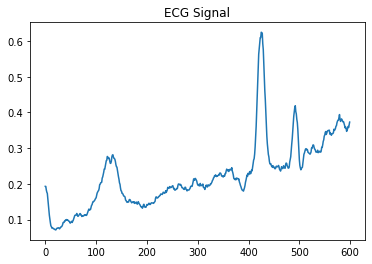


-------------------    Plot of Signal:   48    -------------------



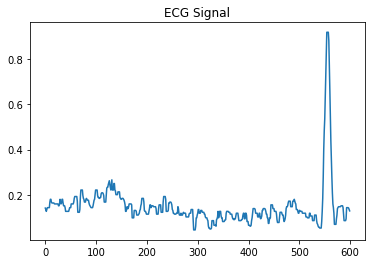

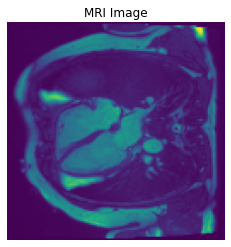

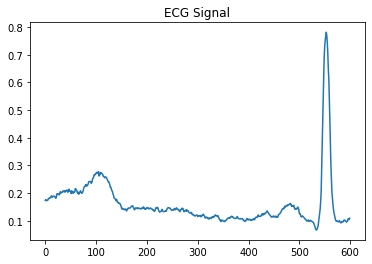


-------------------    Plot of Signal:   49    -------------------



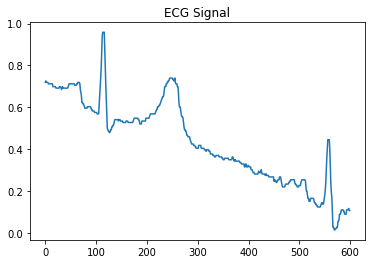

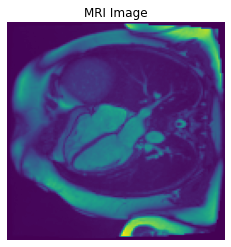

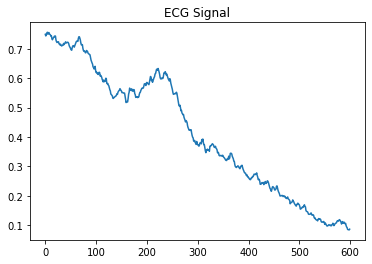


-------------------    Plot of Signal:   50    -------------------



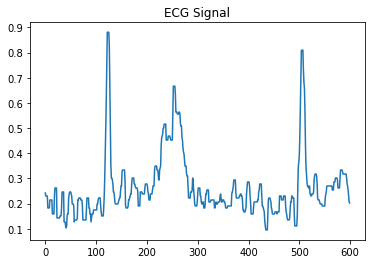

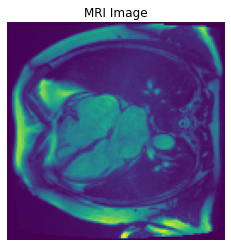

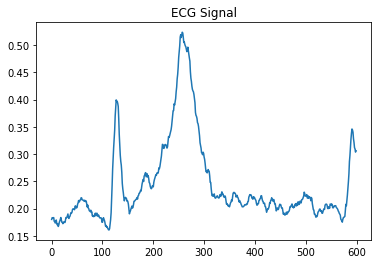


-------------------    Plot of Signal:   51    -------------------



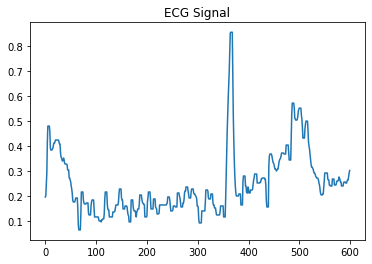

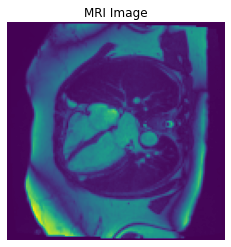

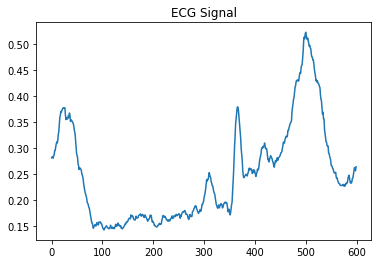


-------------------    Plot of Signal:   52    -------------------



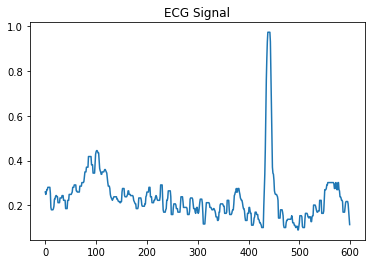

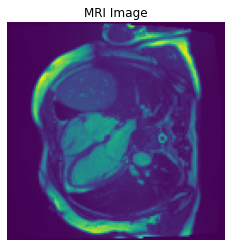

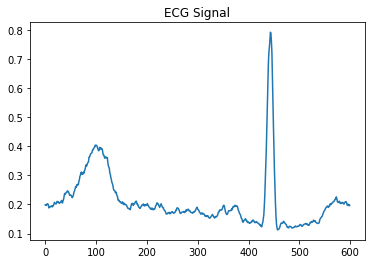


-------------------    Plot of Signal:   53    -------------------



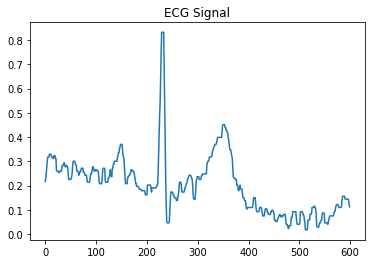

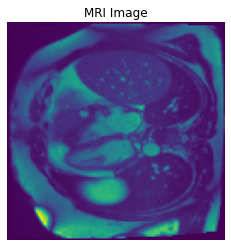

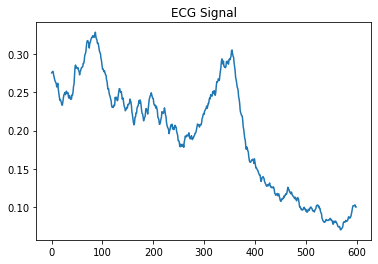


-------------------    Plot of Signal:   54    -------------------



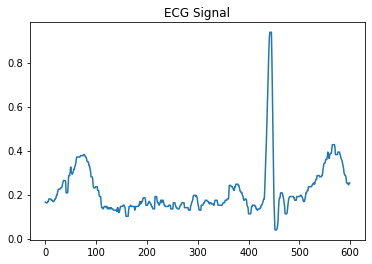

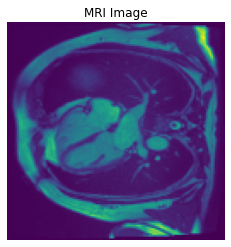

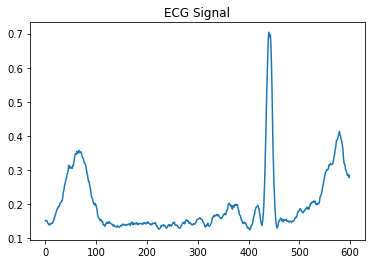


-------------------    Plot of Signal:   55    -------------------



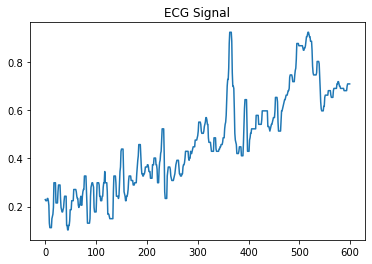

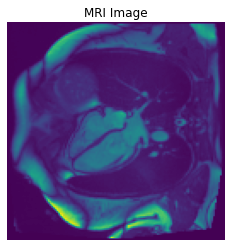

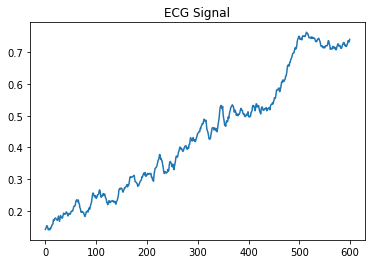


-------------------    Plot of Signal:   56    -------------------



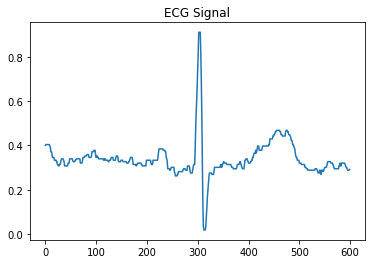

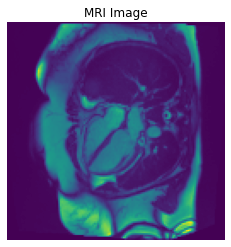

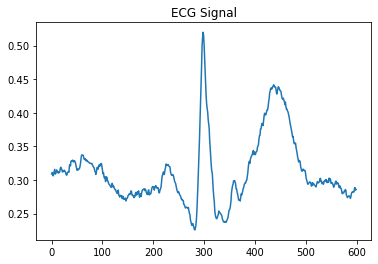


-------------------    Plot of Signal:   57    -------------------



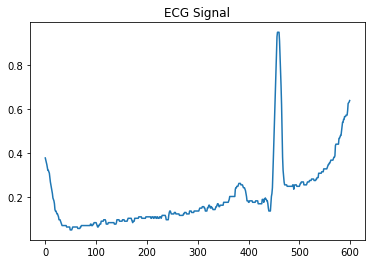

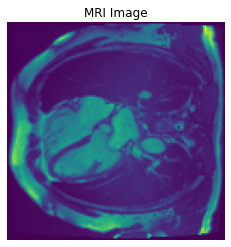

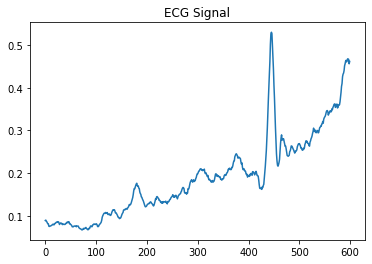


-------------------    Plot of Signal:   58    -------------------



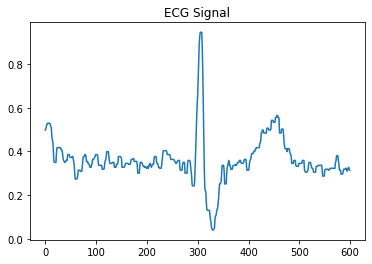

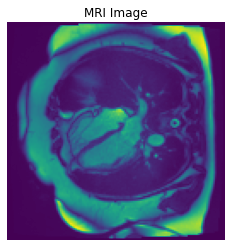

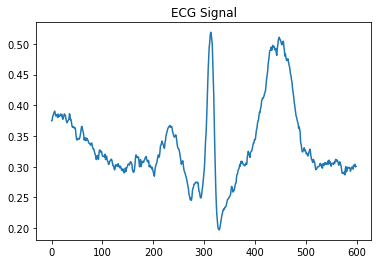


-------------------    Plot of Signal:   59    -------------------



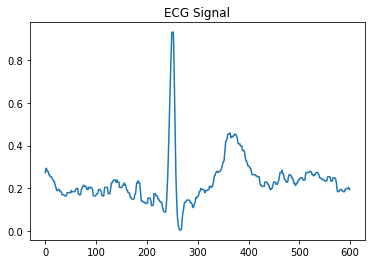

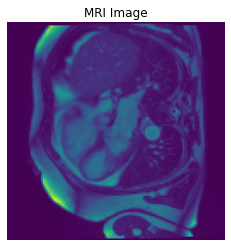

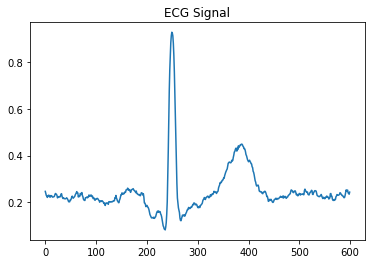


-------------------    Plot of Signal:   60    -------------------



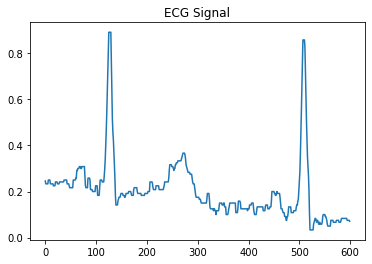

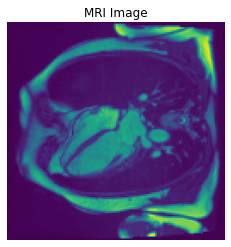

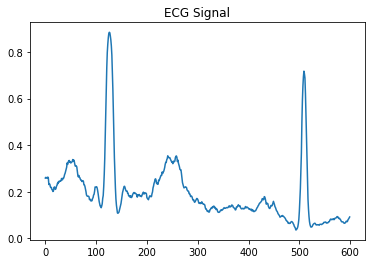


-------------------    Plot of Signal:   61    -------------------



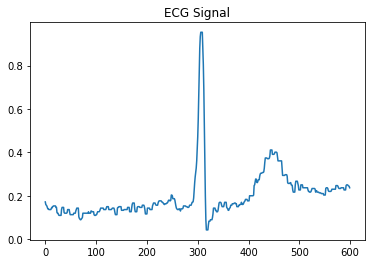

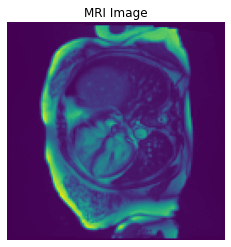

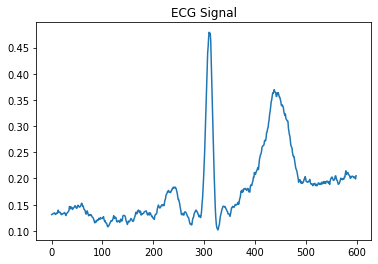


-------------------    Plot of Signal:   62    -------------------



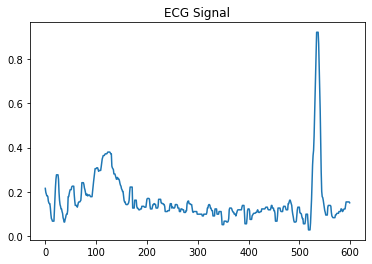

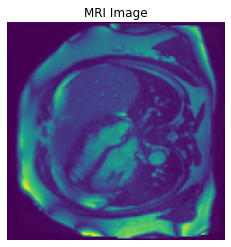

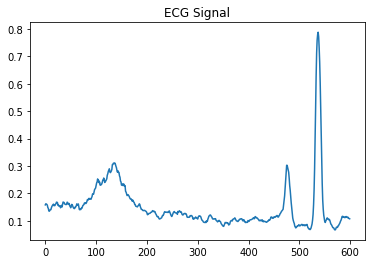


-------------------    Plot of Signal:   63    -------------------



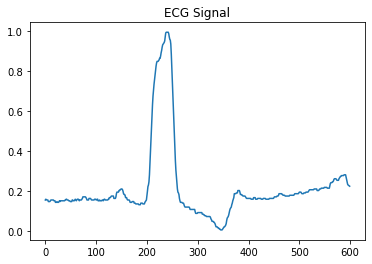

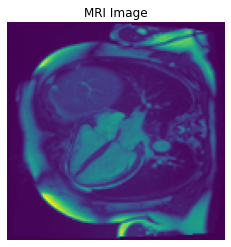

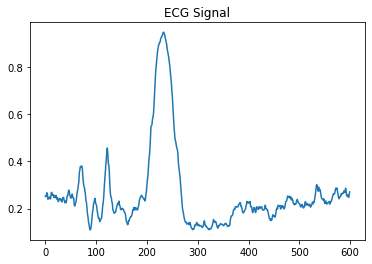


-------------------    Plot of Signal:   0    -------------------



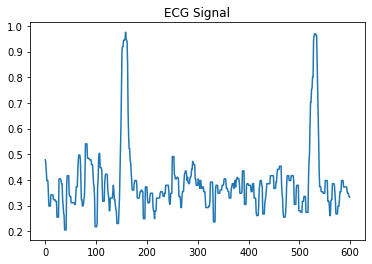

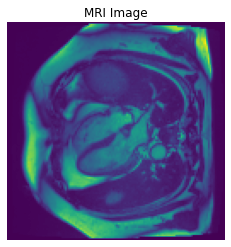

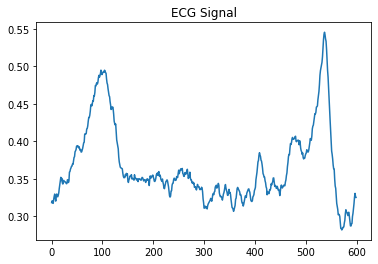


-------------------    Plot of Signal:   1    -------------------



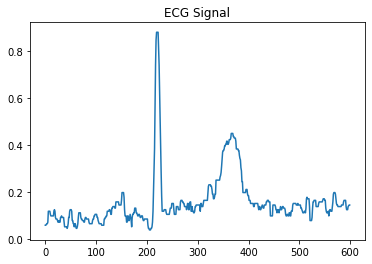

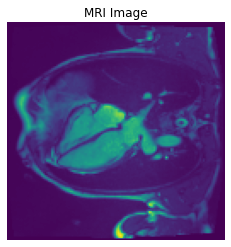

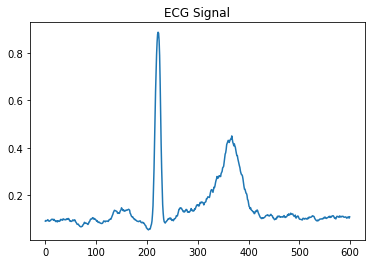


-------------------    Plot of Signal:   2    -------------------



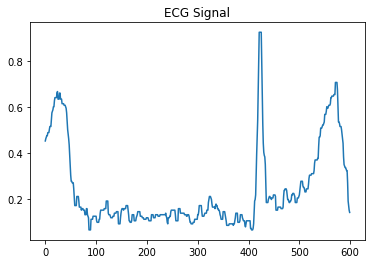

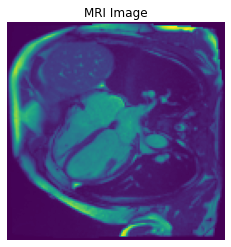

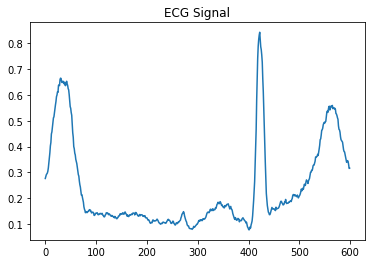


-------------------    Plot of Signal:   3    -------------------



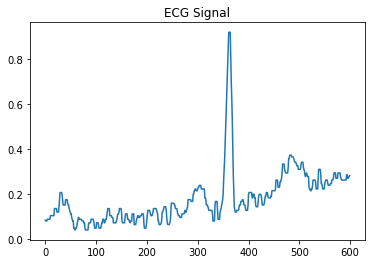

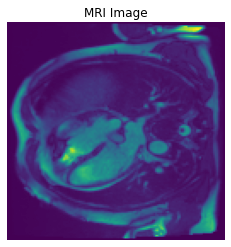

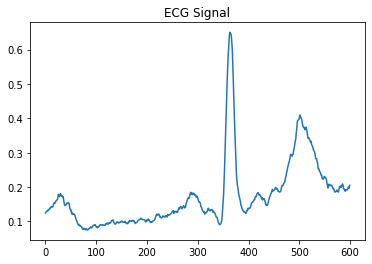


-------------------    Plot of Signal:   4    -------------------



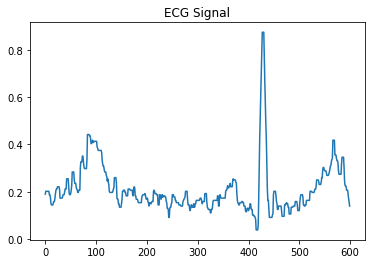

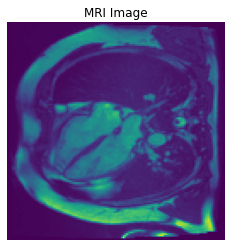

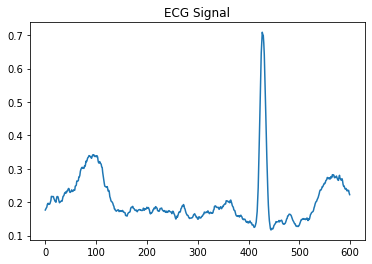


-------------------    Plot of Signal:   5    -------------------



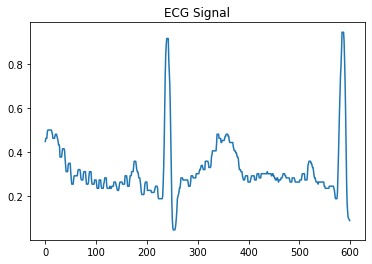

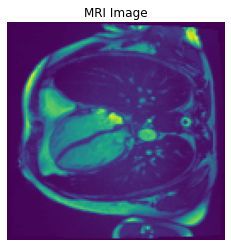

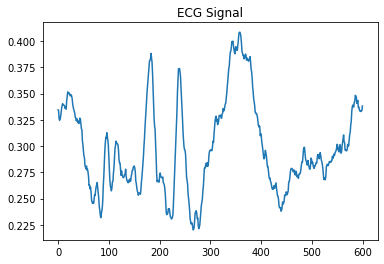


-------------------    Plot of Signal:   6    -------------------



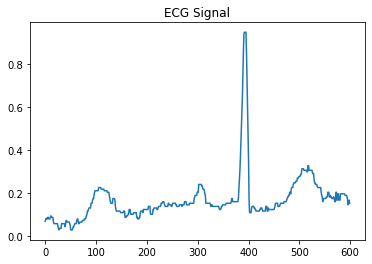

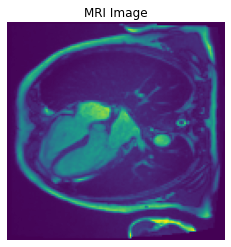

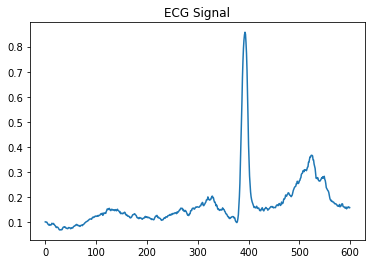


-------------------    Plot of Signal:   7    -------------------



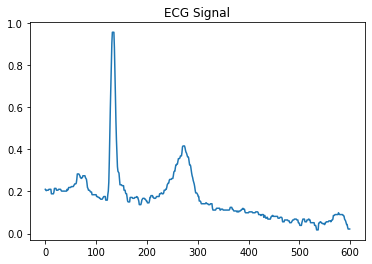

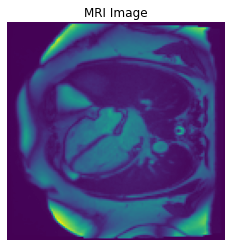

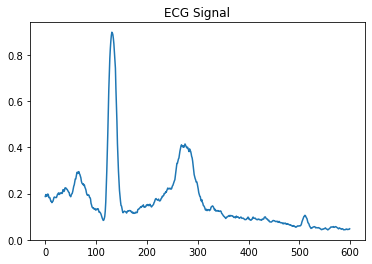


-------------------    Plot of Signal:   8    -------------------



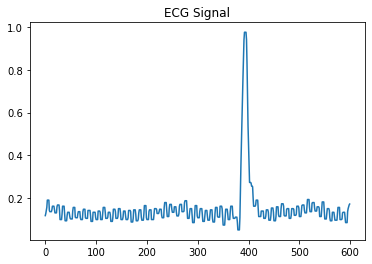

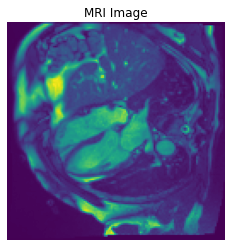

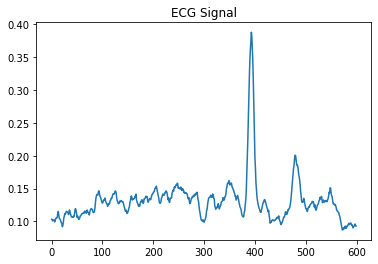


-------------------    Plot of Signal:   9    -------------------



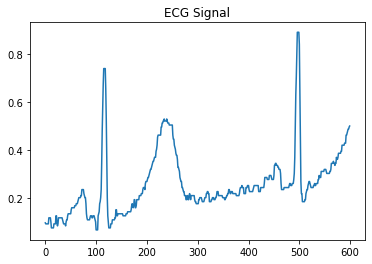

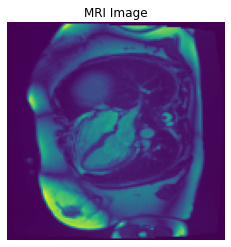

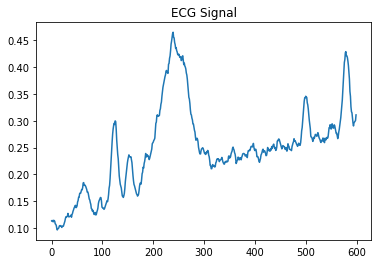


-------------------    Plot of Signal:   10    -------------------



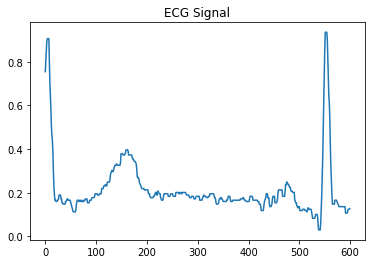

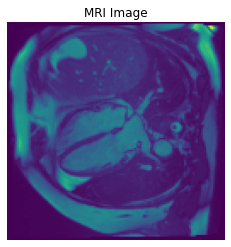

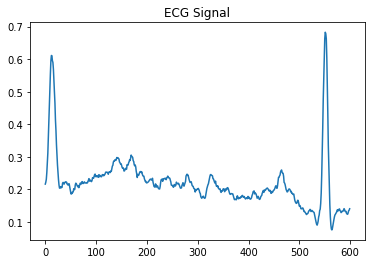


-------------------    Plot of Signal:   11    -------------------



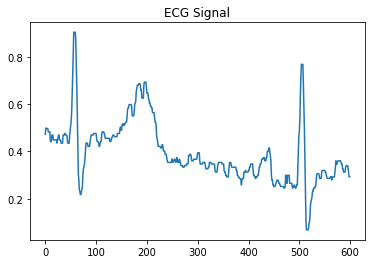

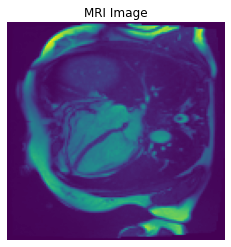

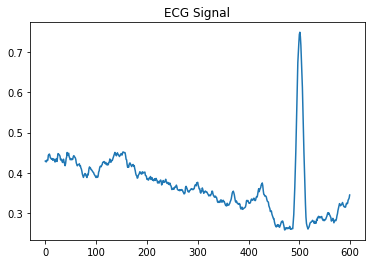


-------------------    Plot of Signal:   12    -------------------



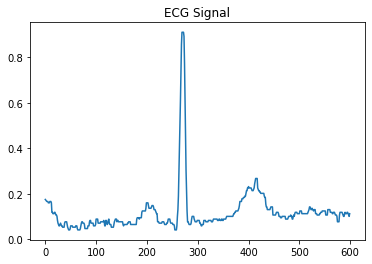

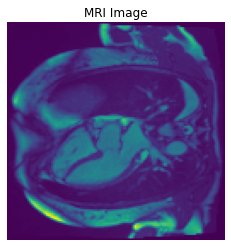

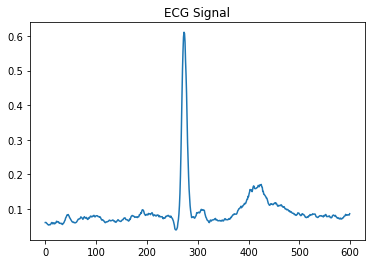


-------------------    Plot of Signal:   13    -------------------



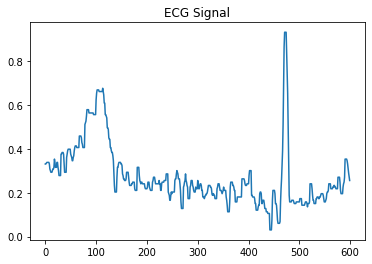

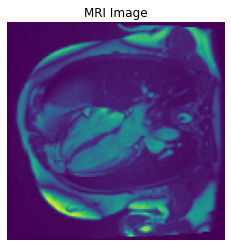

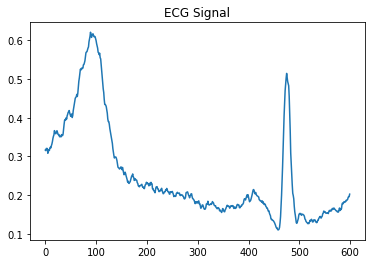


-------------------    Plot of Signal:   14    -------------------



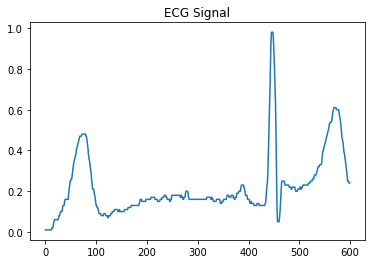

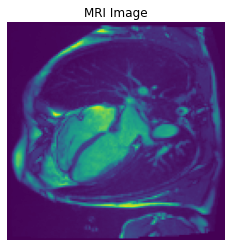

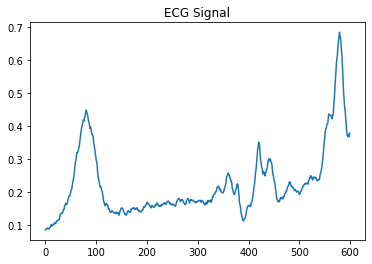


-------------------    Plot of Signal:   15    -------------------



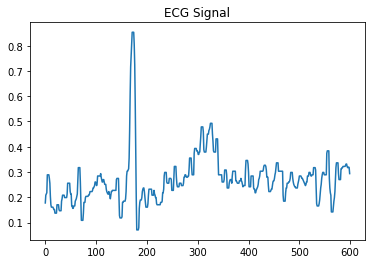

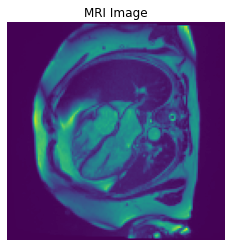

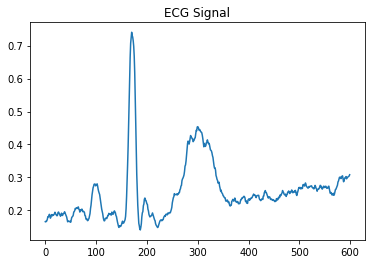


-------------------    Plot of Signal:   16    -------------------



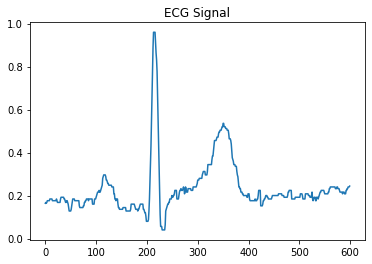

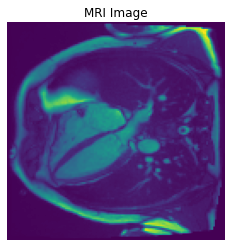

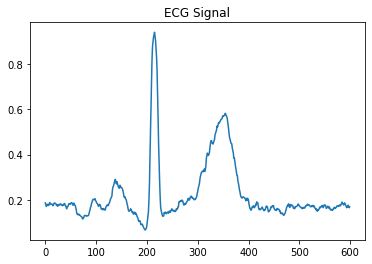


-------------------    Plot of Signal:   17    -------------------



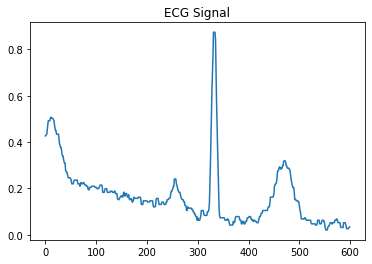

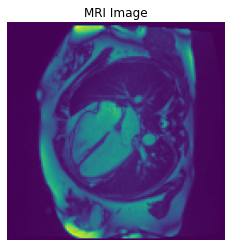

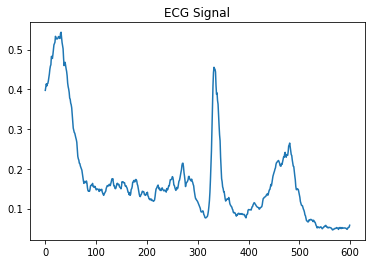


-------------------    Plot of Signal:   18    -------------------



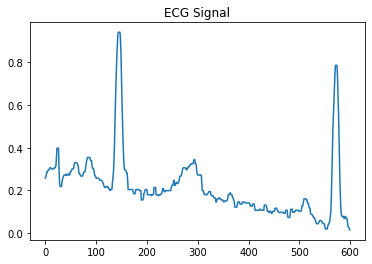

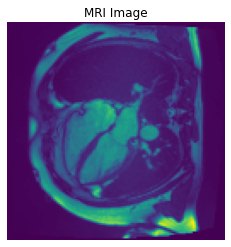

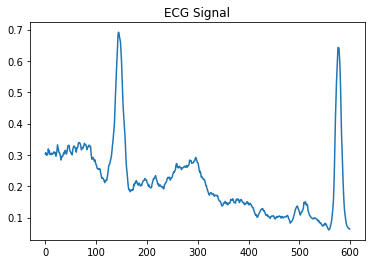


-------------------    Plot of Signal:   19    -------------------



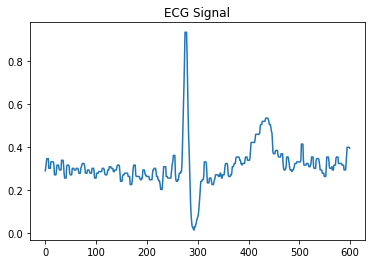

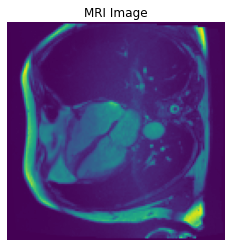

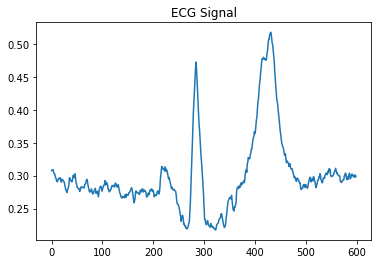


-------------------    Plot of Signal:   20    -------------------



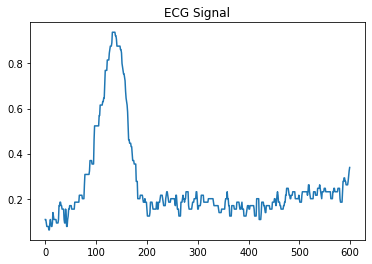

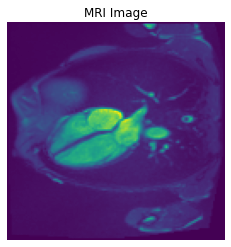

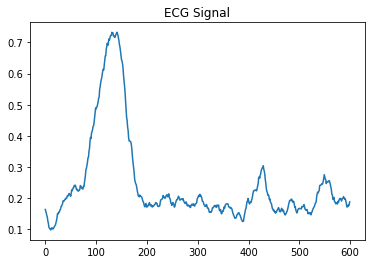


-------------------    Plot of Signal:   21    -------------------



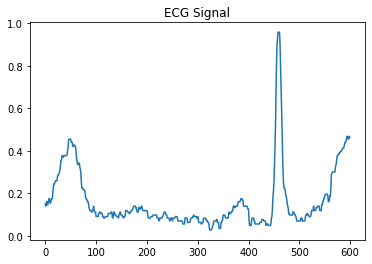

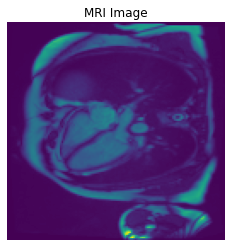

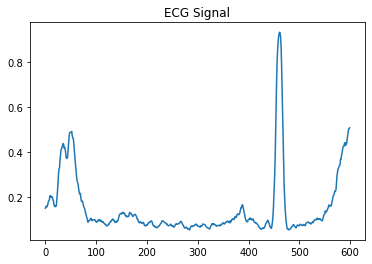


-------------------    Plot of Signal:   22    -------------------



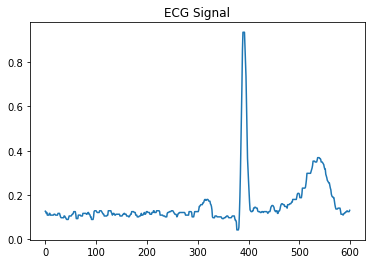

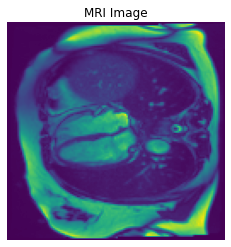

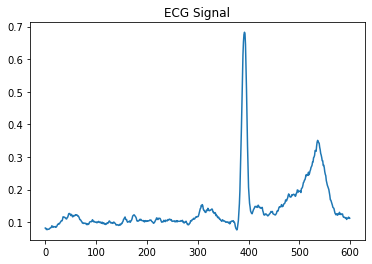


-------------------    Plot of Signal:   23    -------------------



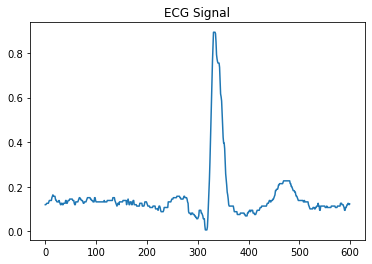

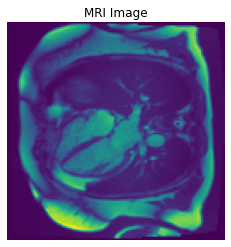

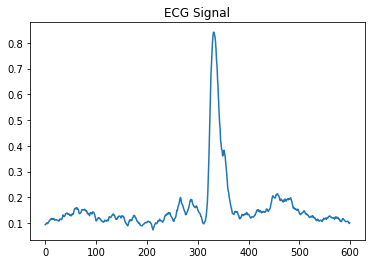


-------------------    Plot of Signal:   24    -------------------



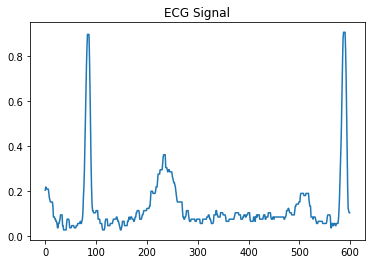

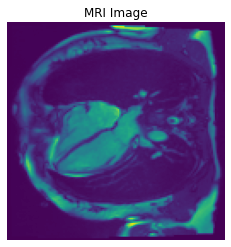

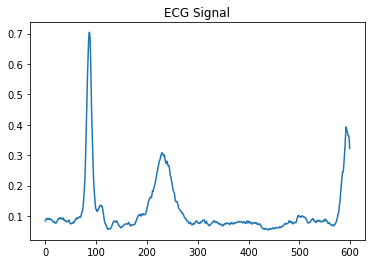


-------------------    Plot of Signal:   25    -------------------



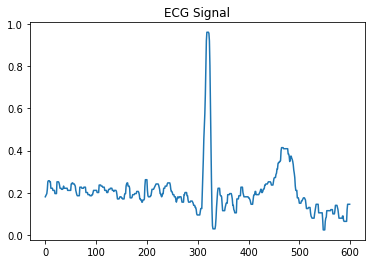

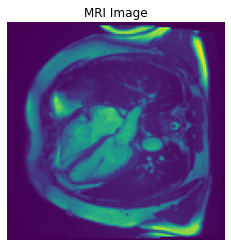

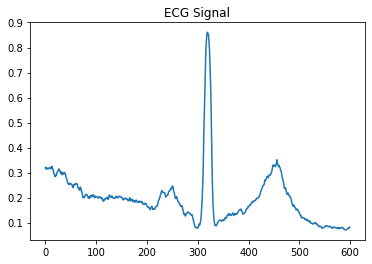


-------------------    Plot of Signal:   26    -------------------



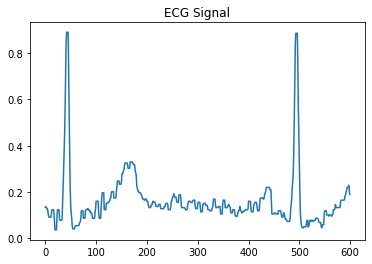

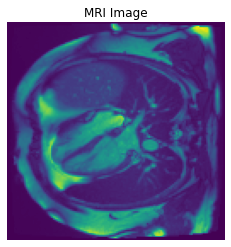

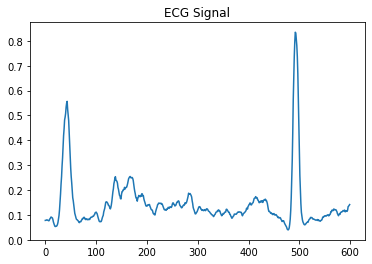


-------------------    Plot of Signal:   27    -------------------



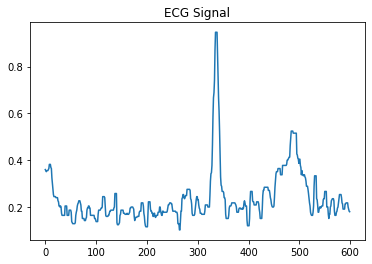

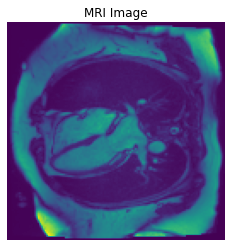

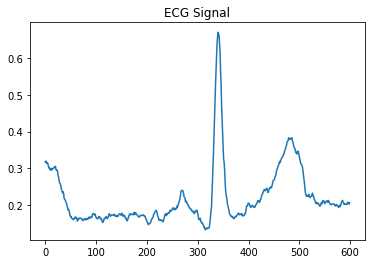


-------------------    Plot of Signal:   28    -------------------



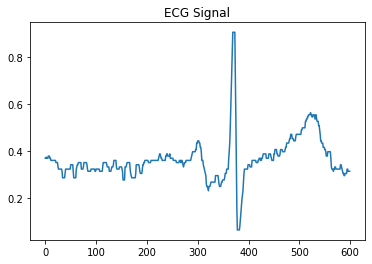

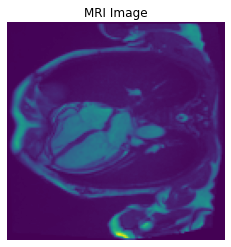

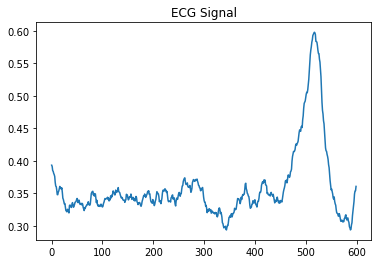


-------------------    Plot of Signal:   29    -------------------



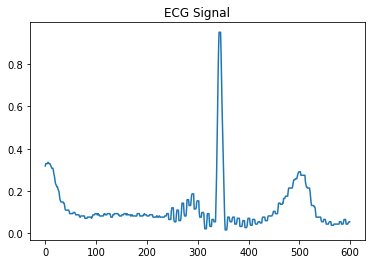

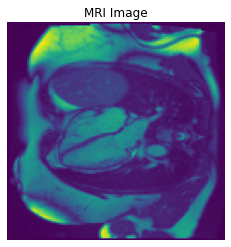

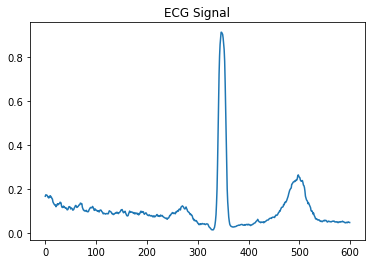


-------------------    Plot of Signal:   30    -------------------



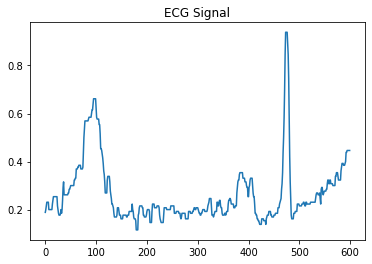

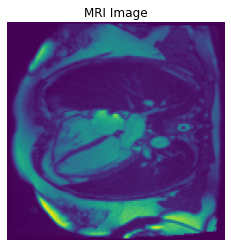

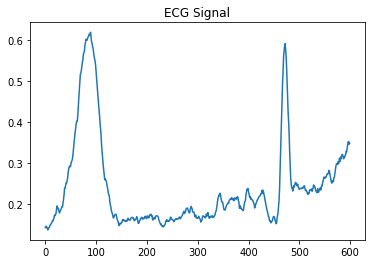


-------------------    Plot of Signal:   31    -------------------



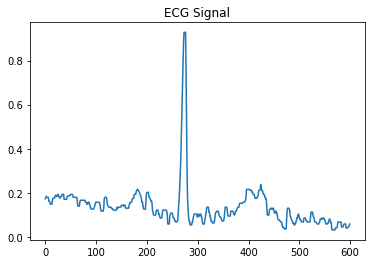

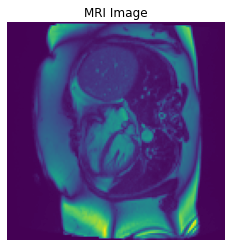

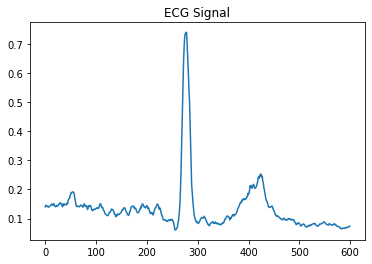


-------------------    Plot of Signal:   32    -------------------



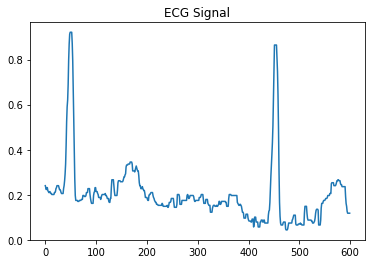

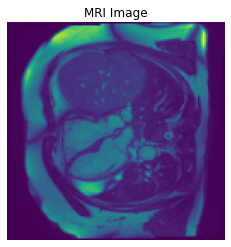

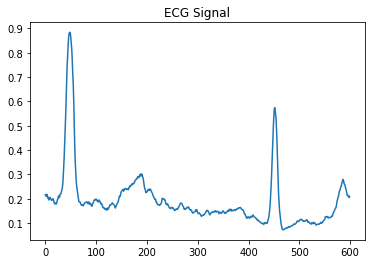


-------------------    Plot of Signal:   33    -------------------



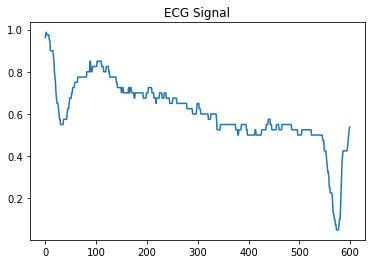

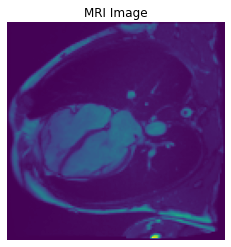

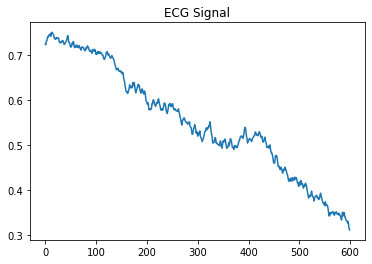


-------------------    Plot of Signal:   34    -------------------



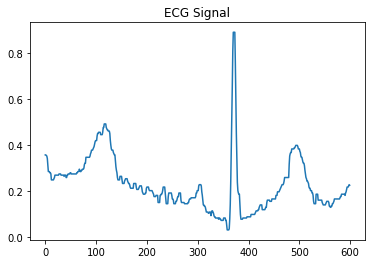

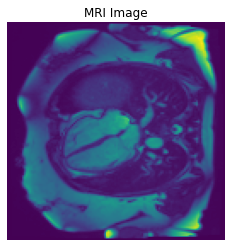

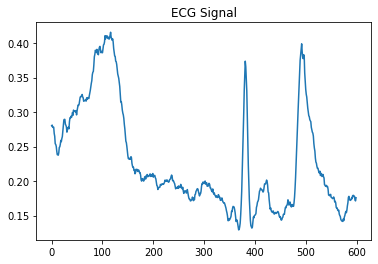


-------------------    Plot of Signal:   35    -------------------



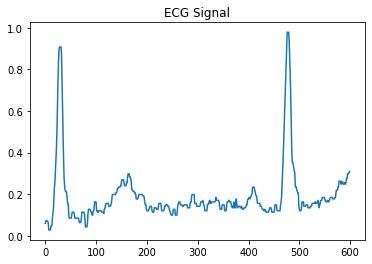

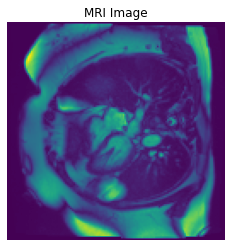

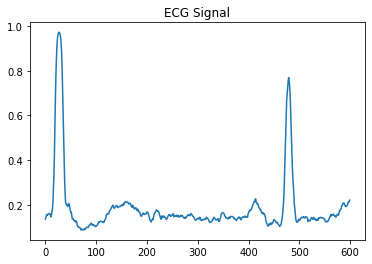


-------------------    Plot of Signal:   36    -------------------



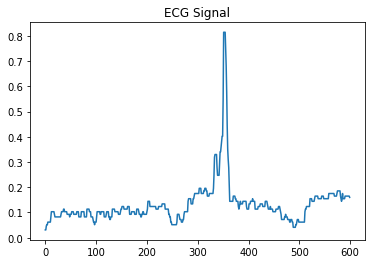

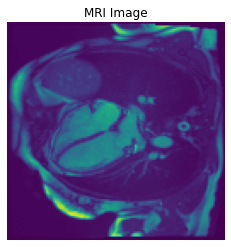

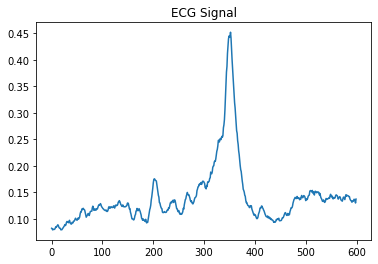


-------------------    Plot of Signal:   37    -------------------



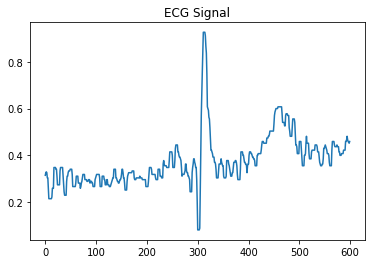

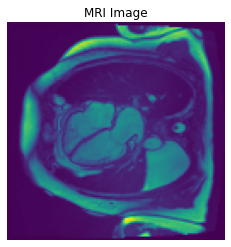

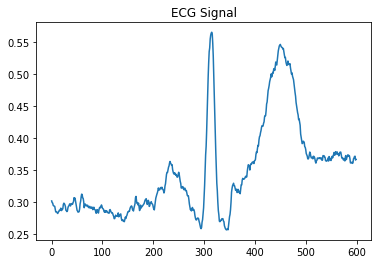


-------------------    Plot of Signal:   38    -------------------



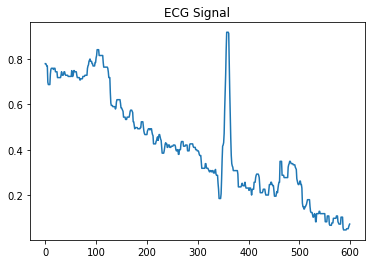

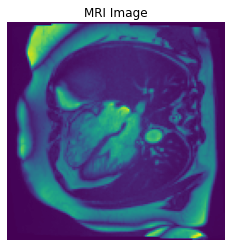

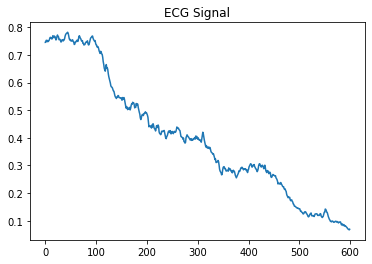


-------------------    Plot of Signal:   39    -------------------



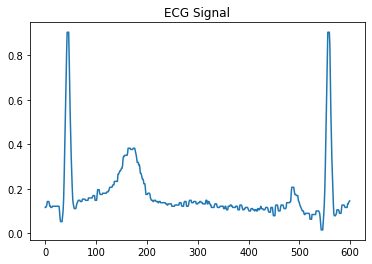

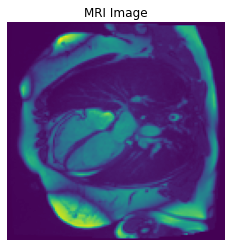

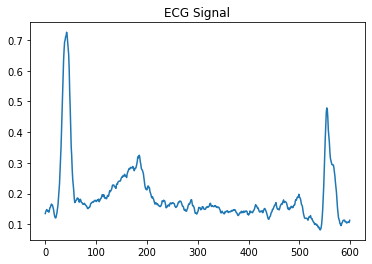


-------------------    Plot of Signal:   40    -------------------



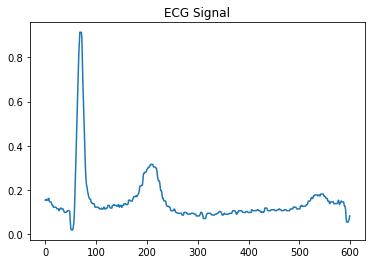

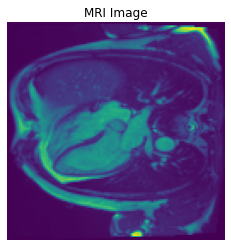

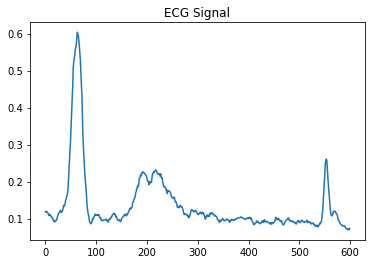


-------------------    Plot of Signal:   41    -------------------



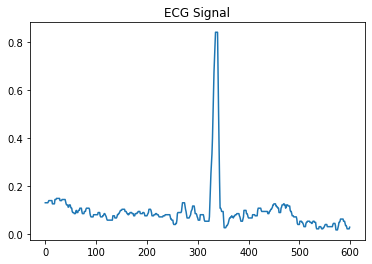

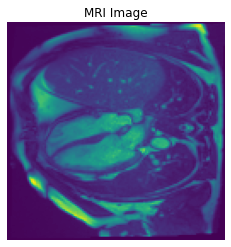

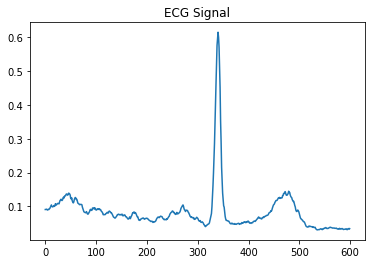


-------------------    Plot of Signal:   42    -------------------



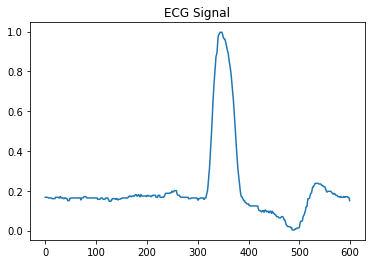

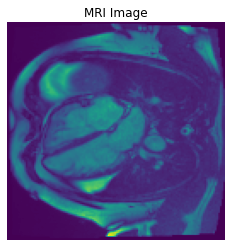

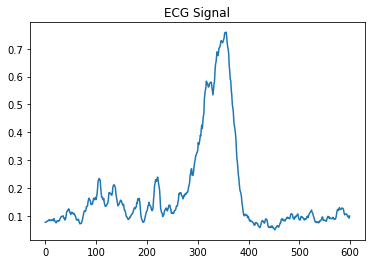


-------------------    Plot of Signal:   43    -------------------



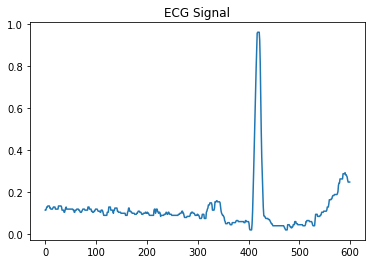

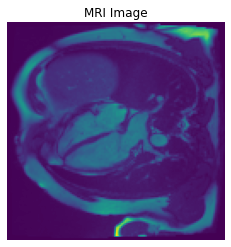

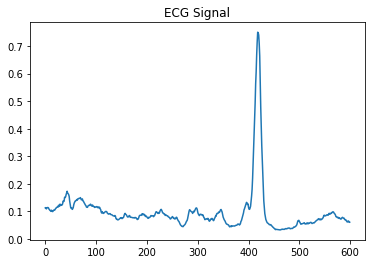


-------------------    Plot of Signal:   44    -------------------



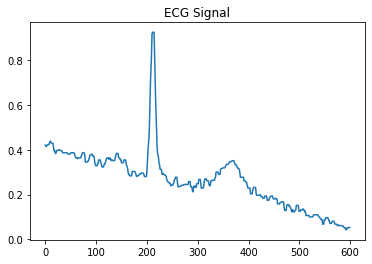

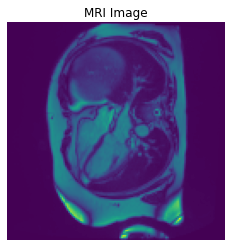

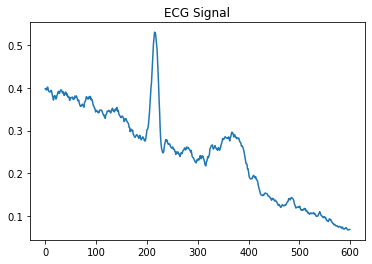


-------------------    Plot of Signal:   45    -------------------



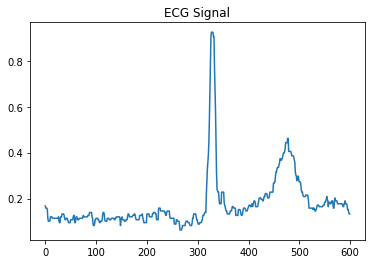

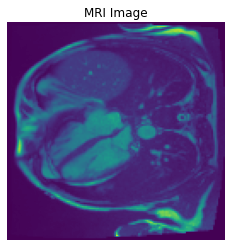

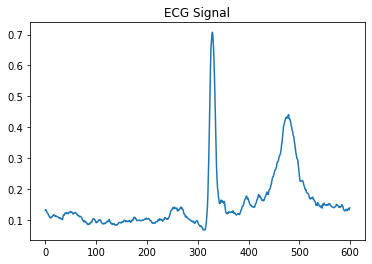


-------------------    Plot of Signal:   46    -------------------



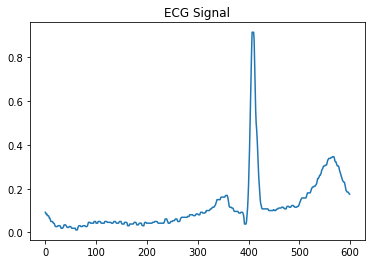

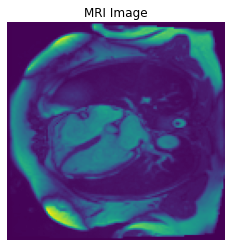

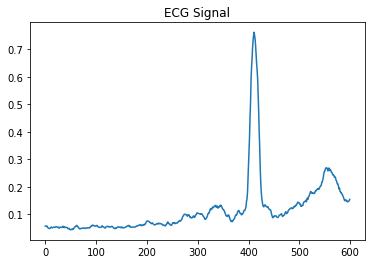


-------------------    Plot of Signal:   47    -------------------



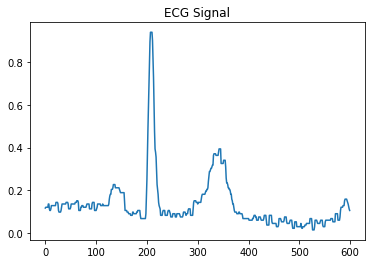

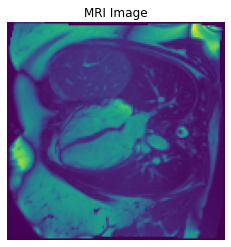

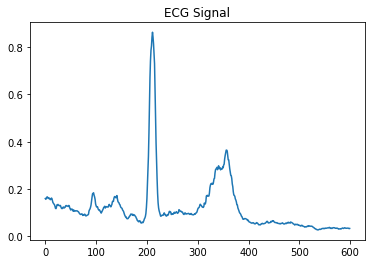


-------------------    Plot of Signal:   48    -------------------



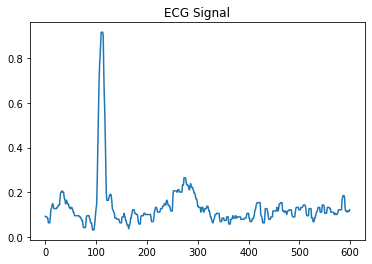

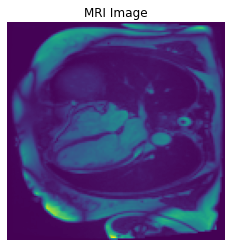

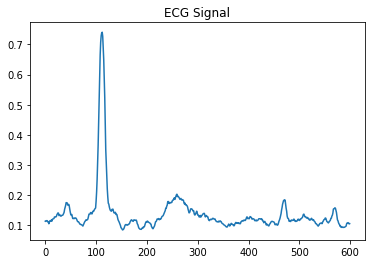


-------------------    Plot of Signal:   49    -------------------



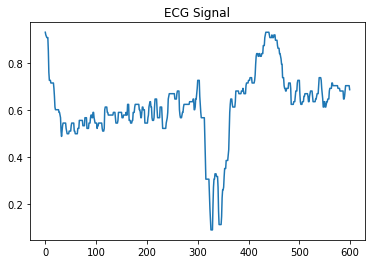

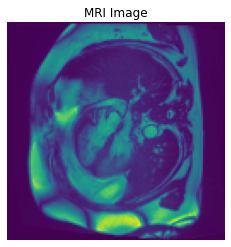

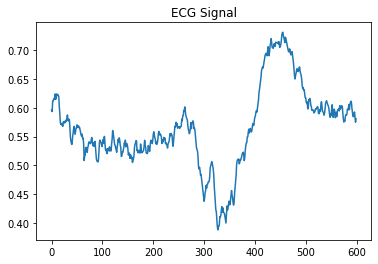


-------------------    Plot of Signal:   50    -------------------



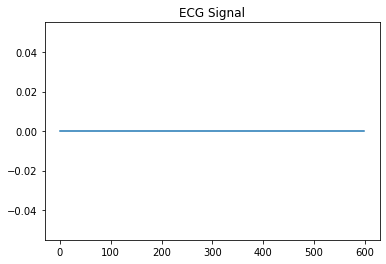

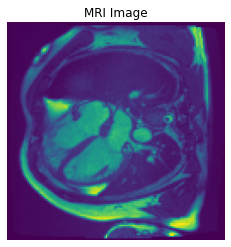

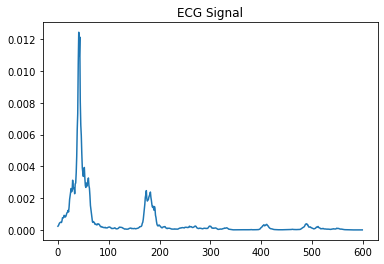


-------------------    Plot of Signal:   51    -------------------



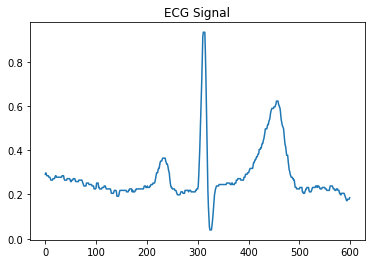

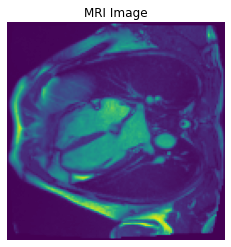

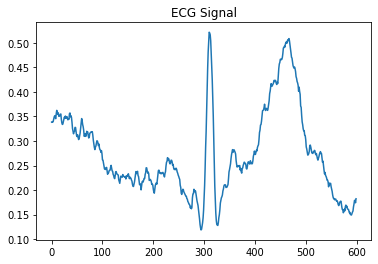


-------------------    Plot of Signal:   52    -------------------



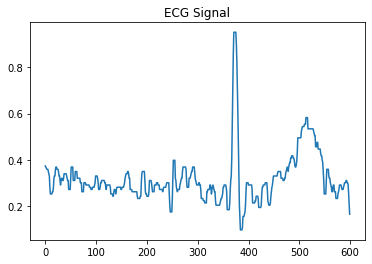

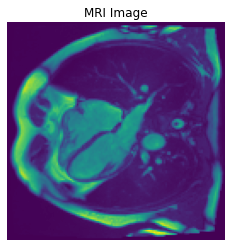

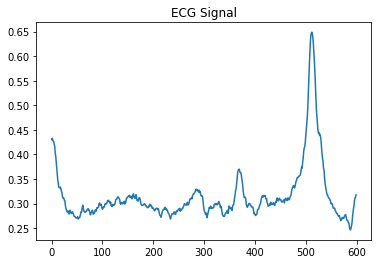


-------------------    Plot of Signal:   53    -------------------



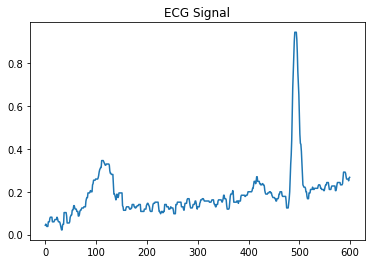

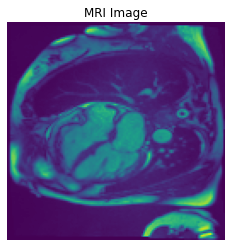

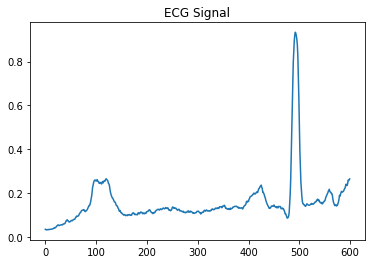


-------------------    Plot of Signal:   54    -------------------



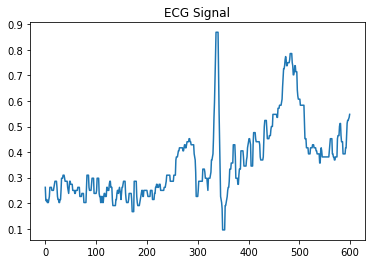

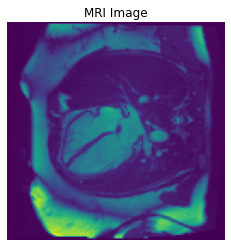

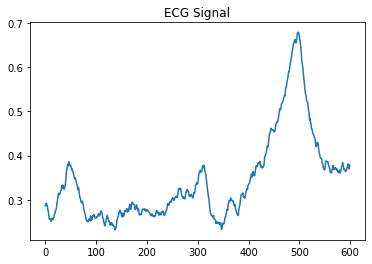


-------------------    Plot of Signal:   55    -------------------



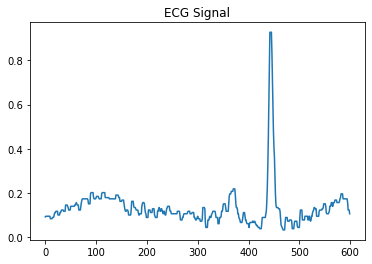

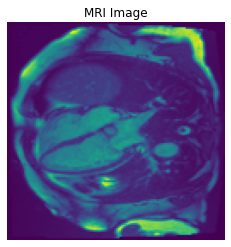

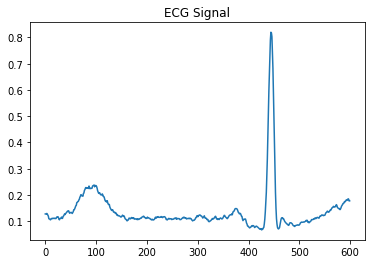


-------------------    Plot of Signal:   56    -------------------



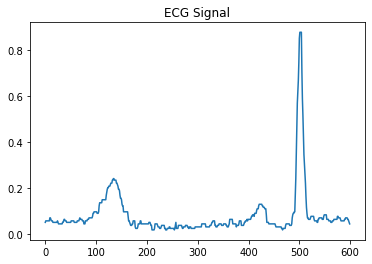

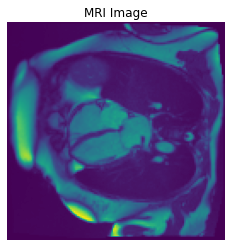

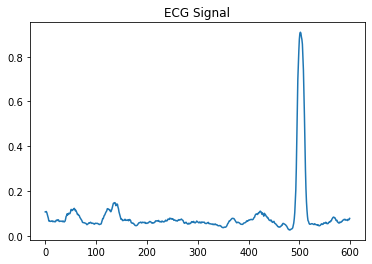


-------------------    Plot of Signal:   57    -------------------



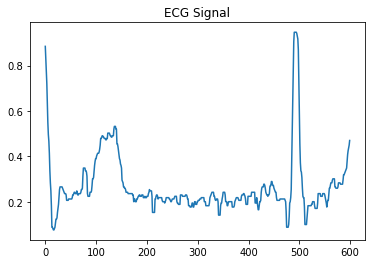

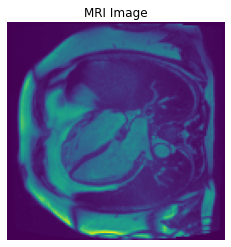

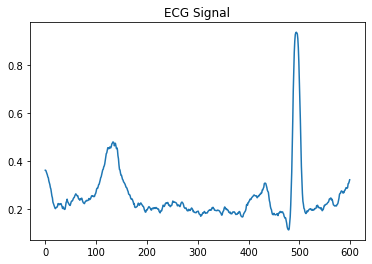


-------------------    Plot of Signal:   58    -------------------



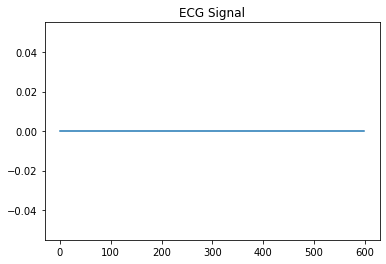

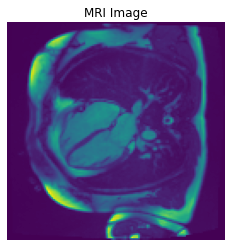

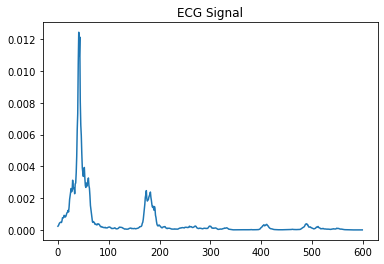


-------------------    Plot of Signal:   59    -------------------



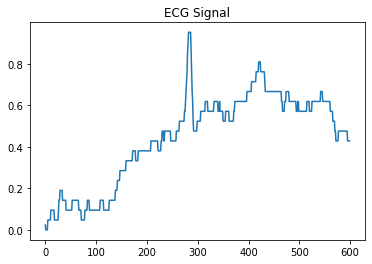

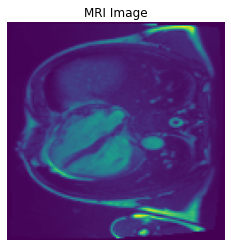

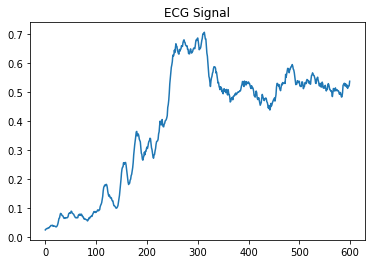


-------------------    Plot of Signal:   60    -------------------



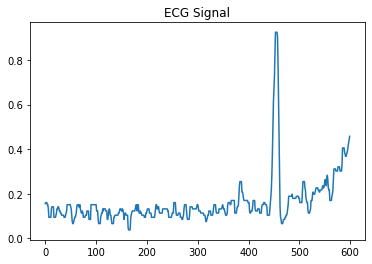

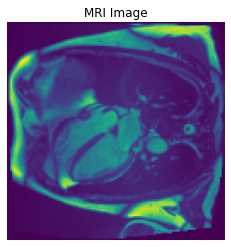

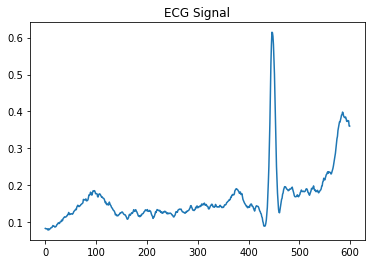


-------------------    Plot of Signal:   61    -------------------



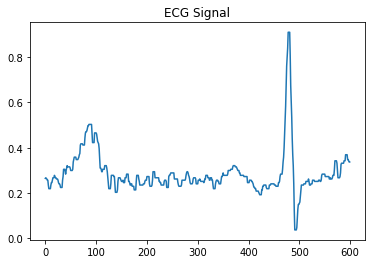

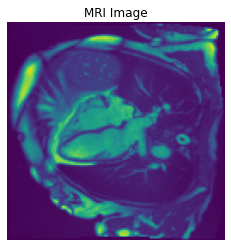

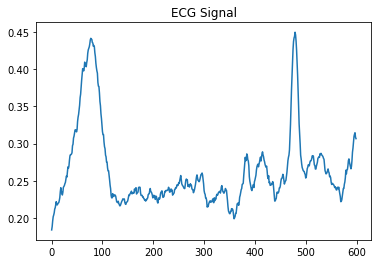


-------------------    Plot of Signal:   62    -------------------



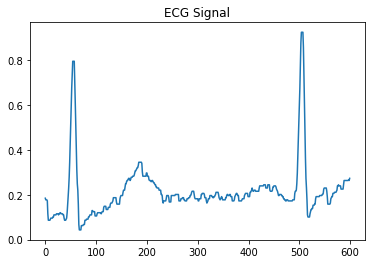

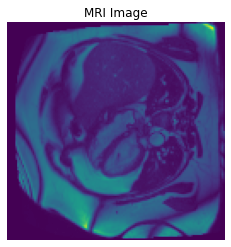

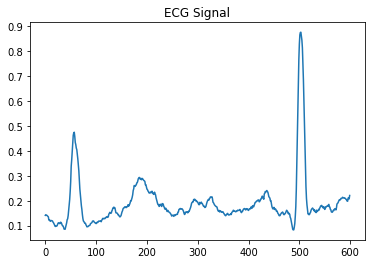


-------------------    Plot of Signal:   63    -------------------



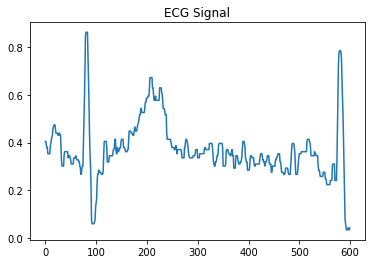

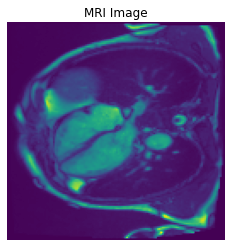

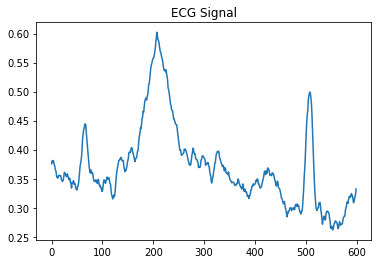


-------------------    Plot of Signal:   0    -------------------



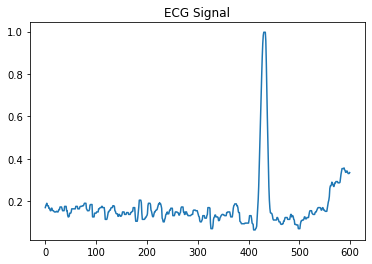

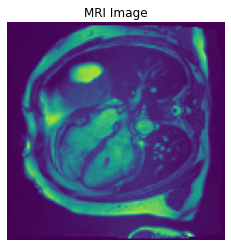

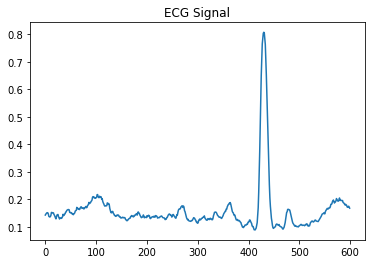


-------------------    Plot of Signal:   1    -------------------



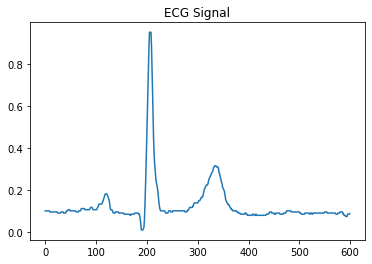

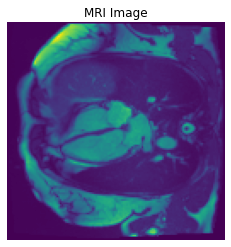

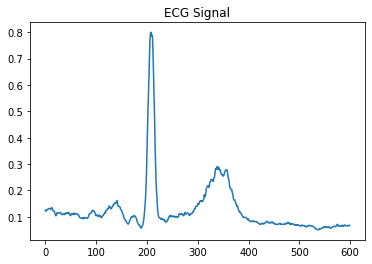


-------------------    Plot of Signal:   2    -------------------



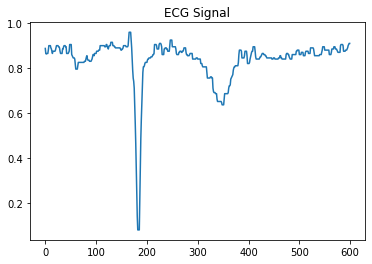

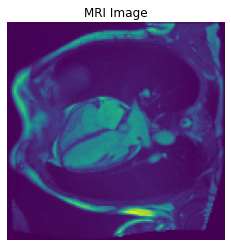

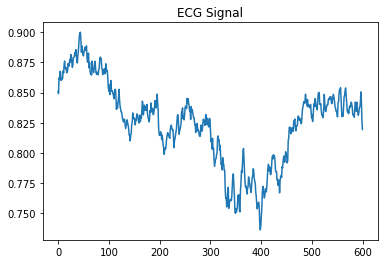


-------------------    Plot of Signal:   3    -------------------



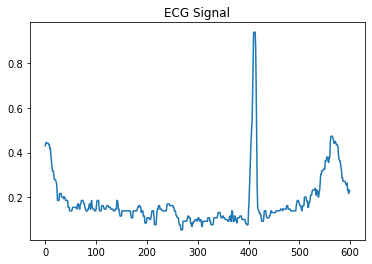

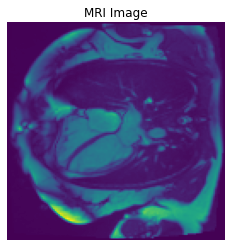

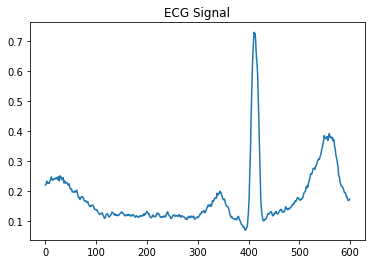


-------------------    Plot of Signal:   4    -------------------



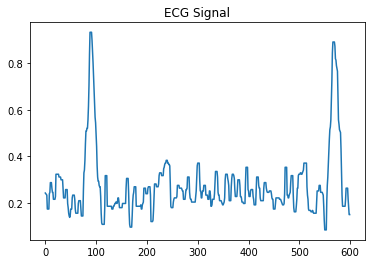

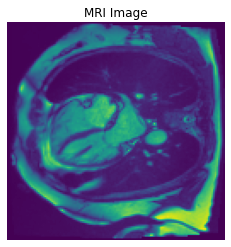

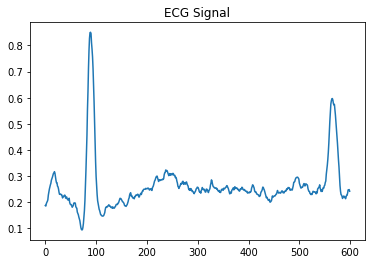


-------------------    Plot of Signal:   5    -------------------



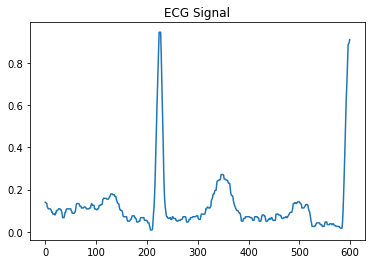

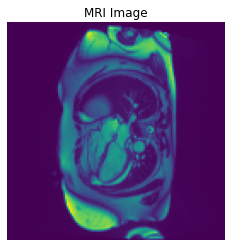

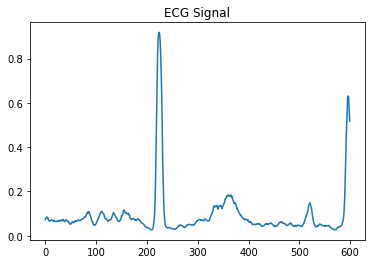


-------------------    Plot of Signal:   6    -------------------



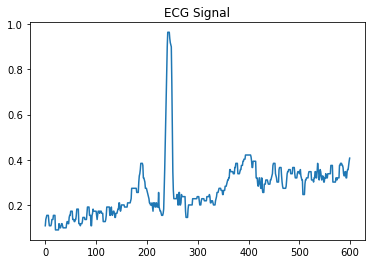

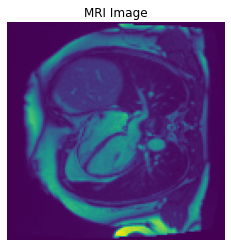

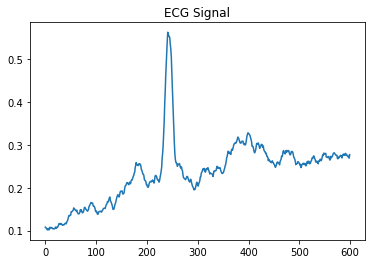


-------------------    Plot of Signal:   7    -------------------



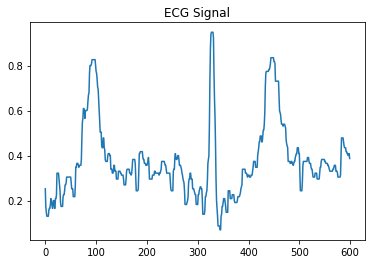

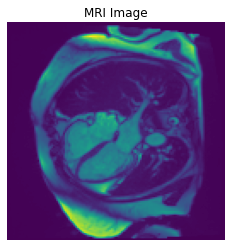

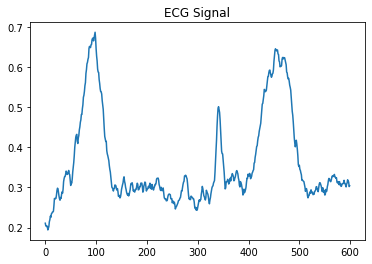


-------------------    Plot of Signal:   8    -------------------



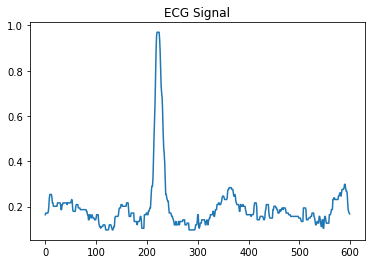

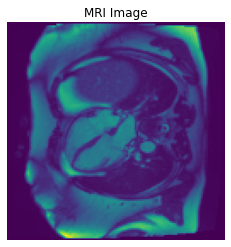

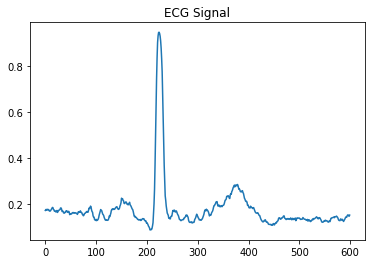


-------------------    Plot of Signal:   9    -------------------



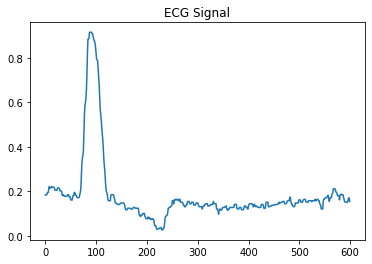

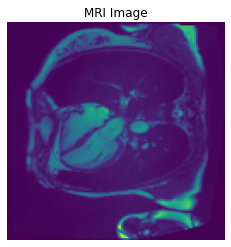

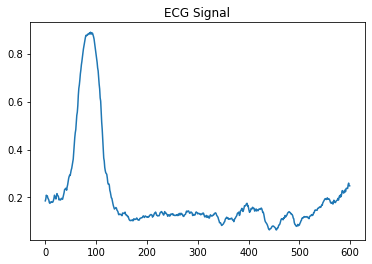


-------------------    Plot of Signal:   10    -------------------



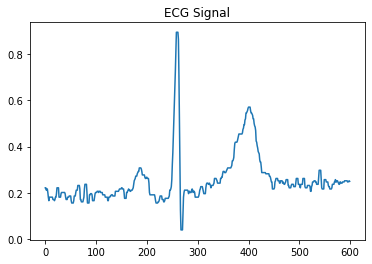

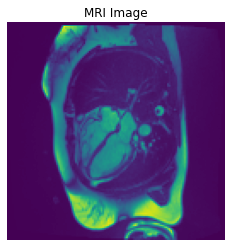

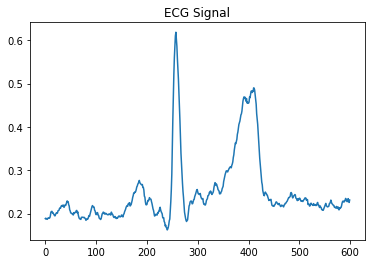


-------------------    Plot of Signal:   11    -------------------



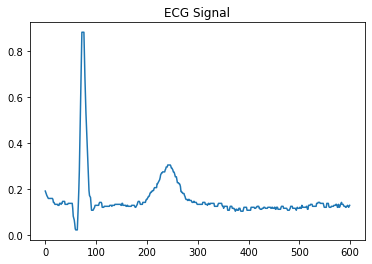

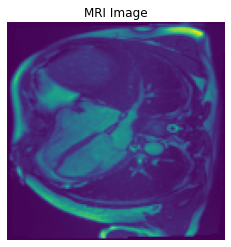

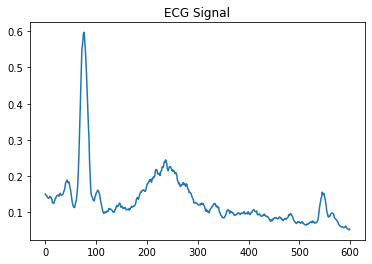


-------------------    Plot of Signal:   12    -------------------



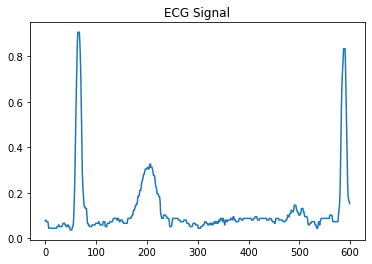

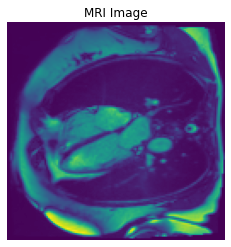

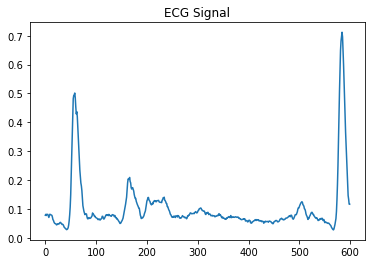


-------------------    Plot of Signal:   13    -------------------



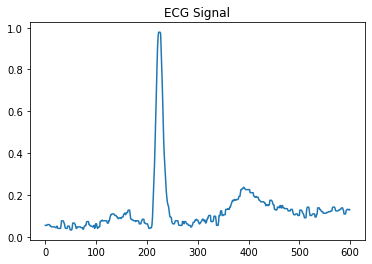

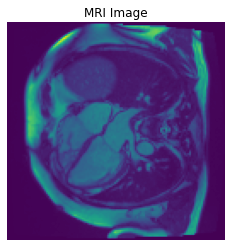

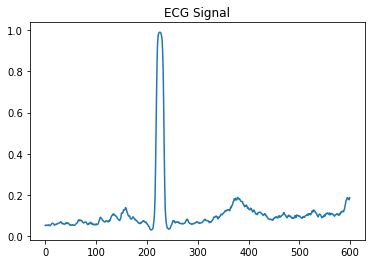


-------------------    Plot of Signal:   14    -------------------



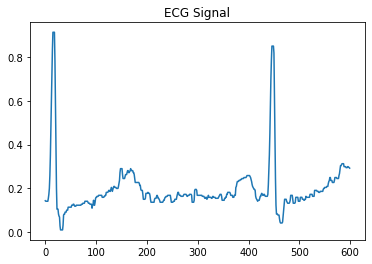

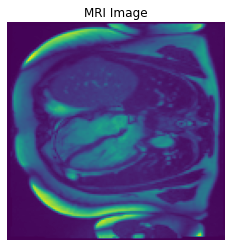

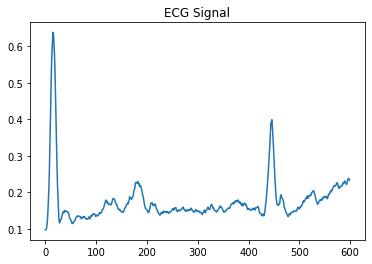


-------------------    Plot of Signal:   15    -------------------



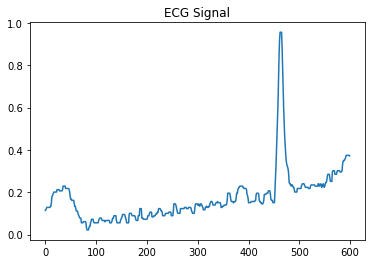

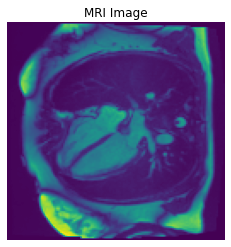

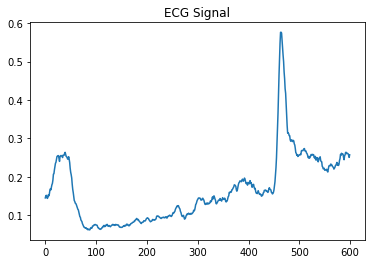


-------------------    Plot of Signal:   16    -------------------



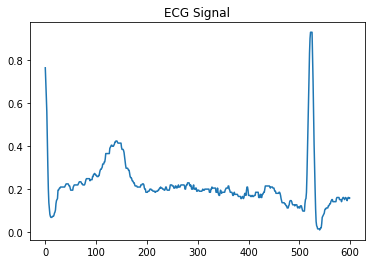

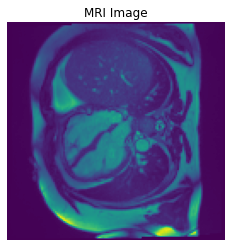

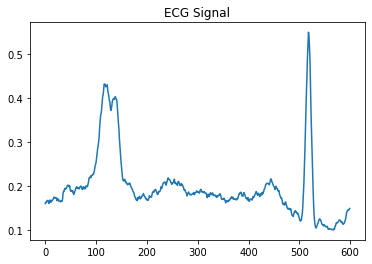


-------------------    Plot of Signal:   17    -------------------



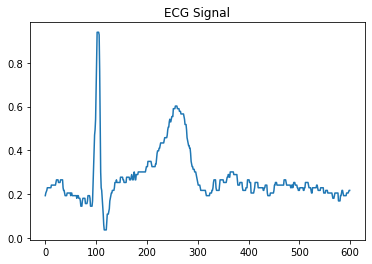

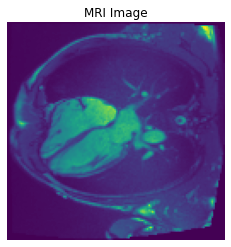

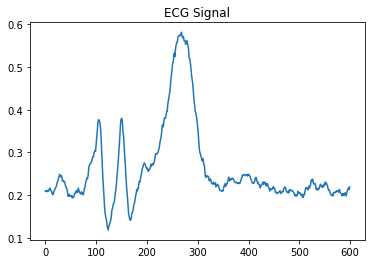


-------------------    Plot of Signal:   18    -------------------



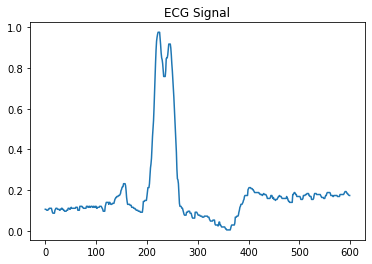

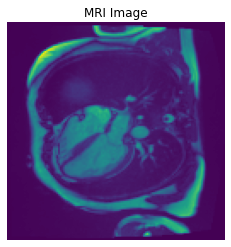

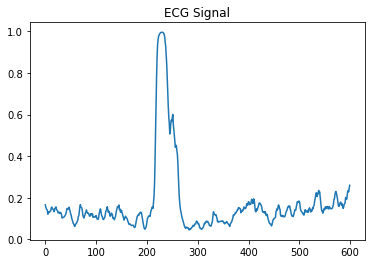


-------------------    Plot of Signal:   19    -------------------



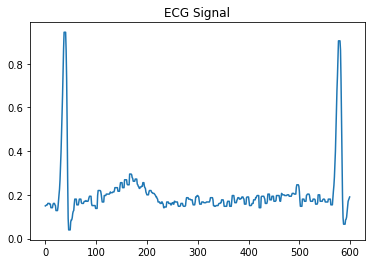

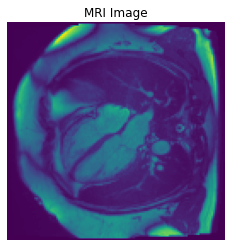

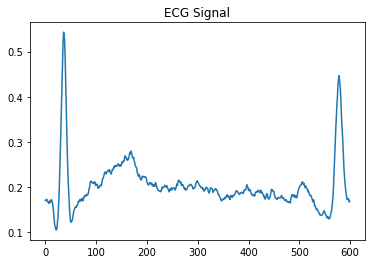


-------------------    Plot of Signal:   20    -------------------



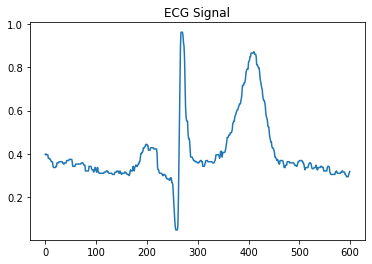

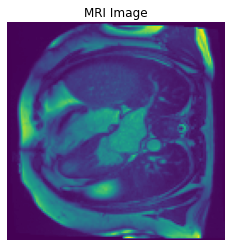

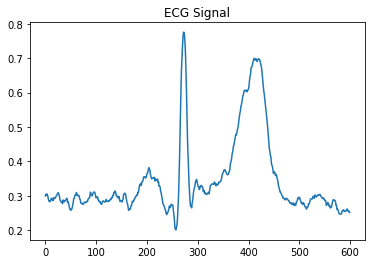


-------------------    Plot of Signal:   21    -------------------



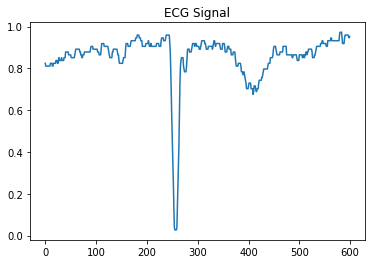

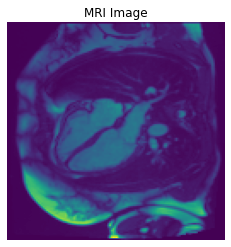

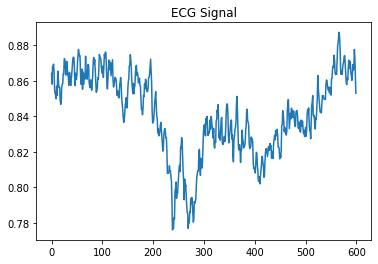


-------------------    Plot of Signal:   22    -------------------



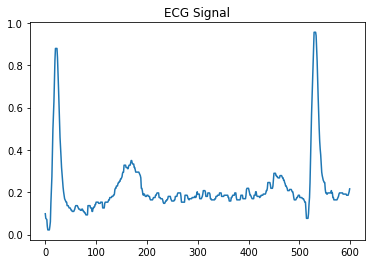

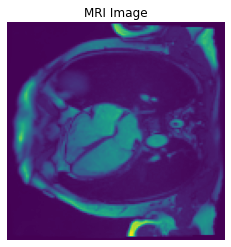

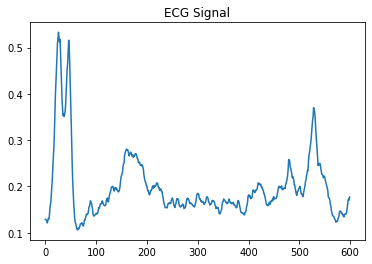


-------------------    Plot of Signal:   23    -------------------



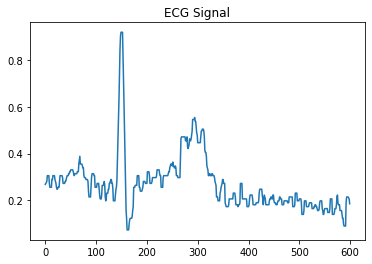

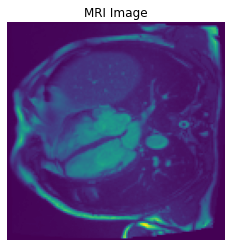

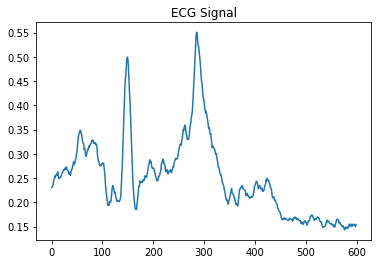


-------------------    Plot of Signal:   24    -------------------



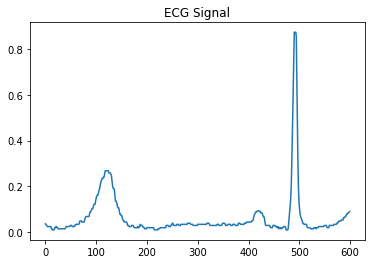

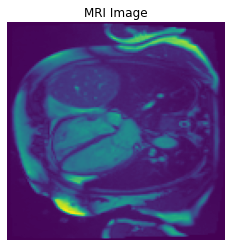

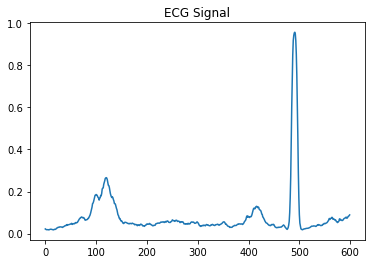


-------------------    Plot of Signal:   25    -------------------



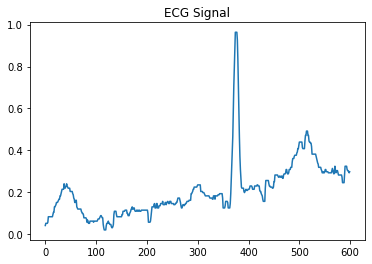

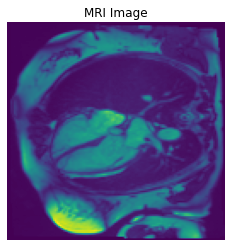

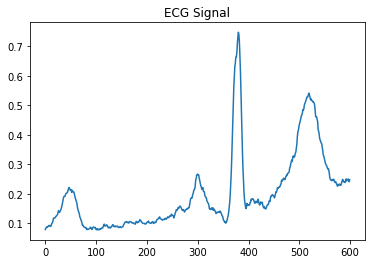


-------------------    Plot of Signal:   26    -------------------



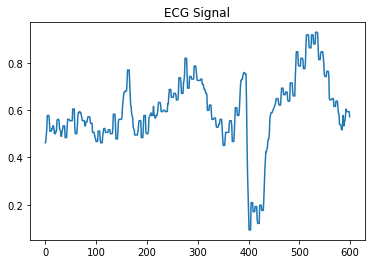

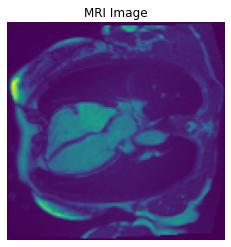

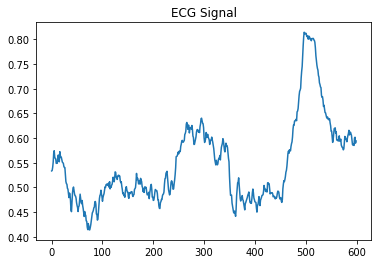


-------------------    Plot of Signal:   27    -------------------



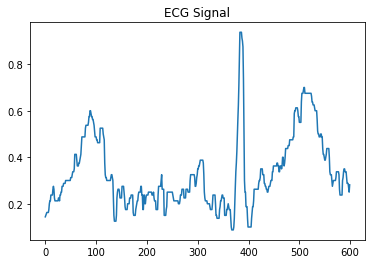

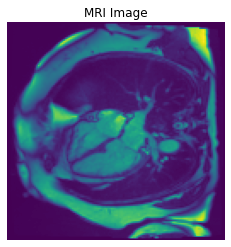

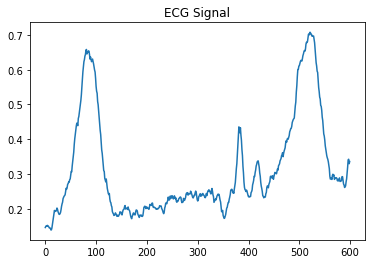


-------------------    Plot of Signal:   28    -------------------



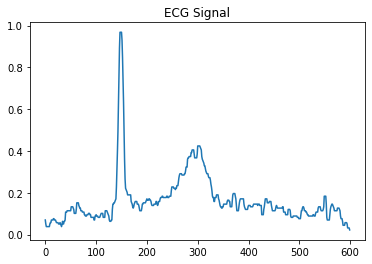

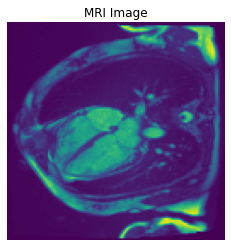

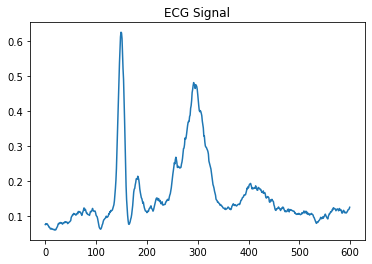


-------------------    Plot of Signal:   29    -------------------



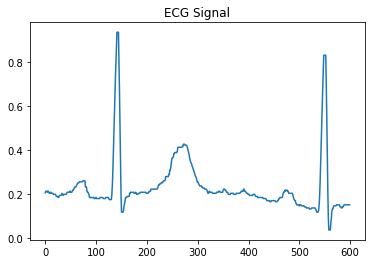

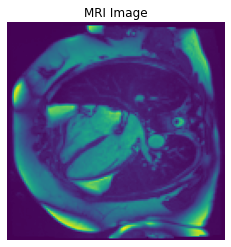

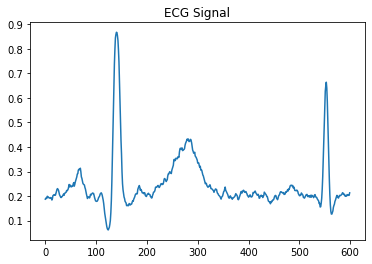


-------------------    Plot of Signal:   30    -------------------



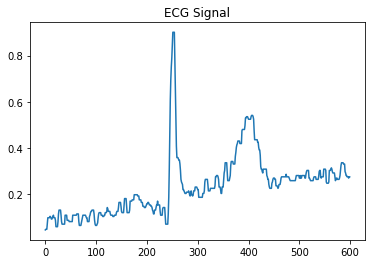

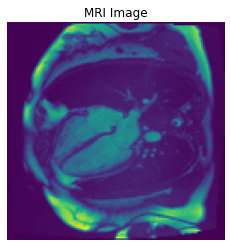

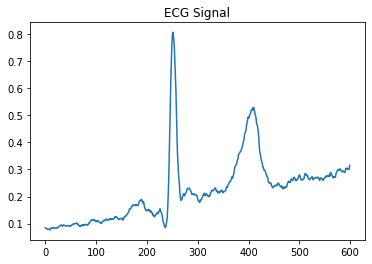


-------------------    Plot of Signal:   31    -------------------



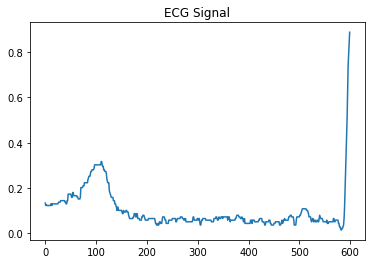

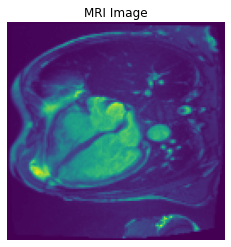

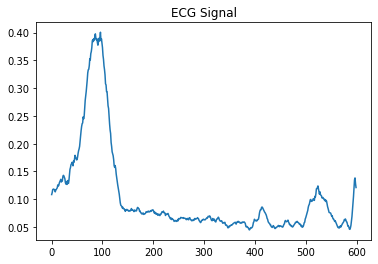


-------------------    Plot of Signal:   32    -------------------



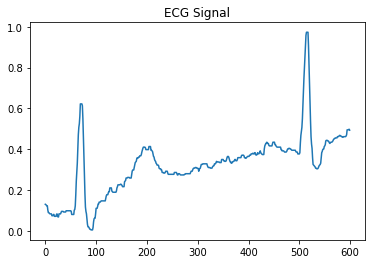

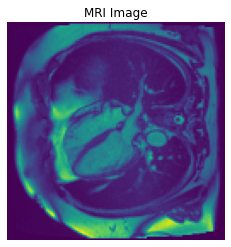

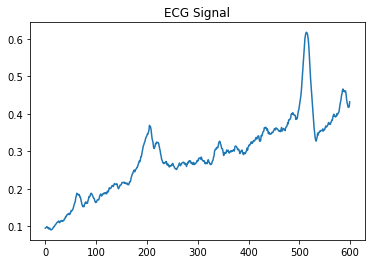


-------------------    Plot of Signal:   33    -------------------



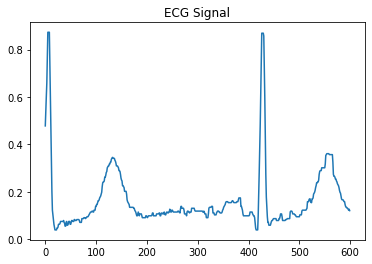

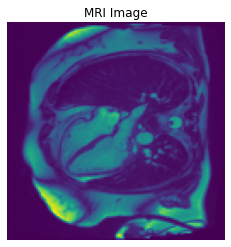

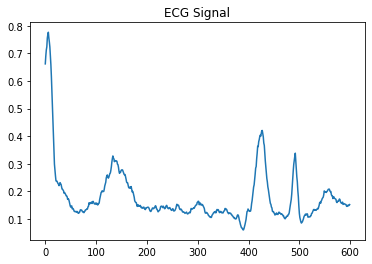


-------------------    Plot of Signal:   34    -------------------



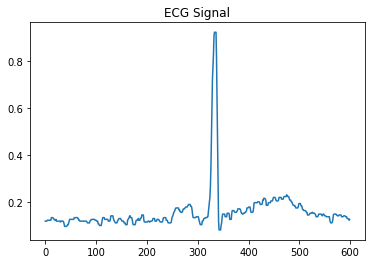

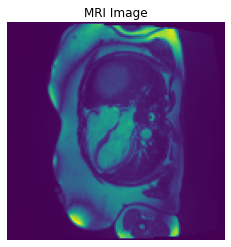

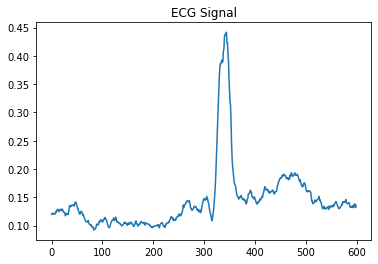


-------------------    Plot of Signal:   35    -------------------



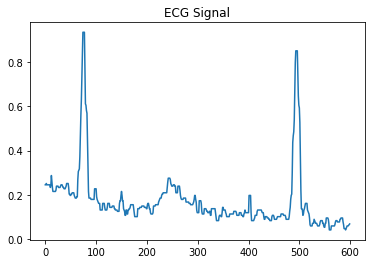

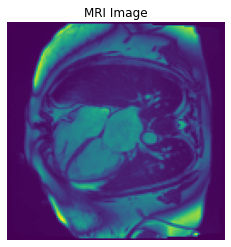

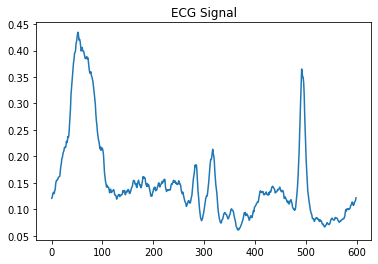


-------------------    Plot of Signal:   36    -------------------



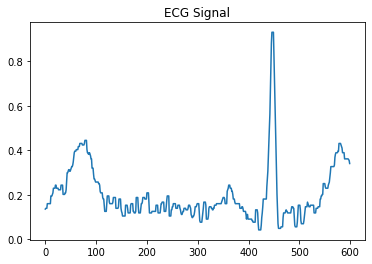

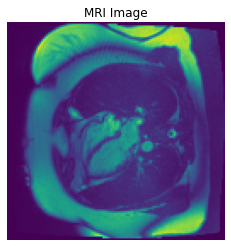

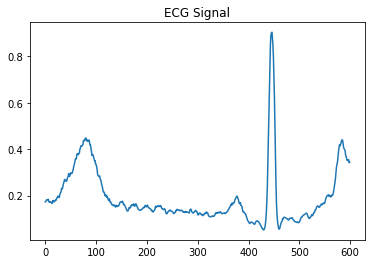


-------------------    Plot of Signal:   37    -------------------



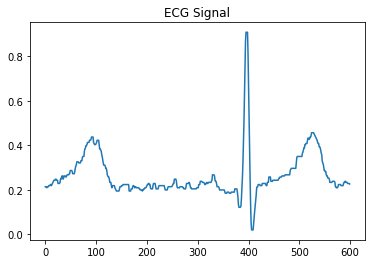

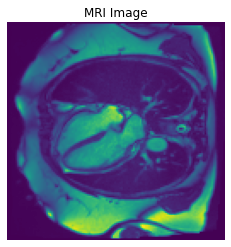

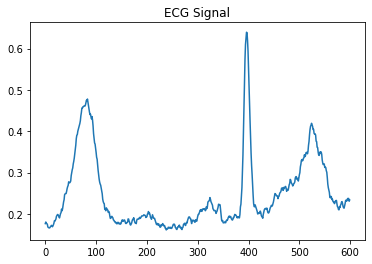


-------------------    Plot of Signal:   38    -------------------



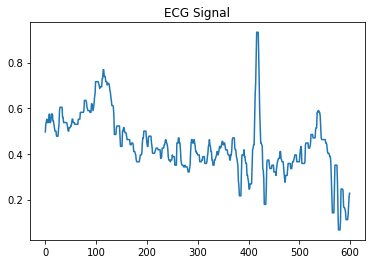

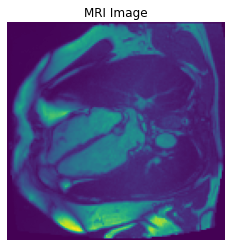

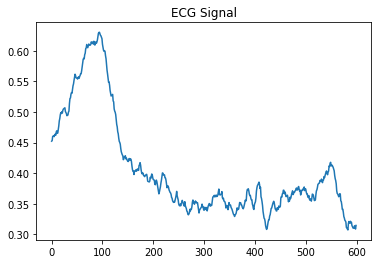


-------------------    Plot of Signal:   39    -------------------



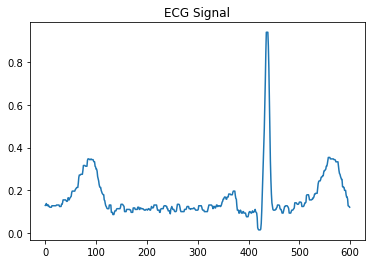

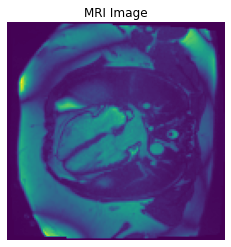

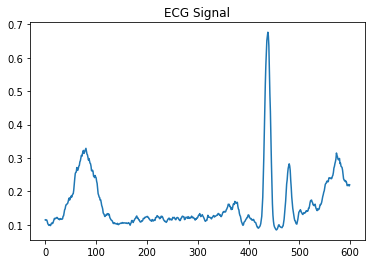


-------------------    Plot of Signal:   40    -------------------



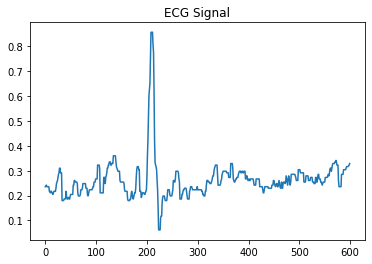

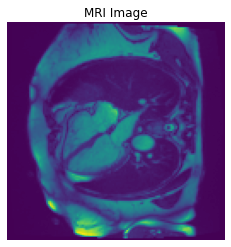

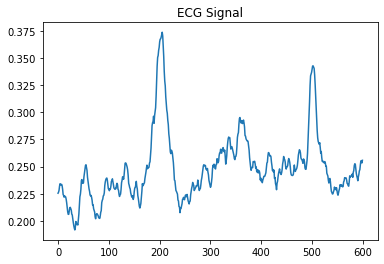


-------------------    Plot of Signal:   41    -------------------



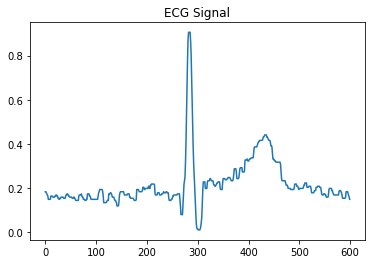

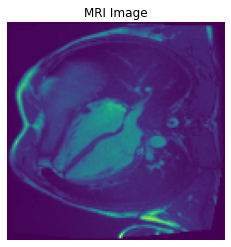

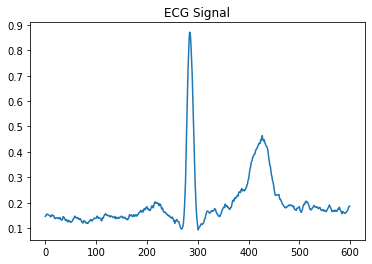


-------------------    Plot of Signal:   42    -------------------



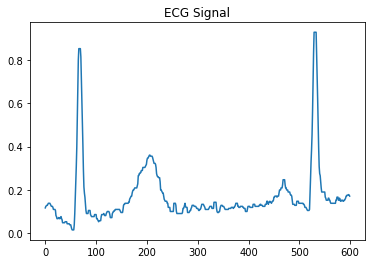

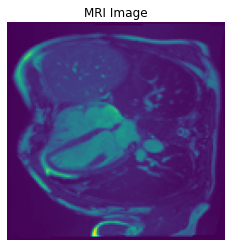

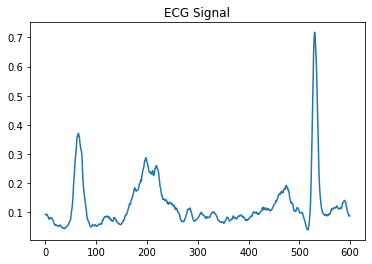


-------------------    Plot of Signal:   43    -------------------



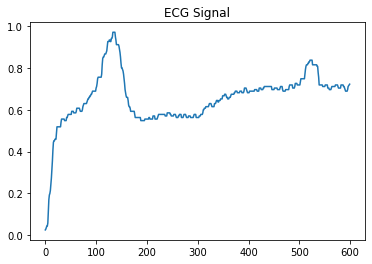

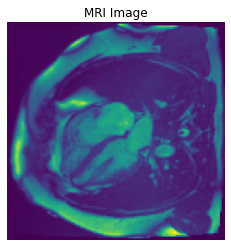

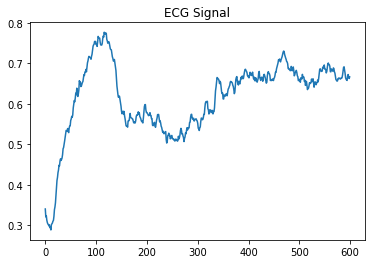


-------------------    Plot of Signal:   44    -------------------



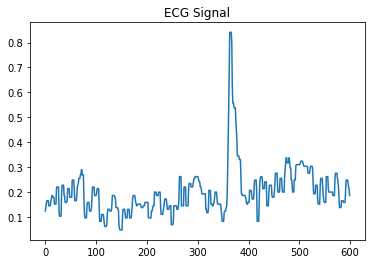

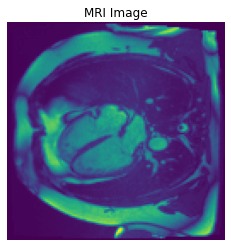

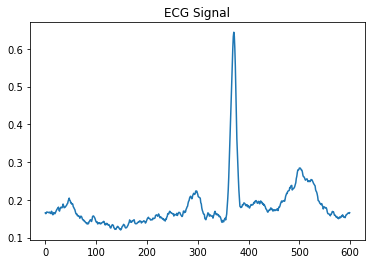


-------------------    Plot of Signal:   45    -------------------



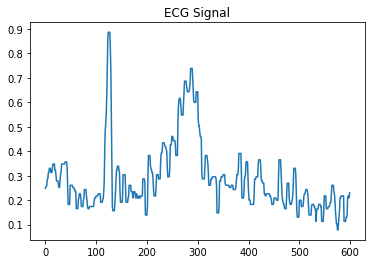

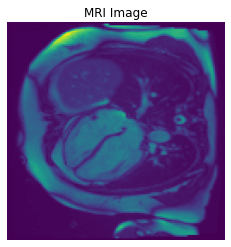

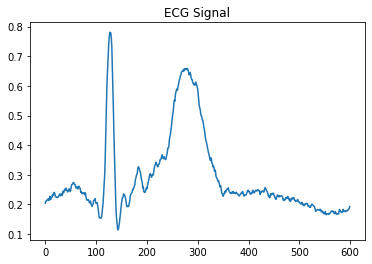


-------------------    Plot of Signal:   46    -------------------



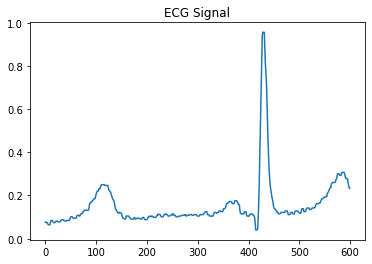

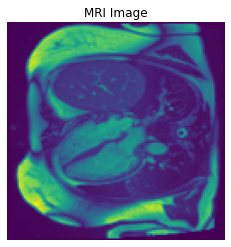

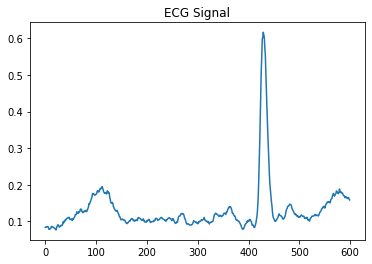


-------------------    Plot of Signal:   47    -------------------



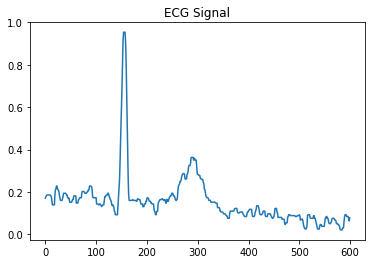

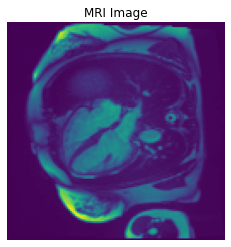

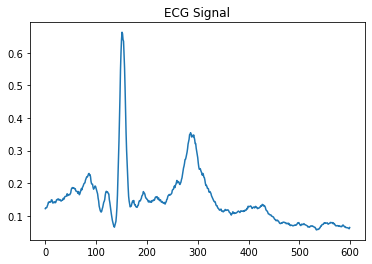


-------------------    Plot of Signal:   48    -------------------



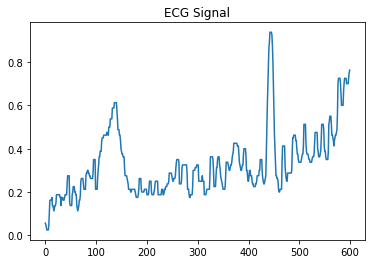

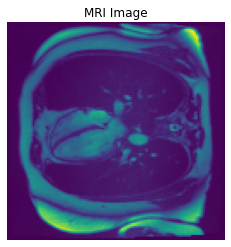

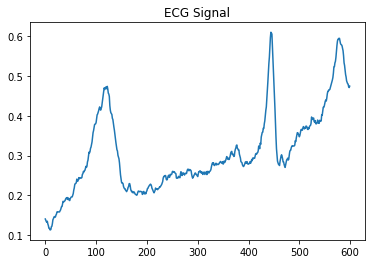


-------------------    Plot of Signal:   49    -------------------



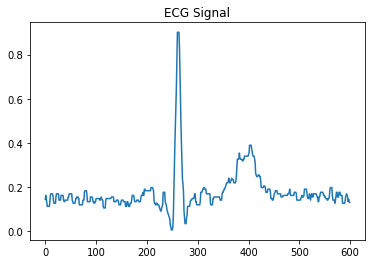

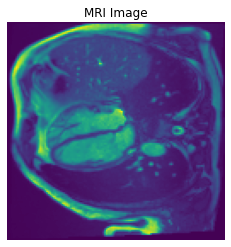

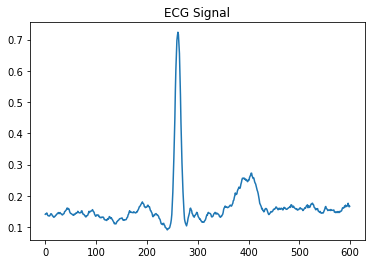


-------------------    Plot of Signal:   50    -------------------



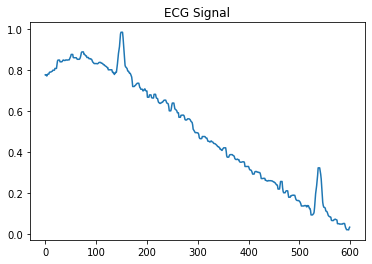

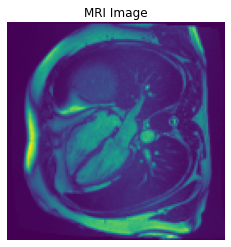

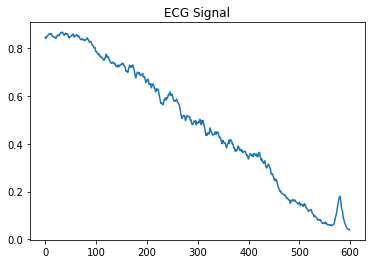


-------------------    Plot of Signal:   51    -------------------



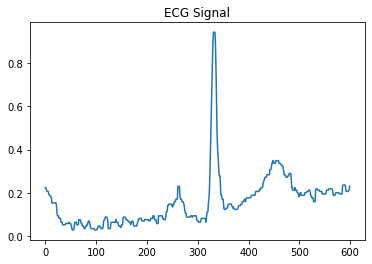

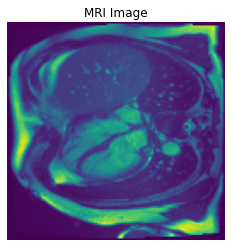

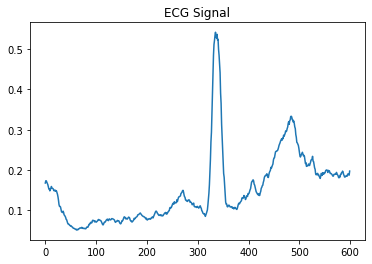


-------------------    Plot of Signal:   52    -------------------



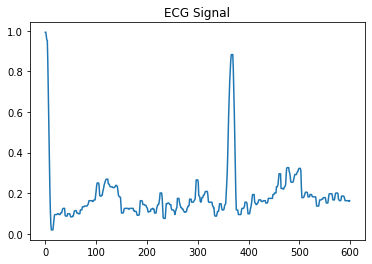

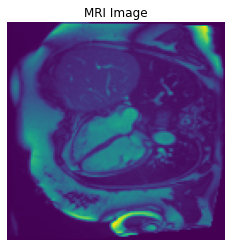

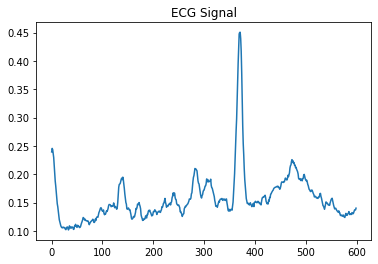


-------------------    Plot of Signal:   53    -------------------



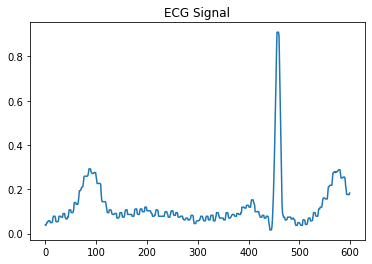

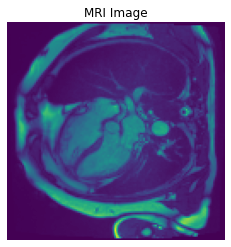

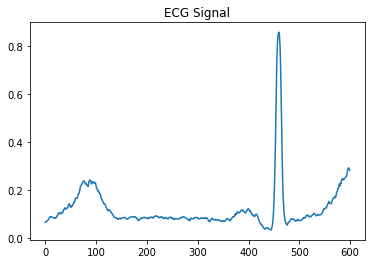


-------------------    Plot of Signal:   54    -------------------



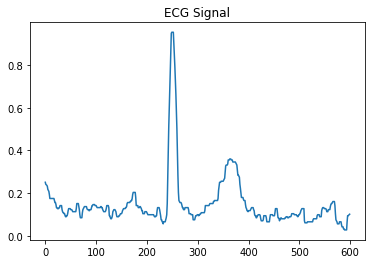

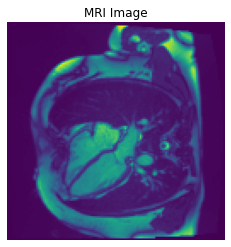

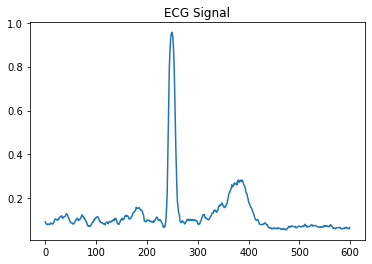


-------------------    Plot of Signal:   55    -------------------



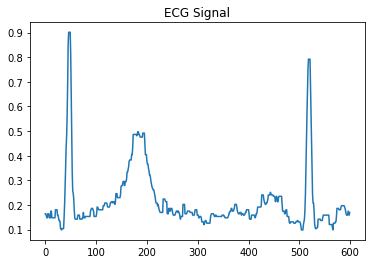

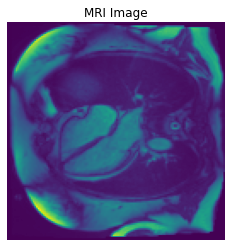

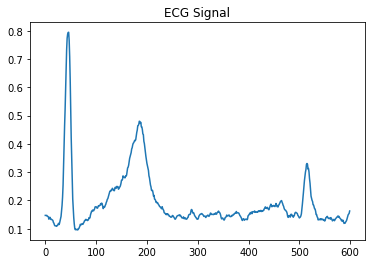


-------------------    Plot of Signal:   56    -------------------



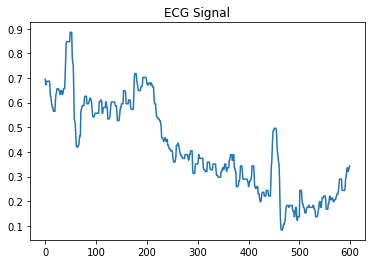

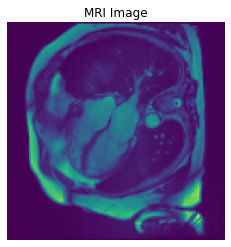

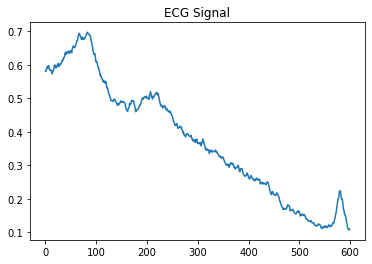


-------------------    Plot of Signal:   57    -------------------



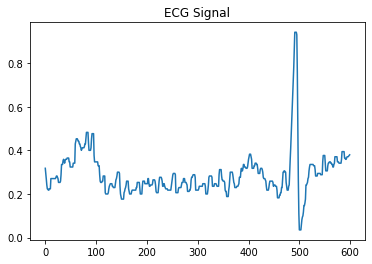

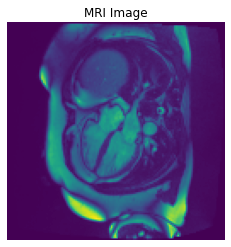

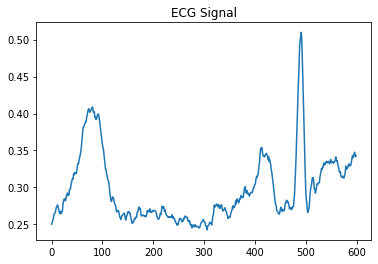


-------------------    Plot of Signal:   58    -------------------



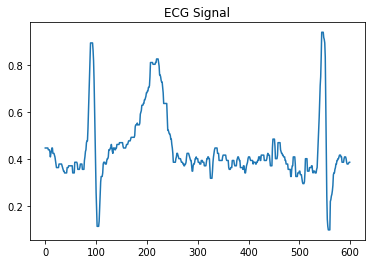

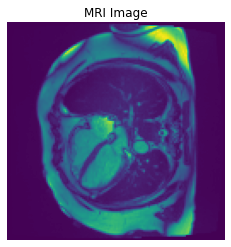

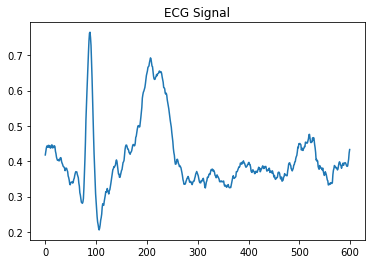


-------------------    Plot of Signal:   59    -------------------



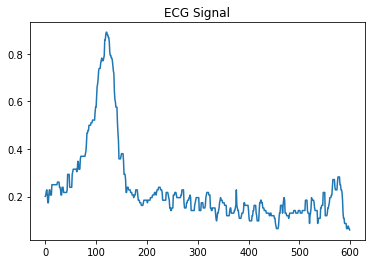

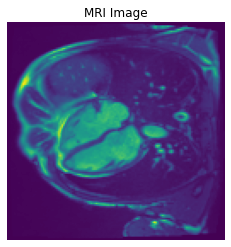

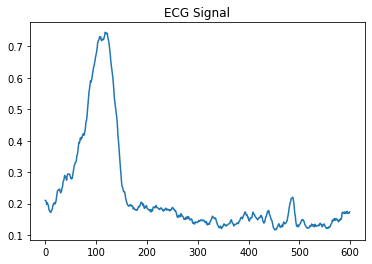


-------------------    Plot of Signal:   60    -------------------



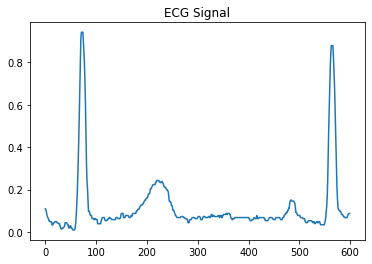

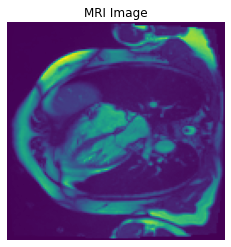

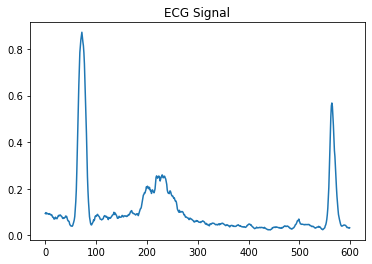


-------------------    Plot of Signal:   61    -------------------



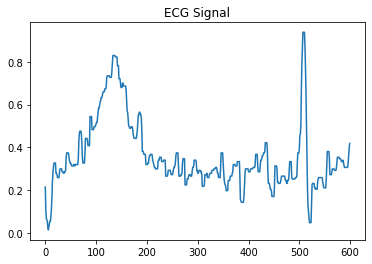

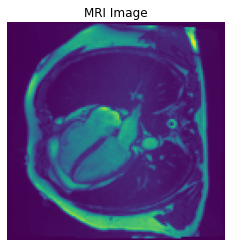

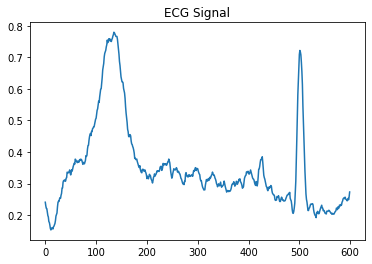


-------------------    Plot of Signal:   62    -------------------



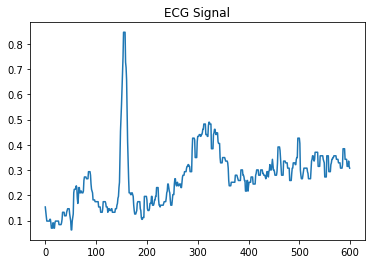

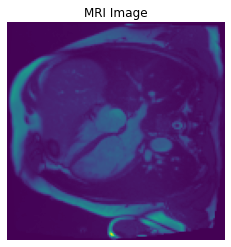

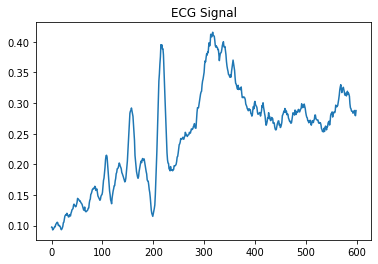


-------------------    Plot of Signal:   63    -------------------



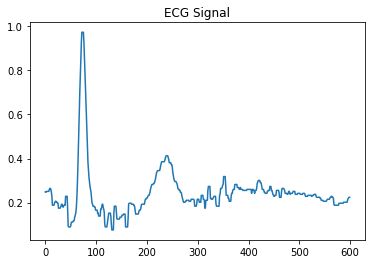

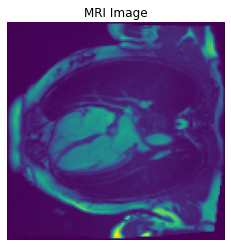

KeyboardInterrupt: 

In [49]:
for output in outputs:
    ecg_signal, mri_image, reconstructed_mri = output
    
    for i in range(len(ecg_signal)):
        
        print("")
        print("-------------------    Plot of Signal:  ", i,"   -------------------\n")
        
        plt.figure()
        plt.plot(ecg_signal[i].cpu().numpy())
        plt.title('ECG Signal')
        
        plt.figure()
        mri = mri_image[i].reshape(128, 128)
        plt.imshow(mri.cpu().detach().numpy())
        plt.title('MRI Image')
        plt.axis('off')
        
        plt.figure()
        rec_mri = reconstructed_mri[i].reshape(128, 128)
        plt.imshow(rec_mri.cpu().detach().numpy())
        plt.title('Reconstructed MRI Image')
        plt.axis('off') 
        
        plt.show()

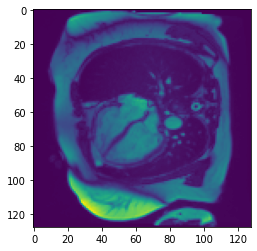

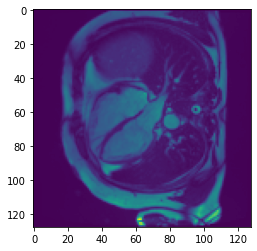

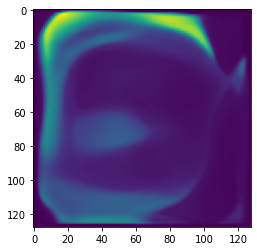

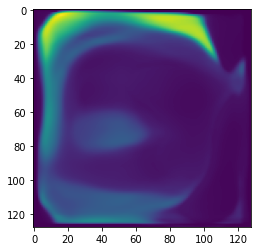

In [56]:
# Plotting some sample images
for i, item in enumerate(mri_image):
    # Reshape the array for plotting
    item = item.reshape(128, 128)
    plt.imshow(item.cpu().detach().numpy())
    plt.show()
    if i == 2:
        break

for i, item in enumerate(reconstructed_mri):
    item = item.reshape(128, 128)
    plt.imshow(item.cpu().detach().numpy())
    plt.show()
    if i == 2:
        break

### Free CUDA Memory

In [57]:
# model.cpu()
# del model
# gc.collect()
# torch.cuda.empty_cache()